# Assessing accuracy performance with OpenAI API calls

In [27]:
import os
os.environ["OPENAI_API_KEY"] = ""

In [134]:
import pandas as pd

In [135]:
from langchain.llms import OpenAI
from langchain.chains import ConversationChain
from langchain.memory import ConversationBufferMemory
from langchain_openai import ChatOpenAI

In [136]:
api_key=''

In [137]:
counterfactual_questions = [

"I want now to teach you how to perform causal reasoning when it comes to solving chemistry problem. ",
"First, ask yourself these questions on the few-shot example provided to you.",
"This will help you understand the causal relationship between variable and deepen you understanding of the dataset. ",
"Aromatic Groups: If the ditopic species had aromatic groups, matching the tritopic species, would this lead to a more turbid or dissolved?", 
"Hydrogen Bond Acceptors and Donors: If both species had an equal number of hydrogen bond donors and acceptors,  would the mixture likely be more dissolved or more turbid?", 
"LogP (Octanol/Water Partition Coefficient): If both species had similar LogP values (e.g., both being more hydrophobic or hydrophilic), would be mixture be more dissolved or turbid",
"TPSA (Topological Polar Surface Area): If the TPSA values for both species were either higher or lower, would the mixture be more turbid or dissolved?",
"From now on, answer the next questions by asking these counterfactual questions in your thought process. "

]

In [138]:
data_all = pd.read_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/all_dataset_turbidity.csv')

In [139]:
data_all.columns

Index(['Unnamed: 0', 'di_name', 'tri_name', 'di_smiles', 'tri_smiles',
       'turbidity_label', 'turbidity', 'turbidity_binary', 'di_charge',
       'di_complexity', 'di_covalent_unit_count',
       'di_defined_atom_stereo_count', 'di_defined_bond_stereo_count',
       'di_exact_mass', 'di_h_bond_acceptor_count', 'di_h_bond_donor_count',
       'di_heavy_atom_count', 'di_xlogp', 'di_molecular_weight',
       'di_rotatable_bond_count', 'di_tpsa', 'tri_charge', 'tri_complexity',
       'tri_covalent_unit_count', 'tri_defined_atom_stereo_count',
       'tri_defined_bond_stereo_count', 'tri_exact_mass',
       'tri_h_bond_acceptor_count', 'tri_h_bond_donor_count',
       'tri_heavy_atom_count', 'tri_xlogp', 'tri_molecular_weight',
       'tri_rotatable_bond_count', 'tri_tpsa', 'di_arom_group',
       'tri_arom_group'],
      dtype='object')

In [140]:
def load_and_filter_df_cleanned(df):
    
    required_columns = [
        'turbidity_binary', 'di_smiles', 'tri_smiles', 'di_h_bond_donor_count', 'di_arom_group', 'di_complexity',
        'di_xlogp', 'tri_h_bond_donor_count', 'tri_xlogp', 'tri_complexity', 'tri_heavy_atom_count',
        'tri_exact_mass', 'tri_molecular_weight', 'tri_arom_group', 'di_rotatable_bond_count', 'tri_rotatable_bond_count', 
        'di_heavy_atom_count', 'di_molecular_weight', 'di_exact_mass', 'tri_tpsa', 'di_tpsa', 'di_h_bond_acceptor_count',
        'di_defined_atom_stereo_count', 'tri_defined_bond_stereo_count', 'tri_h_bond_acceptor_count'
        ]
    
    available_columns = [col for col in required_columns if col in df.columns]
    
    if not available_columns:
        print("None of the required columns are available in the Excel file.")
        return None

    
    filtered_df = df[available_columns]

    filtered_df.fillna('unknown', inplace=True)

    return filtered_df


In [141]:
data_all = load_and_filter_df_cleanned(data_all)

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_85193/2895454578.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df.fillna('unknown', inplace=True)


In [142]:
data_all

,turbidity_binary,di_smiles,tri_smiles,di_h_bond_donor_count,di_arom_group,di_complexity,di_xlogp,tri_h_bond_donor_count,tri_xlogp,tri_complexity,...,tri_rotatable_bond_count,di_heavy_atom_count,di_molecular_weight,di_exact_mass,tri_tpsa,di_tpsa,di_h_bond_acceptor_count,di_defined_atom_stereo_count,tri_defined_bond_stereo_count,tri_h_bond_acceptor_count
0,0,O=Cc1cccc(C=O)c1,Nc1nc(N)nc(N)n1,0,1,117.0,1.2,3.0,-1.4,63.3,...,0.0,10,134.13,134.036779,117.0,34.1,2,0,0.0,6.0
1,0,CC(C)(C)c1cc(C=O)c(O)c(C=O)c1,Nc1nc(N)nc(N)n1,1,1,224.0,2.7,3.0,-1.4,63.3,...,0.0,15,206.24,206.094294,117.0,54.4,3,0,0.0,6.0
2,0,O=Cc1cc2sc(C=O)cc2s1,Nc1nc(N)nc(N)n1,0,2,185.0,2.3,3.0,-1.4,63.3,...,0.0,12,196.30,195.965272,117.0,90.6,4,0,0.0,6.0
3,0,O=Cc1ccc(C=O)cc1,Nc1nc(N)nc(N)n1,0,1,107.0,0.9,3.0,-1.4,63.3,...,0.0,10,134.13,134.036779,117.0,34.1,2,0,0.0,6.0
4,0,O=Cc1c(F)c(F)c(C=O)c(F)c1F,Nc1nc(N)nc(N)n1,0,1,195.0,1.2,3.0,-1.4,63.3,...,0.0,14,206.09,205.999092,117.0,34.1,6,0,0.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,1,NCCOCCN,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,2,0,28.9,-1.8,0.0,7.1,654.0,...,9.0,7,104.15,104.094963,51.2,61.3,3,0,3.0,3.0
344,1,NCC1=CC(CN)=CC=C1,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,2,1,83.3,-0.3,0.0,7.1,654.0,...,9.0,10,136.19,136.100048,51.2,52.0,2,0,3.0,3.0
345,1,NCC(CN)O,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,3,0,28.0,-2.3,0.0,7.1,654.0,...,9.0,6,90.12,90.079313,51.2,72.3,3,0,3.0,3.0
346,1,NCCCC[C@H](N)C(=O)O,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,3,0,106.0,-3.0,0.0,7.1,654.0,...,9.0,10,146.19,146.105528,51.2,89.3,4,1,3.0,3.0


In [143]:
data_all.columns

Index(['turbidity_binary', 'di_smiles', 'tri_smiles', 'di_h_bond_donor_count',
       'di_arom_group', 'di_complexity', 'di_xlogp', 'tri_h_bond_donor_count',
       'tri_xlogp', 'tri_complexity', 'tri_heavy_atom_count', 'tri_exact_mass',
       'tri_molecular_weight', 'tri_arom_group', 'di_rotatable_bond_count',
       'tri_rotatable_bond_count', 'di_heavy_atom_count',
       'di_molecular_weight', 'di_exact_mass', 'tri_tpsa', 'di_tpsa',
       'di_h_bond_acceptor_count', 'di_defined_atom_stereo_count',
       'tri_defined_bond_stereo_count', 'tri_h_bond_acceptor_count'],
      dtype='object')

### Preparing the prompt

In [144]:
prompt_data = []

for index, row in data_all.iterrows():

    prompt = (
        f"Is the mixture between ditopic {row['di_smiles']} and tritopic {row['tri_smiles']} turbid or dissolved? "
        f"Knowing the following properties in ditopic and tritopic molecules respectively: "
        f"The exact massses: {row['di_exact_mass']}, {row['tri_exact_mass']}. "
        f"The molecular complexities: {row['di_complexity']}, {row['tri_complexity']}. "
        f"The number of aromatic groups: {row['di_arom_group']}, {row['tri_arom_group']}. "
        f"The number of heavy atoms: {row['di_heavy_atom_count']}, {row['tri_heavy_atom_count']}. "
        f"The number of defined stereochemical bounds: {row['di_defined_atom_stereo_count']}, {row['tri_defined_bond_stereo_count']}. "
        f"The number of rotatable bounds: {row['di_rotatable_bond_count']}, {row['tri_rotatable_bond_count']}. "
        f"The number of hydrogen bond acceptors: {row['di_h_bond_acceptor_count']}, {row['tri_h_bond_acceptor_count']}. "
        f"The number of hydrogen bond donors: {row['di_h_bond_donor_count']}, {row['tri_h_bond_donor_count']}. "
        f"The logP (octanol/water partition coefficient): {row['di_xlogp']}, {row['tri_xlogp']}. "
        f"The TPSA (topological polar surface area): {row['di_tpsa']}, {row['tri_tpsa']}."

    )
    
    prompt_data.append({"Prompt": prompt, "Answer": row["turbidity_binary"]})

prompts_df = pd.DataFrame(prompt_data)

In [145]:
from sklearn.model_selection import train_test_split
import pandas as pd

X = prompts_df["Prompt"] 
y = prompts_df["Answer"] 

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


train_df = pd.DataFrame({"Prompt": X_train, "Answer": y_train})
test_df = pd.DataFrame({"Prompt": X_test, "Answer": y_test})


In [146]:
data_all

,turbidity_binary,di_smiles,tri_smiles,di_h_bond_donor_count,di_arom_group,di_complexity,di_xlogp,tri_h_bond_donor_count,tri_xlogp,tri_complexity,...,tri_rotatable_bond_count,di_heavy_atom_count,di_molecular_weight,di_exact_mass,tri_tpsa,di_tpsa,di_h_bond_acceptor_count,di_defined_atom_stereo_count,tri_defined_bond_stereo_count,tri_h_bond_acceptor_count
0,0,O=Cc1cccc(C=O)c1,Nc1nc(N)nc(N)n1,0,1,117.0,1.2,3.0,-1.4,63.3,...,0.0,10,134.13,134.036779,117.0,34.1,2,0,0.0,6.0
1,0,CC(C)(C)c1cc(C=O)c(O)c(C=O)c1,Nc1nc(N)nc(N)n1,1,1,224.0,2.7,3.0,-1.4,63.3,...,0.0,15,206.24,206.094294,117.0,54.4,3,0,0.0,6.0
2,0,O=Cc1cc2sc(C=O)cc2s1,Nc1nc(N)nc(N)n1,0,2,185.0,2.3,3.0,-1.4,63.3,...,0.0,12,196.30,195.965272,117.0,90.6,4,0,0.0,6.0
3,0,O=Cc1ccc(C=O)cc1,Nc1nc(N)nc(N)n1,0,1,107.0,0.9,3.0,-1.4,63.3,...,0.0,10,134.13,134.036779,117.0,34.1,2,0,0.0,6.0
4,0,O=Cc1c(F)c(F)c(C=O)c(F)c1F,Nc1nc(N)nc(N)n1,0,1,195.0,1.2,3.0,-1.4,63.3,...,0.0,14,206.09,205.999092,117.0,34.1,6,0,0.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,1,NCCOCCN,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,2,0,28.9,-1.8,0.0,7.1,654.0,...,9.0,7,104.15,104.094963,51.2,61.3,3,0,3.0,3.0
344,1,NCC1=CC(CN)=CC=C1,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,2,1,83.3,-0.3,0.0,7.1,654.0,...,9.0,10,136.19,136.100048,51.2,52.0,2,0,3.0,3.0
345,1,NCC(CN)O,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,3,0,28.0,-2.3,0.0,7.1,654.0,...,9.0,6,90.12,90.079313,51.2,72.3,3,0,3.0,3.0
346,1,NCCCC[C@H](N)C(=O)O,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,3,0,106.0,-3.0,0.0,7.1,654.0,...,9.0,10,146.19,146.105528,51.2,89.3,4,1,3.0,3.0


In [147]:
import pandas as pd
from sklearn.model_selection import train_test_split

columns = [
    'di_smiles', 'tri_smiles', 'di_h_bond_donor_count',
    'di_arom_group', 'di_complexity', 'di_xlogp', 'tri_h_bond_donor_count',
    'tri_xlogp', 'tri_complexity', 'tri_heavy_atom_count', 'tri_exact_mass',
    'tri_molecular_weight', 'tri_arom_group', 'di_rotatable_bond_count',
    'tri_rotatable_bond_count', 'di_heavy_atom_count',
    'di_molecular_weight', 'di_exact_mass', 'tri_tpsa', 'di_tpsa',
    'di_h_bond_acceptor_count', 'di_defined_atom_stereo_count',
    'tri_defined_bond_stereo_count', 'tri_h_bond_acceptor_count'
]

X_features = data_all[columns]
y_features = data_all["turbidity_binary"]

X_train_features, X_test_features, y_train_features, y_test_features = train_test_split(
    X_features, y_features, test_size=0.2, random_state=42
)

train_df_features = X_train_features.copy()
train_df_features["Answer"] = y_train_features.values

train_df_features

,di_smiles,tri_smiles,di_h_bond_donor_count,di_arom_group,di_complexity,di_xlogp,tri_h_bond_donor_count,tri_xlogp,tri_complexity,tri_heavy_atom_count,...,di_heavy_atom_count,di_molecular_weight,di_exact_mass,tri_tpsa,di_tpsa,di_h_bond_acceptor_count,di_defined_atom_stereo_count,tri_defined_bond_stereo_count,tri_h_bond_acceptor_count,Answer
177,NCCCCCCN,O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc...,2,0,31.5,-0.2,0.0,3.3,483.0,30.0,...,8,116.20,116.131349,89.9,52.0,2,0,0.0,6.0,1
78,O=Cc1ccc(OCCCOc2ccc(C=O)cc2)cc1,NCCCN(CCCN)CCCN,0,2,272.0,2.8,3.0,-1.5,78.6,13.0,...,21,284.31,284.104859,81.3,52.6,4,0,0.0,4.0,1
90,Cn1nc(-c2ccc(C=O)cc2)cc1C=O,NC1CC(N)CC(N)C1,0,2,262.0,1.2,3.0,-1.6,63.3,9.0,...,16,214.22,214.074228,78.1,52.0,3,0,0.0,3.0,0
16,O=Cc1cccc(C=O)c1,Cc1c(CN)c(C)c(CN)c(C)c1CN,0,1,117.0,1.2,3.0,-0.4,144.0,15.0,...,10,134.13,134.036779,78.1,34.1,2,0,0.0,3.0,0
66,O=Cc1cc2sc(C=O)cc2s1,NCCCN(CCCN)CCCN,0,2,185.0,2.3,3.0,-1.5,78.6,13.0,...,12,196.30,195.965272,81.3,90.6,4,0,0.0,4.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,N[C@H]1CN(Cc2ccccc2)C[C@@H]1N,O=Cc1ccc(C#Cc2cc(C#Cc3ccc(C=O)cc3)cc(C#Cc3ccc(...,2,1,167.0,-0.2,0.0,6.4,819.0,36.0,...,14,191.27,191.142248,51.2,55.3,3,2,0.0,3.0,0
71,O=Cc1ccc2ccc3ccc(C=O)nc3c2n1,NCCCN(CCCN)CCCN,0,3,302.0,2.0,3.0,-1.5,78.6,13.0,...,18,236.22,236.058578,81.3,59.9,4,0,0.0,4.0,0
106,NCc1ccc(CN)cc1,O=Cc1cc(C=O)cc(C=O)c1,2,1,73.3,-0.4,0.0,0.3,143.0,12.0,...,10,136.19,136.100048,51.2,52.0,2,0,0.0,3.0,1
270,CN(CCCN)CCCN,O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)...,2,0,57.9,-0.9,0.0,3.5,463.0,27.0,...,10,145.25,145.157898,90.6,55.3,3,0,0.0,6.0,1


In [148]:
train_df_features = train_df_features.drop(columns=["di_smiles", "tri_smiles"])


In [149]:
train_df_features.columns

Index(['di_h_bond_donor_count', 'di_arom_group', 'di_complexity', 'di_xlogp',
       'tri_h_bond_donor_count', 'tri_xlogp', 'tri_complexity',
       'tri_heavy_atom_count', 'tri_exact_mass', 'tri_molecular_weight',
       'tri_arom_group', 'di_rotatable_bond_count', 'tri_rotatable_bond_count',
       'di_heavy_atom_count', 'di_molecular_weight', 'di_exact_mass',
       'tri_tpsa', 'di_tpsa', 'di_h_bond_acceptor_count',
       'di_defined_atom_stereo_count', 'tri_defined_bond_stereo_count',
       'tri_h_bond_acceptor_count', 'Answer'],
      dtype='object')

In [157]:
from sklearn.preprocessing import MinMaxScaler
selected_list = ['di_complexity', 'di_xlogp', 'tri_xlogp', 'tri_complexity',
    'tri_exact_mass', 'di_molecular_weight', 'tri_molecular_weight',  'di_exact_mass',
    'tri_tpsa', 'di_tpsa']


scaler = MinMaxScaler()
train_df_features[selected_list] = scaler.fit_transform(train_df_features[selected_list])


### Selecting most diverse few shots

In [63]:
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans


pca = PCA(n_components=2)
pca_data = pca.fit_transform(train_df_features)  
train_df_features['PCA1'] = pca_data[:, 0]
train_df_features['PCA2'] = pca_data[:, 1]

kmeans = KMeans(n_clusters=6, random_state=42)  
train_df_features['Cluster'] = kmeans.fit_predict(pca_data)

cluster_info = []
for cluster_id in range(kmeans.n_clusters):
    cluster_data = train_df_features[train_df_features['Cluster'] == cluster_id]
    turbid_count = cluster_data[cluster_data['Answer'] == 0].shape[0]
    dissolved_count = cluster_data[cluster_data['Answer'] == 1].shape[0]
    majority_label = 0 if turbid_count > dissolved_count else 1
    cluster_info.append({
        "Cluster": cluster_id,
        "Majority_Label": majority_label,
        "Centroid": kmeans.cluster_centers_[cluster_id],
        "Turbid_Count": turbid_count,
        "Dissolved_Count": dissolved_count
    })

cluster_info_df = pd.DataFrame(cluster_info)

valid_clusters = cluster_info_df[(cluster_info_df["Turbid_Count"] > 0) & (cluster_info_df["Dissolved_Count"] > 0)]

selected_clusters = valid_clusters.sample(3, random_state=42) if len(valid_clusters) > 3 else valid_clusters

selected_indexes = []

for _, cluster in selected_clusters.iterrows():
    cluster_id = cluster["Cluster"]
    cluster_data = train_df_features[train_df_features['Cluster'] == cluster_id]
    
    turbid_sample = cluster_data[cluster_data['Answer'] == 0].sample(1, random_state=42)
    dissolved_sample = cluster_data[cluster_data['Answer'] == 1].sample(1, random_state=42)
    
    selected_indexes.extend(turbid_sample.index)
    selected_indexes.extend(dissolved_sample.index)

selected_df = train_df_features.loc[selected_indexes]

print(selected_df)


     di_h_bond_donor_count  di_arom_group  di_complexity  di_xlogp  \
273                      3              0           28.0      -2.3   
177                      2              0           31.5      -0.2   
29                       0              2          244.0       0.8   
50                       0              2          185.0       2.3   
152                      2              1          167.0      -0.2   
295                      2              0           44.0      -0.5   

     tri_h_bond_donor_count  tri_xlogp  tri_complexity  tri_heavy_atom_count  \
273                     0.0        3.5           463.0                  27.0   
177                     0.0        3.3           483.0                  30.0   
29                      3.0       -0.4           144.0                  15.0   
50                      3.0        0.9           176.0                  18.0   
152                     0.0        3.5           376.0                  25.0   
295                     0.0  

In [64]:
few_shot_5 = data_all.loc[selected_indexes]

In [66]:
few_shot_prompt = []

for index, row in few_shot_5.iterrows():

    prompt = (
        f"Is the mixture between ditopic {row['di_smiles']} and tritopic {row['tri_smiles']} turbid or dissolved? "
        f"Knowing the following properties in ditopic and tritopic molecules respectively: "
        f"The exact massses: {row['di_exact_mass']}, {row['tri_exact_mass']}. "
        f"The molecular complexities: {row['di_complexity']}, {row['tri_complexity']}. "
        f"The number of aromatic groups: {row['di_arom_group']}, {row['tri_arom_group']}. "
        f"The number of heavy atoms: {row['di_heavy_atom_count']}, {row['tri_heavy_atom_count']}. "
        f"The number of defined stereochemical bounds: {row['di_defined_atom_stereo_count']}, {row['tri_defined_bond_stereo_count']}. "
        f"The number of rotatable bounds: {row['di_rotatable_bond_count']}, {row['tri_rotatable_bond_count']}. "
        f"The number of hydrogen bond acceptors: {row['di_h_bond_acceptor_count']}, {row['tri_h_bond_acceptor_count']}. "
        f"The number of hydrogen bond donors: {row['di_h_bond_donor_count']}, {row['tri_h_bond_donor_count']}. "
        f"The logP (octanol/water partition coefficient): {row['di_xlogp']}, {row['tri_xlogp']}. "
        f"The TPSA (topological polar surface area): {row['di_tpsa']}, {row['tri_tpsa']}."

    )
    
    few_shot_prompt.append({"Prompt": prompt, "Answer": row["turbidity_binary"]})

prompts_few_shot = pd.DataFrame(few_shot_prompt)

In [67]:
prompts_few_shot

,Prompt,Answer
0,Is the mixture between ditopic NCC(CN)O and tr...,0
1,Is the mixture between ditopic NCCCCCCN and tr...,1
2,Is the mixture between ditopic Cn1nc2c(C=O)ccc...,0
3,Is the mixture between ditopic O=Cc1cc2sc(C=O)...,1
4,Is the mixture between ditopic N[C@H]1CN(Cc2cc...,0
5,Is the mixture between ditopic CC(C)(CN)CN and...,1


In [68]:
def create_few_shot_prompt(df):
    prompt = ""
    
    for i in range(df.shape[0]):

        answer_text = "dissolved" if df.iloc[i]['Answer'] == 1 else "turbid"
        
        prompt += f"Q: {df.iloc[i]['Prompt']}\nA: The answer is {answer_text}.\n\n"
    
    return prompt

few_shot_prompt = create_few_shot_prompt(prompts_few_shot)

print(few_shot_prompt)


Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 116.131348519, 393.11134135. The molecular complexities: 31.5, 483.0. The 

### Making API calls with 4o-mini

In [71]:
def run_pipeline_langchain_cs(api_key, test_set, percentages, few_shot_examples, temp):

    for focus_percentage in percentages:
        
        llm = ChatOpenAI(model_name="gpt-4o-mini", temperature=temp, openai_api_key=api_key)
        memory = ConversationBufferMemory()

        conversation = ConversationChain(
            llm=llm, 
            memory=memory
        )

        column_name = f"class_{focus_percentage}" 

        intro_prompt = (
            f"You are an expert at organic chemistry reaction and causal reasoning. "
            f"Here are a few examples of question-answer I want you to learn from:\n{few_shot_examples}\n"
        )

        if focus_percentage == 0:

            response_intro = conversation.predict(input= intro_prompt)

            print("No causal question asked")

        else:

            counterfactual_prompt = "\n".join(counterfactual_questions)
            combined_prompt = f"{intro_prompt}\n{counterfactual_prompt}"

            response_combined = conversation.predict(input=combined_prompt)
            #print(f"Combined Response: {response_combined}")

          
            understanding_prompt = (
                f"Now that you have established the relationship between variables in this dataset and understand them, "
                f"I would like to test you on some test questions about yield prediction of chemical reactions. "
                f"It is crucial that you remember our training on causality and pay {focus_percentage}% of your attention "
                f"to this new thought process with respect to your normal deductive reasoning approach."
            )
            response_understanding = conversation.predict(input=understanding_prompt)
            #print(f"Understanding Prompt Response: {response_understanding}")

        for index, row in test_set.iterrows():

            test_question = (
                f"Would the following mixture be turbid or dissolved? "
                f"Please answer with **ONLY** the turbidity label and no other text, just turbid or dissolved: {row['Prompt']}"
            )
            
            conversation_history = "\n".join([msg.content for msg in memory.chat_memory.messages])
            full_prompt = conversation_history + f"\n{test_question}"

            response_test = conversation.llm.predict(full_prompt) 
            
            test_set.at[index, column_name] = response_test
                
            print(f"Index: {index}, Question: {full_prompt}, Response: {response_test}")

    return test_set


In [172]:
temp = [0.1, 0.4, 0.7, 1.0]
percentages = [0, 100]

In [69]:
train_df

,Prompt,Answer
177,Is the mixture between ditopic NCCCCCCN and tr...,1
78,Is the mixture between ditopic O=Cc1ccc(OCCCOc...,1
90,Is the mixture between ditopic Cn1nc(-c2ccc(C=...,0
16,Is the mixture between ditopic O=Cc1cccc(C=O)c...,0
66,Is the mixture between ditopic O=Cc1cc2sc(C=O)...,0
...,...,...
188,Is the mixture between ditopic N[C@H]1CN(Cc2cc...,0
71,Is the mixture between ditopic O=Cc1ccc2ccc3cc...,0
106,Is the mixture between ditopic NCc1ccc(CN)cc1 ...,1
270,Is the mixture between ditopic CN(CCCN)CCCN an...,1


In [72]:
def map_to_numeric(response):
    """
    Map LLM responses to numeric values.
    Handle numeric inputs directly and process strings.
    """
    if isinstance(response, int) or isinstance(response, float):
        return response  
    response = response.strip().lower()  
    if "turbid" in response:
        return 0
    elif "dissolved" in response:
        return 1
    else:
        raise ValueError(f"Unexpected LLM response: {response}")

In [73]:
def majority_count(x):
    counts = x.value_counts()  
    if counts.empty:
        return None  
    return counts.idxmax()  


In [78]:
from scipy.stats import mode  

df_runs = []
df_mean_dic = {}

prediction_columns = ['class_0', 'class_100']

for t in temp:  
    n_runs = 3  
    df_mean = []  

    for i in range(n_runs):
        print(f"Run {i+1}/{n_runs}")
        df_results_inst = run_pipeline_langchain_cs(api_key, test_df, percentages, few_shot_prompt, t)

        df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)

        df_extracted['Prompt'] = df_results_inst['Prompt']

        df_mean.append(df_extracted)

        df_temp = pd.DataFrame()
        df_temp['true_category'] = df_extracted['Answer']

        for col in prediction_columns:
            df_temp[f"category_{col}"] = df_extracted[col]

        df_runs.append(df_temp)

    combined_df = pd.concat(df_mean, axis=0, keys=range(n_runs))

    numeric_columns = ['Answer', 'class_0', 'class_100']
    most_recurrent_df = combined_df[numeric_columns].groupby(level=1).agg(lambda x: majority_count(x))

    most_recurrent_df['Prompt'] = combined_df.groupby(level=1)['Prompt'].first()

    df_mean_dic[t] = most_recurrent_df

final_df = pd.concat(df_mean_dic.values(), keys=df_mean_dic.keys())

print(final_df)


Run 1/3
No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 t

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/138520576.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


In [93]:
final_df

Answer  class_0  class_100  \
0.1 3         0        0          0   
    5         0        0          0   
    9         0        0          0   
    22        1        0          0   
    25        0        1          0   
...         ...      ...        ...   
1.0 322       0        1          0   
    325       0        1          1   
    326       0        1          0   
    336       0        0          0   
    337       1        0          0   

                                                    Prompt  correct_class_0  \
0.1 3    Is the mixture between ditopic O=Cc1ccc(C=O)cc...             True   
    5    Is the mixture between ditopic O=Cc1ccc(-c2ccc...             True   
    9    Is the mixture between ditopic O=Cc1ccccc1C=O ...             True   
    22   Is the mixture between ditopic O=Cc1c2ccccc2c(...            False   
    25   Is the mixture between ditopic O=Cc1ccccc1C=O ...            False   
...                                                    ...              ...   
1.0 322  Is the mixture between ditopic NCc1ccc(CN)cc1 ...            False   
    325  Is the mixture between ditopic NCCOCCN and tri...            False   
    326  Is the mixture between ditopic NCC1=CC(CN)=CC=...            False   
    336  Is the mixture between ditopic N[C@H]1CCC[C@H]...             True   
    337  Is the mixture between ditopic N[C@@H]1[C@H](C...            False   

         correct_class_100  
0.1 3                 True  
    5                 True  
    9                 True  
    22               False  
    25                True  
...                    ...  
1.0 322               True  
    325              False  
    326               True  
    336               True  
    337              False  

[280 rows x 6 columns]

In [82]:
safe_df = final_df.copy()

In [242]:
safe_df.to_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/results_smilesand features.csv')

In [252]:
final_df = safe_df.copy()

In [255]:
dfs = {
    0.1: df_01,
    0.4: df_04,
    0.7: df_07,
    1.0: df_10
}

accuracies = {}

for temp, df in dfs.items():
    correct_class_0 = (df['Answer'] == df['class_0']).sum()
    total_class_0 = len(df)
    accuracy_class_0 = correct_class_0 / total_class_0 * 100

    correct_class_100 = (df['Answer'] == df['class_100']).sum()
    total_class_100 = len(df)
    accuracy_class_100 = correct_class_100 / total_class_100 * 100

    accuracies[temp] = {
        'Accuracy_Class_0 (%)': accuracy_class_0,
        'Accuracy_Class_100 (%)': accuracy_class_100
    }

accuracies_df = pd.DataFrame(accuracies).T



In [256]:
accuracies_df

,Accuracy_Class_0 (%),Accuracy_Class_100 (%)
0.1,45.714286,51.428571
0.4,47.142857,52.857143
0.7,48.571429,48.571429
1.0,45.714286,50.000000



Accuracy_Class_0 (%)	Accuracy_Class_100 (%)
0.1	45.714286	51.428571
0.4	47.142857	52.857143
0.7	48.571429	48.571429
1.0	45.714286	50.000000

In [257]:
df_01 = final_df.loc[0.1]
df_04 = final_df.loc[0.4]
df_07 = final_df.loc[0.7]
df_10 = final_df.loc[1.0]


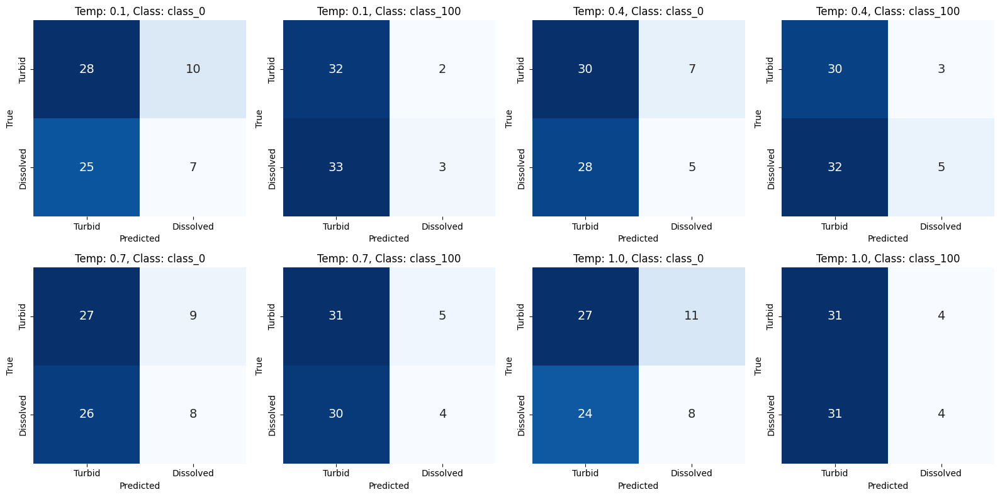

In [258]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import numpy as np

dfs = [df_01, df_04, df_07, df_10]
temperatures = [0.1, 0.4, 0.7, 1.0]
classes = ["class_0", "class_100"]

fig, axs = plt.subplots(2, 4, figsize=(16, 8))  
axs = axs.ravel()  

plot_index = 0
for temp_index, df in enumerate(dfs):
    for class_name in classes:
        predicted_labels = df[class_name]
        true_labels = df[f"correct_{class_name}"].astype(int)  

        conf_matrix = confusion_matrix(true_labels, predicted_labels, labels=[0, 1])

        sns.heatmap(
            conf_matrix, 
            annot=True,  
            fmt='d',  
            cmap="Blues", 
            ax=axs[plot_index], 
            cbar=False,  
            annot_kws={"size": 14}  
        )
        
        axs[plot_index].set_title(f"Temp: {temperatures[temp_index]}, Class: {class_name}")
        axs[plot_index].set_xlabel('Predicted')
        axs[plot_index].set_ylabel('True')
        
        axs[plot_index].set_xticks([0.5, 1.5])
        axs[plot_index].set_yticks([0.5, 1.5])
        axs[plot_index].set_xticklabels(["Turbid", "Dissolved"])
        axs[plot_index].set_yticklabels(["Turbid", "Dissolved"])
        
        plot_index += 1

plt.tight_layout()
plt.show()


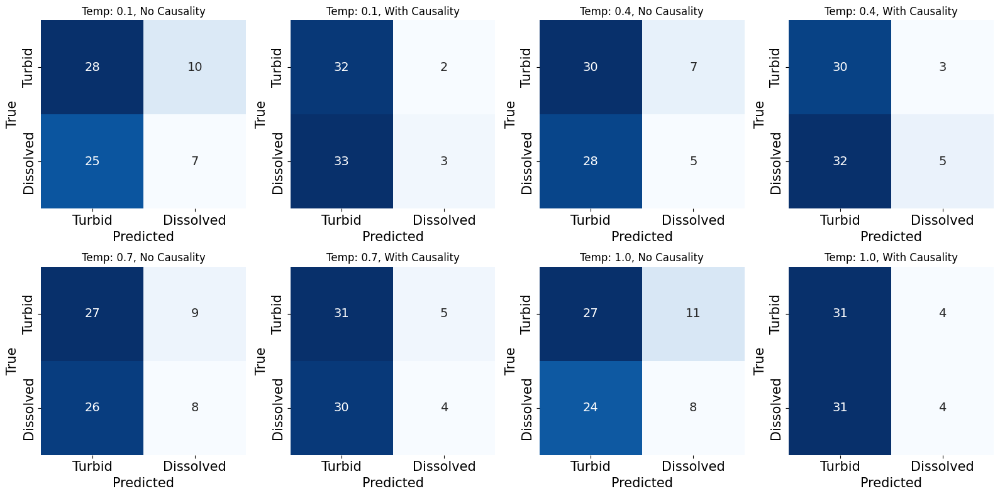

In [265]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns

dfs = [df_01, df_04, df_07, df_10]
temperatures = [0.1, 0.4, 0.7, 1.0]
classes = ["class_0", "class_100"]

fig, axs = plt.subplots(2, 4, figsize=(16, 8)) 
axs = axs.ravel()  


class_name_map = {
    "class_0": "No Causality",
    "class_100": "With Causality"
}


plot_index = 0
for temp_index, df in enumerate(dfs):
    for class_name in classes:
       
        predicted_labels = df[class_name]
        true_labels = df[f"correct_{class_name}"].astype(int) 

        conf_matrix = confusion_matrix(true_labels, predicted_labels, labels=[0, 1])

        sns.heatmap(
            conf_matrix, 
            annot=True, 
            fmt='d',  
            cmap="Blues", 
            ax=axs[plot_index], 
            cbar=False,  
            annot_kws={"size": 14}  
        )
        
        mapped_class_name = class_name_map[class_name]
        axs[plot_index].set_title(f"Temp: {temperatures[temp_index]}, {mapped_class_name}")
        axs[plot_index].set_xlabel('Predicted', size = 15)
        axs[plot_index].set_ylabel('True', size = 15)
        
        axs[plot_index].set_xticks([0.5, 1.5])
        axs[plot_index].set_yticks([0.5, 1.5])
        axs[plot_index].set_xticklabels(["Turbid", "Dissolved"], size = 15)
        axs[plot_index].set_yticklabels(["Turbid", "Dissolved"], size = 15)
        
        plot_index += 1

plt.tight_layout()
plt.show()


In [259]:
dfs = {
    0.1: df_01,
    0.4: df_04,
    0.7: df_07,
    1.0: df_10
}

correct_indices_dict_class_0 = {}
correct_indices_dict_class_100 = {}

for temp, df in dfs.items():
    correct_indices_class_0 = df[df['correct_class_0']].index.tolist()
    correct_indices_dict_class_0[temp] = correct_indices_class_0

    correct_indices_class_100 = df[df['correct_class_100']].index.tolist()
    correct_indices_dict_class_100[temp] = correct_indices_class_100



In [260]:
correct_rows_class_0 = {}
correct_rows_class_100 = {}

for temp in [0.1, 0.4, 0.7, 1.0]:
    indices_class_0 = correct_indices_dict_class_0[temp]
    indices_class_100 = correct_indices_dict_class_100[temp]
    
    correct_rows_class_0[temp] = X_test_features.loc[indices_class_0]
    correct_rows_class_100[temp] = X_test_features.loc[indices_class_100]


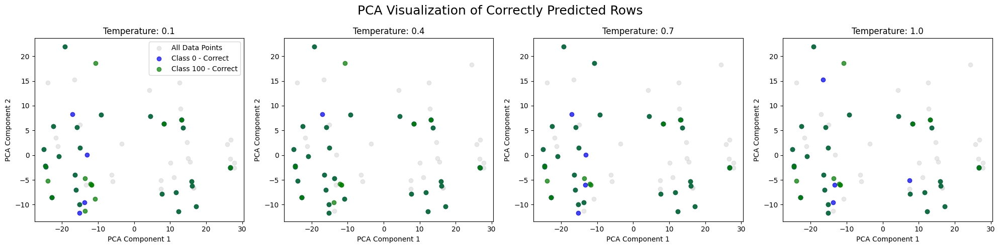

In [261]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 4, figsize=(20, 5))  
fig.suptitle('PCA Visualization of Correctly Predicted Rows', size=18)

temperatures = [0.1, 0.4, 0.7, 1.0]

for i, temp in enumerate(temperatures):
    ax = axs[i]
    
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    
    if temp in correct_rows_class_0:
        ax.scatter(
            correct_rows_class_0[temp]['PCA1'], 
            correct_rows_class_0[temp]['PCA2'], 
            color='blue', label='Class 0 - Correct', alpha=0.7
        )
    
    if temp in correct_rows_class_100:
        ax.scatter(
            correct_rows_class_100[temp]['PCA1'], 
            correct_rows_class_100[temp]['PCA2'], 
            color='green', label='Class 100 - Correct', alpha=0.7
        )
    
    ax.set_title(f'Temperature: {temp}')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    
    if i == 0:
        ax.legend()

plt.tight_layout()
plt.show()


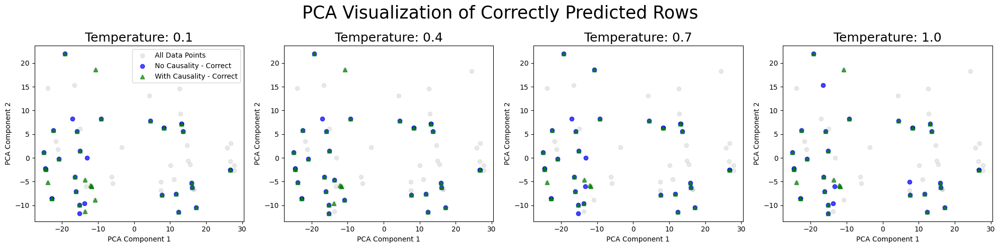

In [262]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 4, figsize=(20, 5))  
fig.suptitle('PCA Visualization of Correctly Predicted Rows', size=25)

temperatures = [0.1, 0.4, 0.7, 1.0]

for i, temp in enumerate(temperatures):
    ax = axs[i]
    
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    
    if temp in correct_rows_class_0:
        ax.scatter(
            correct_rows_class_0[temp]['PCA1'], 
            correct_rows_class_0[temp]['PCA2'], 
            color='blue', label='No Causality - Correct', alpha=0.7, marker='o' 
        )
    
    if temp in correct_rows_class_100:
        ax.scatter(
            correct_rows_class_100[temp]['PCA1'], 
            correct_rows_class_100[temp]['PCA2'], 
            color='green', label='With Causality - Correct', alpha=0.7, marker='^'  # Triangular marker
        )
    
    ax.set_title(f'Temperature: {temp}', size = 18)
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    
    if i == 0:
        ax.legend()

plt.tight_layout()
plt.show()


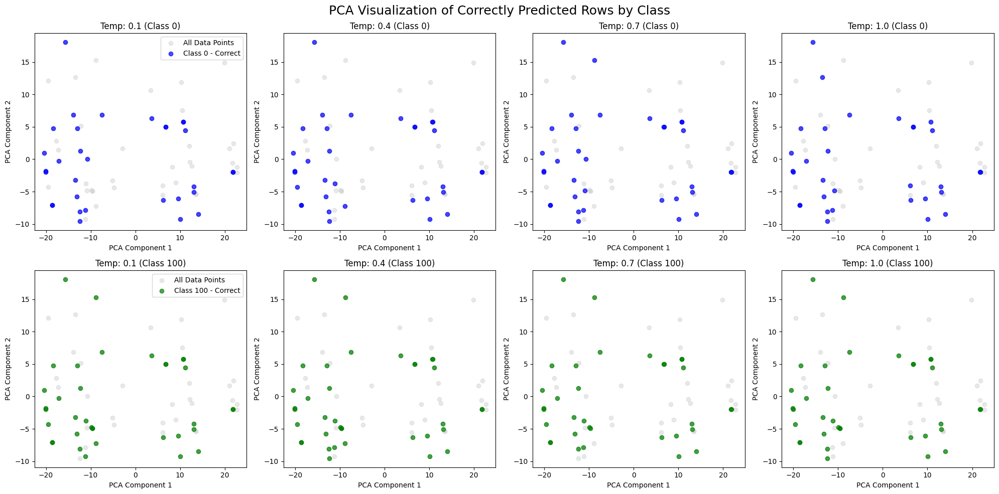

In [121]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 4, figsize=(20, 10)) 
fig.suptitle('PCA Visualization of Correctly Predicted Rows by Class', size=18)

temperatures = [0.1, 0.4, 0.7, 1.0]

for i, temp in enumerate(temperatures):
    ax = axs[0, i]
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    if temp in correct_rows_class_0:
        ax.scatter(
            correct_rows_class_0[temp]['PCA1'], 
            correct_rows_class_0[temp]['PCA2'], 
            color='blue', label='Class 0 - Correct', alpha=0.7
        )
    ax.set_title(f'Temp: {temp} (Class 0)')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    if i == 0:
        ax.legend()

    ax = axs[1, i]
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    if temp in correct_rows_class_100:
        ax.scatter(
            correct_rows_class_100[temp]['PCA1'], 
            correct_rows_class_100[temp]['PCA2'], 
            color='green', label='Class 100 - Correct', alpha=0.7
        )
    ax.set_title(f'Temp: {temp} (Class 100)')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    if i == 0:
        ax.legend()

plt.tight_layout()
plt.show()


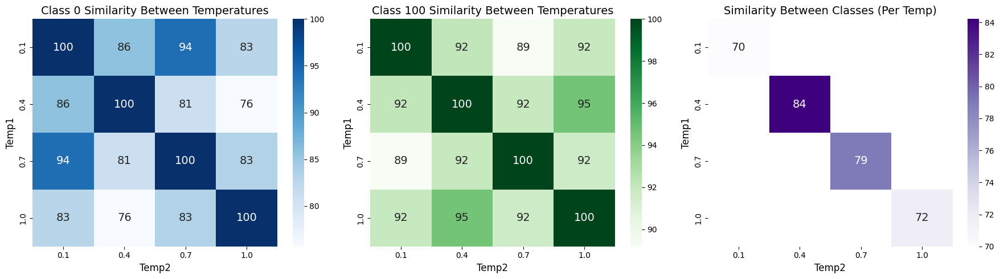

In [126]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

similarity_data = []

temperatures = [0.1, 0.4, 0.7, 1.0]

for temp1 in temperatures:
    for temp2 in temperatures:
        indices1_class_0 = set(correct_rows_class_0[temp1].index)
        indices2_class_0 = set(correct_rows_class_0[temp2].index)
        overlap_class_0 = len(indices1_class_0.intersection(indices2_class_0))
        union_class_0 = len(indices1_class_0.union(indices2_class_0))
        similarity_class_0 = (overlap_class_0 / union_class_0) * 100 if union_class_0 > 0 else 0

        indices1_class_100 = set(correct_rows_class_100[temp1].index)
        indices2_class_100 = set(correct_rows_class_100[temp2].index)
        overlap_class_100 = len(indices1_class_100.intersection(indices2_class_100))
        union_class_100 = len(indices1_class_100.union(indices2_class_100))
        similarity_class_100 = (overlap_class_100 / union_class_100) * 100 if union_class_100 > 0 else 0

        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'class_0',
            'Similarity (%)': similarity_class_0
        })
        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'class_100',
            'Similarity (%)': similarity_class_100
        })

for temp in temperatures:
    indices_class_0 = set(correct_rows_class_0[temp].index)
    indices_class_100 = set(correct_rows_class_100[temp].index)
    overlap_classes = len(indices_class_0.intersection(indices_class_100))
    union_classes = len(indices_class_0.union(indices_class_100))
    similarity_classes = (overlap_classes / union_classes) * 100 if union_classes > 0 else 0

    similarity_data.append({
        'Temp1': temp,
        'Temp2': temp,
        'Class': 'class_0_vs_class_100',
        'Similarity (%)': similarity_classes
    })

similarity_df = pd.DataFrame(similarity_data)

heatmap_data_class_0 = similarity_df[similarity_df['Class'] == 'class_0'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_class_100 = similarity_df[similarity_df['Class'] == 'class_100'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_classes = similarity_df[similarity_df['Class'] == 'class_0_vs_class_100'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')


fig, axs = plt.subplots(1, 3, figsize=(18, 5))

sns.heatmap(
    heatmap_data_class_0, 
    annot=True, 
    cmap="Blues", 
    ax=axs[0], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14} 
)
axs[0].set_title('Class 0 Similarity Between Temperatures', fontsize=14)
axs[0].set_xlabel('Temp2', fontsize=12)
axs[0].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_class_100, 
    annot=True, 
    cmap="Greens", 
    ax=axs[1], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[1].set_title('Class 100 Similarity Between Temperatures', fontsize=14)
axs[1].set_xlabel('Temp2', fontsize=12)
axs[1].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_classes, 
    annot=True, 
    cmap="Purples", 
    ax=axs[2], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[2].set_title('Similarity Between Classes (Per Temp)', fontsize=14)
axs[2].set_xlabel('Temp2', fontsize=12)
axs[2].set_ylabel('Temp1', fontsize=12)

plt.tight_layout()
plt.show()




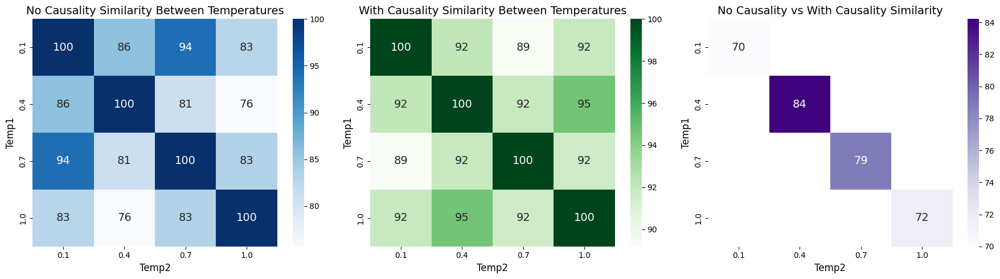

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

similarity_data = []

temperatures = [0.1, 0.4, 0.7, 1.0]

for temp1 in temperatures:
    for temp2 in temperatures:
        indices1_class_0 = set(correct_rows_class_0[temp1].index)
        indices2_class_0 = set(correct_rows_class_0[temp2].index)
        overlap_class_0 = len(indices1_class_0.intersection(indices2_class_0))
        union_class_0 = len(indices1_class_0.union(indices2_class_0))
        similarity_class_0 = (overlap_class_0 / union_class_0) * 100 if union_class_0 > 0 else 0

        indices1_class_100 = set(correct_rows_class_100[temp1].index)
        indices2_class_100 = set(correct_rows_class_100[temp2].index)
        overlap_class_100 = len(indices1_class_100.intersection(indices2_class_100))
        union_class_100 = len(indices1_class_100.union(indices2_class_100))
        similarity_class_100 = (overlap_class_100 / union_class_100) * 100 if union_class_100 > 0 else 0

        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'No Causality',
            'Similarity (%)': similarity_class_0
        })
        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'With Causality',
            'Similarity (%)': similarity_class_100
        })

for temp in temperatures:
    indices_class_0 = set(correct_rows_class_0[temp].index)
    indices_class_100 = set(correct_rows_class_100[temp].index)
    overlap_classes = len(indices_class_0.intersection(indices_class_100))
    union_classes = len(indices_class_0.union(indices_class_100))
    similarity_classes = (overlap_classes / union_classes) * 100 if union_classes > 0 else 0

    similarity_data.append({
        'Temp1': temp,
        'Temp2': temp,
        'Class': 'No Causality vs With Causality',
        'Similarity (%)': similarity_classes
    })

similarity_df = pd.DataFrame(similarity_data)

heatmap_data_class_0 = similarity_df[similarity_df['Class'] == 'No Causality'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_class_100 = similarity_df[similarity_df['Class'] == 'With Causality'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_classes = similarity_df[similarity_df['Class'] == 'No Causality vs With Causality'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')

fig, axs = plt.subplots(1, 3, figsize=(18, 5))

sns.heatmap(
    heatmap_data_class_0, 
    annot=True, 
    cmap="Blues", 
    ax=axs[0], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[0].set_title('No Causality Similarity Between Temperatures', fontsize=14)
axs[0].set_xlabel('Temp2', fontsize=12)
axs[0].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_class_100, 
    annot=True, 
    cmap="Greens", 
    ax=axs[1], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[1].set_title('With Causality Similarity Between Temperatures', fontsize=14)
axs[1].set_xlabel('Temp2', fontsize=12)
axs[1].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_classes, 
    annot=True, 
    cmap="Purples", 
    ax=axs[2], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[2].set_title('No Causality vs With Causality Similarity', fontsize=14)
axs[2].set_xlabel('Temp2', fontsize=12)
axs[2].set_ylabel('Temp1', fontsize=12)

plt.tight_layout()
plt.show()


# Only with SMILES

In [181]:
def run_pipeline_langchain_smiles(api_key, test_set, percentages, few_shot_examples, temp):

    for focus_percentage in percentages:
        
        llm = ChatOpenAI(model_name="gpt-4o-mini", temperature=temp, openai_api_key=api_key)
        memory = ConversationBufferMemory()

        conversation = ConversationChain(
            llm=llm, 
            memory=memory
        )

        column_name = f"class_{focus_percentage}" 

        intro_prompt = (
            f"You are an expert at organic chemistry reaction and causal reasoning. "
            f"Here are a few examples of question-answer I want you to learn from:\n{few_shot_examples}\n"
        )

        if focus_percentage == 0:

            response_intro = conversation.predict(input= intro_prompt)

            print("No causal question asked")

        else:

            counterfactual_prompt = "\n".join(counterfactual_questions_smiles)
            combined_prompt = f"{intro_prompt}\n{counterfactual_prompt}"

            response_combined = conversation.predict(input=combined_prompt)
            #print(f"Combined Response: {response_combined}")

          
            understanding_prompt = (
                f"Now that you have established the relationship between variables in this dataset and understand them, "
                f"I would like to test you on some test questions about turbidity prediction of chemical reactions. "
                f"It is crucial that you remember our training on causality and pay {focus_percentage}% of your attention "
                f"to this new thought process with respect to your normal deductive reasoning approach."
            )
            response_understanding = conversation.predict(input=understanding_prompt)
            #print(f"Understanding Prompt Response: {response_understanding}")

        for index, row in test_set.iterrows():

            test_question = (
                f"Would the following mixture be turbid or dissolved? "
                f"Please answer with **ONLY** the turbidity label and no other text, just turbid or dissolved: {row['Prompt']}"
            )
            
            conversation_history = "\n".join([msg.content for msg in memory.chat_memory.messages])
            full_prompt = conversation_history + f"\n{test_question}"

            response_test = conversation.llm.predict(full_prompt) 
            
            test_set.at[index, column_name] = response_test
                
            print(f"Index: {index}, Question: {full_prompt}, Response: {response_test}")

    return test_set


In [175]:
X_test_features["Prompt"] = X_test_features.apply(
    lambda row: f"Is the mixture between ({row['di_smiles']}) and ({row['tri_smiles']}) turbid or dissolved?",
    axis=1
)

In [176]:
X_test_features['Prompt']

255    Is the mixture between (NCC(CN)O) and (O=Cc1cc...
114    Is the mixture between (NCCN) and (O=Cc1ccc(-c...
314    Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...
268    Is the mixture between (NCc1ccc(CN)cc1) and (O...
167    Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...
                             ...                        
93     Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...
180    Is the mixture between (CN(CCCN)CCCN) and (O=C...
183    Is the mixture between (NCC(CN)O) and (O=Cc1cc...
197    Is the mixture between (NCC1CCC(CN)CC1) and (O...
325    Is the mixture between (NCCOCCN) and (O=Cc1c(O...
Name: Prompt, Length: 70, dtype: object

In [177]:
X_test_features['Answer'] = y_test_features

In [178]:
df_test_smiles = X_test_features[['Prompt', 'Answer']]

In [179]:
X_train_features = X_train_features.loc[selected_indexes]
X_train_features['Answer'] = y_train_features.loc[selected_indexes]

In [144]:
X_train_features["prompt"] = X_train_features.apply(
    lambda row: f"Is the mixture between ({row['di_smiles']}) and ({row['tri_smiles']}) turbid or dissolved?",
    axis=1
)

In [147]:
def create_few_shot_prompt(df):
    prompt = ""
    
    for i in range(df.shape[0]):

        answer_text = "dissolved" if df.iloc[i]['Answer'] == 1 else "turbid"
        
        prompt += f"Q: {df.iloc[i]['prompt']}\nA: The answer is {answer_text}.\n\n"
    
    return prompt

few_shot_prompt_smiles = create_few_shot_prompt(X_train_features)

print(few_shot_prompt_smiles)

Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: The answer is dissolved.




In [761]:
counterfactual_questions_smiles = [

"I want now to teach you how to perform causal reasoning when it comes to solving chemistry problem. ",
"First, ask yourself these questions on the SNILES of the few-shot example provided to you.",
"This will help you understand the causal relationship between variable and deepen you understanding of the dataset. ",
"If the ditopic specie was similar in size compared to the tritopic specie, what would happen ?",
"For when either the ditopic or tritopic species have stereocenters, what would happen if their were inversed ?",
"What would happen if we were to reduce the number of aromatic rings in either of the ditopic or tritopic specie ?"

]

In [404]:
df_test_smiles

,Prompt,Answer,class_0,class_100
255,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,0,turbid,turbid
114,Is the mixture between (NCCN) and (O=Cc1ccc(-c...,0,turbid,turbid
314,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,1,turbid,turbid
268,Is the mixture between (NCc1ccc(CN)cc1) and (O...,1,turbid,dissolved
167,Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...,1,turbid,turbid
...,...,...,...,...
93,Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...,0,dissolved,turbid
180,Is the mixture between (CN(CCCN)CCCN) and (O=C...,1,dissolved,dissolved
183,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,1,turbid,turbid
197,Is the mixture between (NCC1CCC(CN)CC1) and (O...,1,turbid,turbid


In [183]:
from scipy.stats import mode  

df_runs = []
df_mean_dic = {}

prediction_columns = ['class_0', 'class_100']

for t in temp:  
    n_runs = 3  
    df_mean = []  

    for i in range(n_runs):
        print(f"Run {i+1}/{n_runs}")
        df_results_inst = run_pipeline_langchain_smiles(api_key, df_test_smiles, percentages, few_shot_prompt_smiles, t)

        df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)

        df_extracted['Prompt'] = df_results_inst['Prompt']

        df_mean.append(df_extracted)

        df_temp = pd.DataFrame()
        df_temp['true_category'] = df_extracted['Answer']

        for col in prediction_columns:
            df_temp[f"category_{col}"] = df_extracted[col]

        df_runs.append(df_temp)

    combined_df = pd.concat(df_mean, axis=0, keys=range(n_runs))

    numeric_columns = ['Answer', 'class_0', 'class_100']
    most_recurrent_df = combined_df[numeric_columns].groupby(level=1).agg(lambda x: majority_count(x))

    most_recurrent_df['Prompt'] = combined_df.groupby(level=1)['Prompt'].first()

    df_mean_dic[t] = most_recurrent_df

final_df = pd.concat(df_mean_dic.values(), keys=df_mean_dic.keys())

print(final_df)


Run 1/3
No causal question asked


/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/1636749704.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_set.at[index, column_name] = response_test


Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: The answer is dissolved.



/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/1636749704.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_set.at[index, column_name] = response_test


Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: The answer is dissolved.



/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


No causal question asked
Index: 255, Question: You are an expert at organic chemistry reaction and causal reasoning. Here are a few examples of question-answer I want you to learn from:
Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?
A: The answer is dissolved.

Q: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?
A: The answer is turbid.

Q: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?
A: T

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2509328058.py:16: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_extracted = df_results_inst.drop(columns=['Prompt']).applymap(map_to_numeric)


In [185]:
df_safe_smiles = final_df.copy()

In [279]:
final_df = df_safe_smiles.copy()

In [243]:
df_safe_smiles.to_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/results_smilesonly.csv')

In [280]:
final_df['correct_class_0'] = final_df['Answer'] == final_df['class_0']
final_df['correct_class_100'] = final_df['Answer'] == final_df['class_100']

In [281]:
final_df

Answer  class_0  class_100  \
0.1 3         0        0          1   
    5         0        0          1   
    9         0        0          1   
    22        1        0          1   
    25        0        1          1   
...         ...      ...        ...   
1.0 322       0        0          1   
    325       0        1          1   
    326       0        0          1   
    336       0        0          0   
    337       1        0          0   

                                                    Prompt  correct_class_0  \
0.1 3    Is the mixture between (O=Cc1ccc(C=O)cc1) and ...             True   
    5    Is the mixture between (O=Cc1ccc(-c2ccc(C=O)cc...             True   
    9    Is the mixture between (O=Cc1ccccc1C=O) and (N...             True   
    22   Is the mixture between (O=Cc1c2ccccc2c(C=O)c2c...            False   
    25   Is the mixture between (O=Cc1ccccc1C=O) and (C...            False   
...                                                    ...              ...   
1.0 322  Is the mixture between (NCc1ccc(CN)cc1) and (O...             True   
    325  Is the mixture between (NCCOCCN) and (O=Cc1c(O...            False   
    326  Is the mixture between (NCC1=CC(CN)=CC=C1) and...             True   
    336  Is the mixture between (N[C@H]1CCC[C@H](C1)N) ...             True   
    337  Is the mixture between (N[C@@H]1[C@H](CCCC1)N)...            False   

         correct_class_100  
0.1 3                False  
    5                False  
    9                False  
    22                True  
    25               False  
...                    ...  
1.0 322              False  
    325              False  
    326              False  
    336               True  
    337              False  

[280 rows x 6 columns]

In [282]:
dfs = {
    0.1: df_01_smiles,
    0.4: df_04_smiles,
    0.7: df_07_smiles,
    1.0: df_10_smiles
}

accuracies = {}

for temp, df in dfs.items():
    correct_class_0 = (df['Answer'] == df['class_0']).sum()
    total_class_0 = len(df)
    accuracy_class_0 = correct_class_0 / total_class_0 * 100

    correct_class_100 = (df['Answer'] == df['class_100']).sum()
    total_class_100 = len(df)
    accuracy_class_100 = correct_class_100 / total_class_100 * 100

    accuracies[temp] = {
        'Accuracy_Class_0 (%)': accuracy_class_0,
        'Accuracy_Class_100 (%)': accuracy_class_100
    }

accuracies_df = pd.DataFrame(accuracies).T


In [283]:
df_01_smiles

,Answer,class_0,class_100,Prompt,correct_class_0,correct_class_100
3,0,0,1,Is the mixture between (O=Cc1ccc(C=O)cc1) and ...,True,False
5,0,0,1,Is the mixture between (O=Cc1ccc(-c2ccc(C=O)cc...,True,False
9,0,0,1,Is the mixture between (O=Cc1ccccc1C=O) and (N...,True,False
22,1,0,1,Is the mixture between (O=Cc1c2ccccc2c(C=O)c2c...,False,True
25,0,1,1,Is the mixture between (O=Cc1ccccc1C=O) and (C...,False,False
...,...,...,...,...,...,...
322,0,0,1,Is the mixture between (NCc1ccc(CN)cc1) and (O...,True,False
325,0,1,1,Is the mixture between (NCCOCCN) and (O=Cc1c(O...,False,False
326,0,0,1,Is the mixture between (NCC1=CC(CN)=CC=C1) and...,True,False
336,0,0,0,Is the mixture between (N[C@H]1CCC[C@H](C1)N) ...,True,True


In [284]:
df_01_smiles = final_df.loc[0.1]
df_04_smiles  = final_df.loc[0.4]
df_07_smiles  = final_df.loc[0.7]
df_10_smiles  = final_df.loc[1.0]

In [285]:
accuracies_df

,Accuracy_Class_0 (%),Accuracy_Class_100 (%)
0.1,51.428571,45.714286
0.4,48.571429,48.571429
0.7,44.285714,45.714286
1.0,52.857143,48.571429


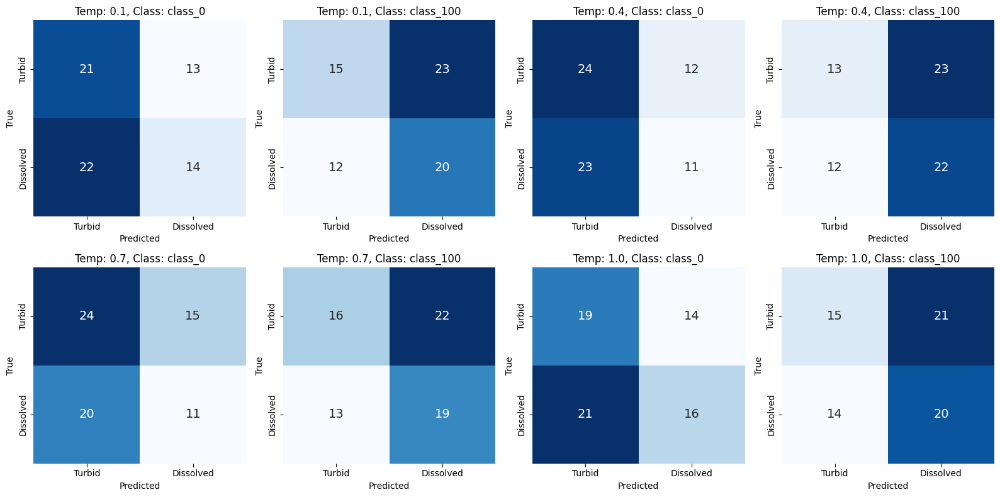

In [286]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import numpy as np

dfs = [df_01_smiles, df_04_smiles, df_07_smiles, df_10_smiles]
temperatures = [0.1, 0.4, 0.7, 1.0]
classes = ["class_0", "class_100"]

fig, axs = plt.subplots(2, 4, figsize=(16, 8))  
axs = axs.ravel()  


plot_index = 0
for temp_index, df in enumerate(dfs):
    for class_name in classes:

        predicted_labels = df[class_name]
        true_labels = df[f"correct_{class_name}"].astype(int)  

        conf_matrix = confusion_matrix(true_labels, predicted_labels, labels=[0, 1])

        sns.heatmap(
            conf_matrix, 
            annot=True,  
            fmt='d',  
            cmap="Blues", 
            ax=axs[plot_index], 
            cbar=False,  
            annot_kws={"size": 14}  
        )
        
        axs[plot_index].set_title(f"Temp: {temperatures[temp_index]}, Class: {class_name}")
        axs[plot_index].set_xlabel('Predicted')
        axs[plot_index].set_ylabel('True')
        
        axs[plot_index].set_xticks([0.5, 1.5])
        axs[plot_index].set_yticks([0.5, 1.5])
        axs[plot_index].set_xticklabels(["Turbid", "Dissolved"])
        axs[plot_index].set_yticklabels(["Turbid", "Dissolved"])
        
        plot_index += 1

plt.tight_layout()
plt.show()


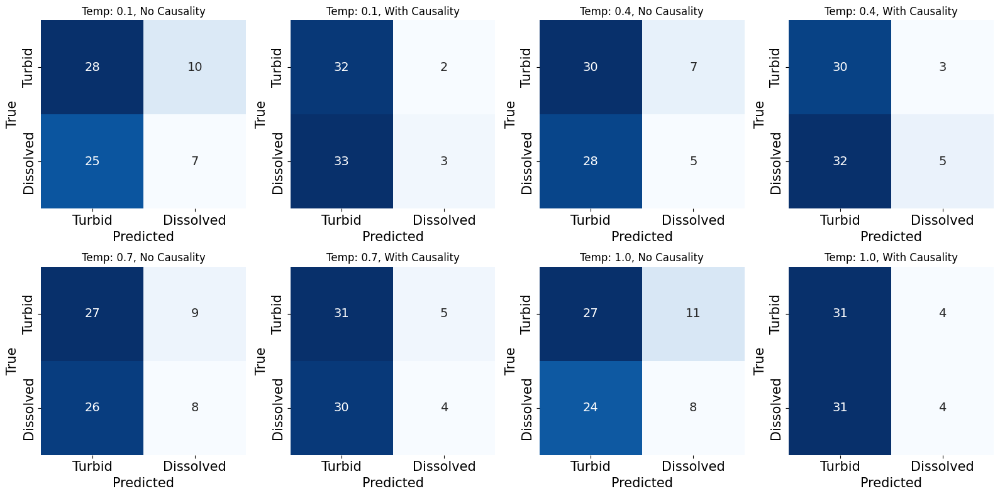

In [287]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns

dfs = [df_01, df_04, df_07, df_10]
temperatures = [0.1, 0.4, 0.7, 1.0]
classes = ["class_0", "class_100"]

fig, axs = plt.subplots(2, 4, figsize=(16, 8)) 
axs = axs.ravel()  

class_name_map = {
    "class_0": "No Causality",
    "class_100": "With Causality"
}

plot_index = 0
for temp_index, df in enumerate(dfs):
    for class_name in classes:
        predicted_labels = df[class_name]
        true_labels = df[f"correct_{class_name}"].astype(int) 

        conf_matrix = confusion_matrix(true_labels, predicted_labels, labels=[0, 1])

        sns.heatmap(
            conf_matrix, 
            annot=True,  
            fmt='d',  
            cmap="Blues", 
            ax=axs[plot_index], 
            cbar=False,  
            annot_kws={"size": 14} 
        )
        
        mapped_class_name = class_name_map[class_name]
        axs[plot_index].set_title(f"Temp: {temperatures[temp_index]}, {mapped_class_name}")
        axs[plot_index].set_xlabel('Predicted', size = 15)
        axs[plot_index].set_ylabel('True', size = 15)
        
        axs[plot_index].set_xticks([0.5, 1.5])
        axs[plot_index].set_yticks([0.5, 1.5])
        axs[plot_index].set_xticklabels(["Turbid", "Dissolved"], size = 15)
        axs[plot_index].set_yticklabels(["Turbid", "Dissolved"], size = 15)
        
        plot_index += 1
        
plt.tight_layout()
plt.show()


In [288]:

dfs = {
    0.1: df_01_smiles,
    0.4: df_04_smiles,
    0.7: df_07_smiles,
    1.0: df_10_smiles
}

correct_indices_dict_class_0 = {}
correct_indices_dict_class_100 = {}

for temp, df in dfs.items():
   
    correct_indices_class_0 = df[df['correct_class_0']].index.tolist()
    correct_indices_dict_class_0[temp] = correct_indices_class_0

    correct_indices_class_100 = df[df['correct_class_100']].index.tolist()
    correct_indices_dict_class_100[temp] = correct_indices_class_100



In [289]:
correct_rows_class_0 = {}
correct_rows_class_100 = {}

for temp in [0.1, 0.4, 0.7, 1.0]:
    indices_class_0 = correct_indices_dict_class_0[temp]
    indices_class_100 = correct_indices_dict_class_100[temp]
    
    correct_rows_class_0[temp] = X_test_features.loc[indices_class_0]
    correct_rows_class_100[temp] = X_test_features.loc[indices_class_100]


In [227]:
X_test_features = X_test_features.drop(['di_smiles', 'tri_smiles', 'prompt', 'Answer', 'Prompt'], axis =1)

In [230]:
X_test_features

,di_h_bond_donor_count,di_arom_group,di_complexity,di_xlogp,tri_h_bond_donor_count,tri_xlogp,tri_complexity,tri_heavy_atom_count,tri_exact_mass,tri_molecular_weight,...,tri_rotatable_bond_count,di_heavy_atom_count,di_molecular_weight,di_exact_mass,tri_tpsa,di_tpsa,di_h_bond_acceptor_count,di_defined_atom_stereo_count,tri_defined_bond_stereo_count,tri_h_bond_acceptor_count
255,3,0,0.063584,0.000000,0.0,0.804124,0.543379,27.0,0.796204,0.796828,...,6.0,6,0.111103,0.111133,1.000000,0.671353,3,0,0.0,6.0
114,2,0,0.000000,0.048387,0.0,0.804124,0.544684,30.0,0.745739,0.745753,...,6.0,4,0.000000,0.000000,0.000000,0.314587,2,0,0.0,3.0
314,2,1,0.465318,0.338710,3.0,0.360825,0.198956,15.0,0.237088,0.237090,...,3.0,14,0.485455,0.485383,0.716981,0.372583,3,2,0.0,6.0
268,2,1,0.194509,0.306452,0.0,0.628866,0.535551,27.0,0.660840,0.660816,...,6.0,10,0.281606,0.281554,0.464623,0.314587,2,0,0.0,6.0
167,2,0,0.141329,0.322581,0.0,0.628866,0.422048,25.0,0.573410,0.573339,...,6.0,8,0.200185,0.200143,0.037736,0.314587,2,0,0.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,0,2,0.687861,0.500000,3.0,0.103093,0.014090,9.0,0.008645,0.008691,...,0.0,14,0.474019,0.473963,0.317217,0.314587,3,0,0.0,3.0
180,2,0,0.150000,0.225806,0.0,0.608247,0.561644,30.0,0.754171,0.754219,...,6.0,10,0.315137,0.315096,0.456368,0.372583,3,0,0.0,6.0
183,3,0,0.063584,0.000000,0.0,0.608247,0.561644,30.0,0.754171,0.754219,...,6.0,6,0.111103,0.111133,0.456368,0.671353,3,0,0.0,6.0
197,2,0,0.194509,0.387097,0.0,0.927835,1.000000,36.0,0.949076,0.949207,...,9.0,10,0.303997,0.303947,0.000000,0.314587,2,0,0.0,3.0


In [233]:
from sklearn.preprocessing import MinMaxScaler
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans


selected_list = ['di_complexity', 'di_xlogp', 'tri_xlogp', 'tri_complexity',
    'tri_exact_mass', 'di_molecular_weight', 'tri_molecular_weight',  'di_exact_mass',
    'tri_tpsa', 'di_tpsa']


scaler = MinMaxScaler()
X_test_features[selected_list] = scaler.fit_transform(X_test_features[selected_list])

pca = PCA(n_components=2)
pca_data = pca.fit_transform(X_test_features)  
X_test_features['PCA1'] = pca_data[:, 0]
X_test_features['PCA2'] = pca_data[:, 1]

kmeans = KMeans(n_clusters=6, random_state=42)  
X_test_features['Cluster'] = kmeans.fit_predict(pca_data)



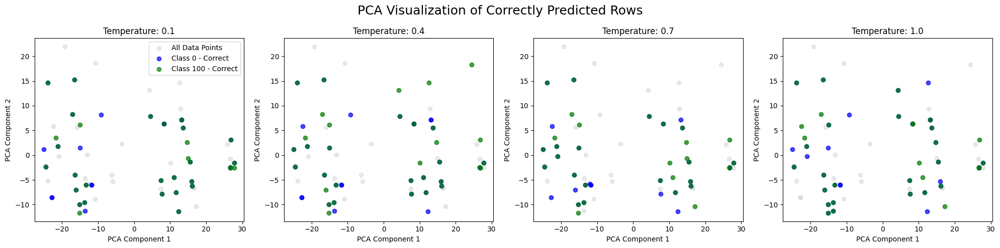

In [248]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 4, figsize=(20, 5)) 
fig.suptitle('PCA Visualization of Correctly Predicted Rows', size=18)

temperatures = [0.1, 0.4, 0.7, 1.0]

for i, temp in enumerate(temperatures):
    ax = axs[i]
    
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    
    if temp in correct_rows_class_0:
        ax.scatter(
            correct_rows_class_0[temp]['PCA1'], 
            correct_rows_class_0[temp]['PCA2'], 
            color='blue', label='Class 0 - Correct', alpha=0.7
        )
    
    if temp in correct_rows_class_100:
        ax.scatter(
            correct_rows_class_100[temp]['PCA1'], 
            correct_rows_class_100[temp]['PCA2'], 
            color='green', label='Class 100 - Correct', alpha=0.7
        )
    
    ax.set_title(f'Temperature: {temp}')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    
    if i == 0:
        ax.legend()

plt.tight_layout()
plt.show()


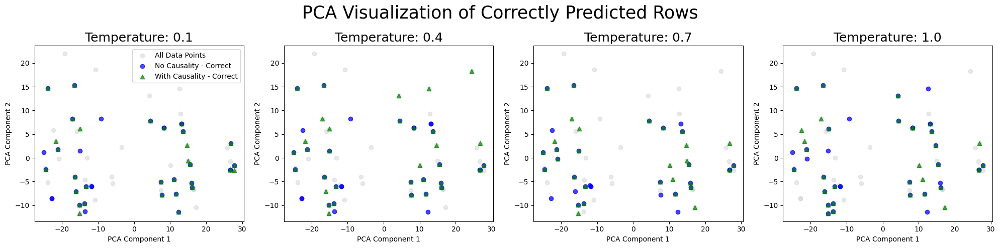

In [251]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 4, figsize=(20, 5))  
fig.suptitle('PCA Visualization of Correctly Predicted Rows', size=25)

temperatures = [0.1, 0.4, 0.7, 1.0]

for i, temp in enumerate(temperatures):

    ax = axs[i]
    
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    
    if temp in correct_rows_class_0:
        ax.scatter(
            correct_rows_class_0[temp]['PCA1'], 
            correct_rows_class_0[temp]['PCA2'], 
            color='blue', label='No Causality - Correct', alpha=0.7, marker='o'  
        )
    
    if temp in correct_rows_class_100:
        ax.scatter(
            correct_rows_class_100[temp]['PCA1'], 
            correct_rows_class_100[temp]['PCA2'], 
            color='green', label='With Causality - Correct', alpha=0.7, marker='^'  
        )
    
    ax.set_title(f'Temperature: {temp}', size = 18)
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    
    if i == 0:
        ax.legend()

plt.tight_layout()
plt.show()


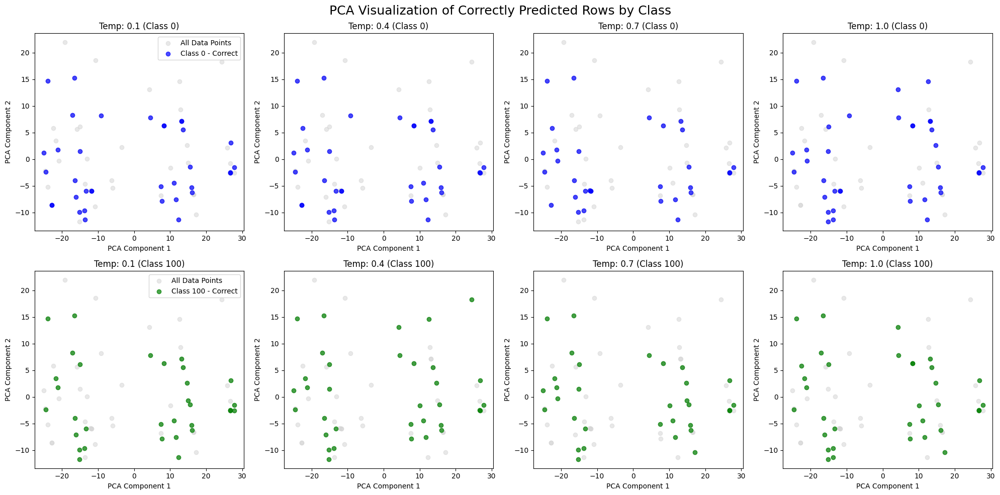

In [239]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 4, figsize=(20, 10))  
fig.suptitle('PCA Visualization of Correctly Predicted Rows by Class', size=18)

temperatures = [0.1, 0.4, 0.7, 1.0]


for i, temp in enumerate(temperatures):
 
    ax = axs[0, i]
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    if temp in correct_rows_class_0:
        ax.scatter(
            correct_rows_class_0[temp]['PCA1'], 
            correct_rows_class_0[temp]['PCA2'], 
            color='blue', label='Class 0 - Correct', alpha=0.7
        )
    ax.set_title(f'Temp: {temp} (Class 0)')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    if i == 0:
        ax.legend()

  
    ax = axs[1, i]
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    if temp in correct_rows_class_100:
        ax.scatter(
            correct_rows_class_100[temp]['PCA1'], 
            correct_rows_class_100[temp]['PCA2'], 
            color='green', label='Class 100 - Correct', alpha=0.7
        )
    ax.set_title(f'Temp: {temp} (Class 100)')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    if i == 0:
        ax.legend()

# Adjust layout and display the plots
plt.tight_layout()
plt.show()


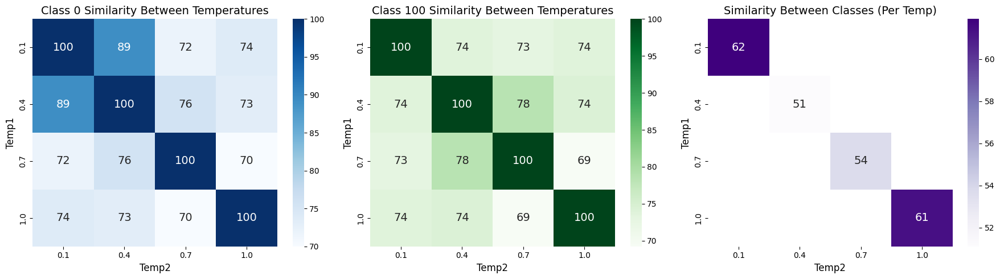

In [290]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

similarity_data = []

temperatures = [0.1, 0.4, 0.7, 1.0]

for temp1 in temperatures:
    for temp2 in temperatures:
        indices1_class_0 = set(correct_rows_class_0[temp1].index)
        indices2_class_0 = set(correct_rows_class_0[temp2].index)
        overlap_class_0 = len(indices1_class_0.intersection(indices2_class_0))
        union_class_0 = len(indices1_class_0.union(indices2_class_0))
        similarity_class_0 = (overlap_class_0 / union_class_0) * 100 if union_class_0 > 0 else 0

        indices1_class_100 = set(correct_rows_class_100[temp1].index)
        indices2_class_100 = set(correct_rows_class_100[temp2].index)
        overlap_class_100 = len(indices1_class_100.intersection(indices2_class_100))
        union_class_100 = len(indices1_class_100.union(indices2_class_100))
        similarity_class_100 = (overlap_class_100 / union_class_100) * 100 if union_class_100 > 0 else 0

        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'class_0',
            'Similarity (%)': similarity_class_0
        })
        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'class_100',
            'Similarity (%)': similarity_class_100
        })

for temp in temperatures:
    indices_class_0 = set(correct_rows_class_0[temp].index)
    indices_class_100 = set(correct_rows_class_100[temp].index)
    overlap_classes = len(indices_class_0.intersection(indices_class_100))
    union_classes = len(indices_class_0.union(indices_class_100))
    similarity_classes = (overlap_classes / union_classes) * 100 if union_classes > 0 else 0

    similarity_data.append({
        'Temp1': temp,
        'Temp2': temp,
        'Class': 'class_0_vs_class_100',
        'Similarity (%)': similarity_classes
    })

similarity_df = pd.DataFrame(similarity_data)

heatmap_data_class_0 = similarity_df[similarity_df['Class'] == 'class_0'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_class_100 = similarity_df[similarity_df['Class'] == 'class_100'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_classes = similarity_df[similarity_df['Class'] == 'class_0_vs_class_100'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')

fig, axs = plt.subplots(1, 3, figsize=(18, 5))

sns.heatmap(
    heatmap_data_class_0, 
    annot=True, 
    cmap="Blues", 
    ax=axs[0], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[0].set_title('Class 0 Similarity Between Temperatures', fontsize=14)
axs[0].set_xlabel('Temp2', fontsize=12)
axs[0].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_class_100, 
    annot=True, 
    cmap="Greens", 
    ax=axs[1], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[1].set_title('Class 100 Similarity Between Temperatures', fontsize=14)
axs[1].set_xlabel('Temp2', fontsize=12)
axs[1].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_classes, 
    annot=True, 
    cmap="Purples", 
    ax=axs[2], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[2].set_title('Similarity Between Classes (Per Temp)', fontsize=14)
axs[2].set_xlabel('Temp2', fontsize=12)
axs[2].set_ylabel('Temp1', fontsize=12)

plt.tight_layout()
plt.show()




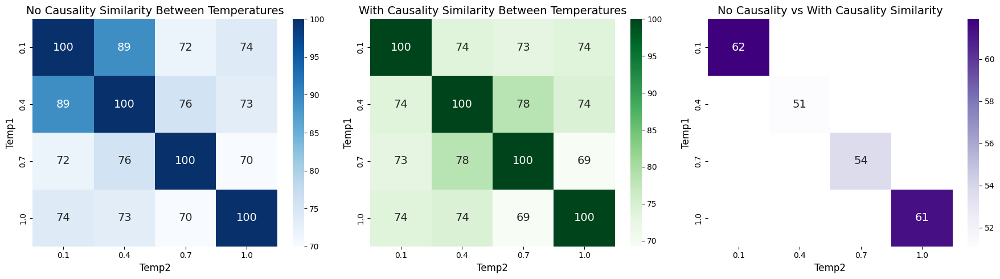

In [291]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

similarity_data = []

temperatures = [0.1, 0.4, 0.7, 1.0]

for temp1 in temperatures:
    for temp2 in temperatures:

        indices1_class_0 = set(correct_rows_class_0[temp1].index)
        indices2_class_0 = set(correct_rows_class_0[temp2].index)
        overlap_class_0 = len(indices1_class_0.intersection(indices2_class_0))
        union_class_0 = len(indices1_class_0.union(indices2_class_0))
        similarity_class_0 = (overlap_class_0 / union_class_0) * 100 if union_class_0 > 0 else 0

        indices1_class_100 = set(correct_rows_class_100[temp1].index)
        indices2_class_100 = set(correct_rows_class_100[temp2].index)
        overlap_class_100 = len(indices1_class_100.intersection(indices2_class_100))
        union_class_100 = len(indices1_class_100.union(indices2_class_100))
        similarity_class_100 = (overlap_class_100 / union_class_100) * 100 if union_class_100 > 0 else 0

        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'No Causality',
            'Similarity (%)': similarity_class_0
        })
        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'With Causality',
            'Similarity (%)': similarity_class_100
        })

for temp in temperatures:
    indices_class_0 = set(correct_rows_class_0[temp].index)
    indices_class_100 = set(correct_rows_class_100[temp].index)
    overlap_classes = len(indices_class_0.intersection(indices_class_100))
    union_classes = len(indices_class_0.union(indices_class_100))
    similarity_classes = (overlap_classes / union_classes) * 100 if union_classes > 0 else 0

    similarity_data.append({
        'Temp1': temp,
        'Temp2': temp,
        'Class': 'No Causality vs With Causality',
        'Similarity (%)': similarity_classes
    })

similarity_df = pd.DataFrame(similarity_data)

heatmap_data_class_0 = similarity_df[similarity_df['Class'] == 'No Causality'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_class_100 = similarity_df[similarity_df['Class'] == 'With Causality'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_classes = similarity_df[similarity_df['Class'] == 'No Causality vs With Causality'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')

fig, axs = plt.subplots(1, 3, figsize=(18, 5))

sns.heatmap(
    heatmap_data_class_0, 
    annot=True, 
    cmap="Blues", 
    ax=axs[0], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[0].set_title('No Causality Similarity Between Temperatures', fontsize=14)
axs[0].set_xlabel('Temp2', fontsize=12)
axs[0].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_class_100, 
    annot=True, 
    cmap="Greens", 
    ax=axs[1], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[1].set_title('With Causality Similarity Between Temperatures', fontsize=14)
axs[1].set_xlabel('Temp2', fontsize=12)
axs[1].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_classes, 
    annot=True, 
    cmap="Purples", 
    ax=axs[2], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[2].set_title('No Causality vs With Causality Similarity', fontsize=14)
axs[2].set_xlabel('Temp2', fontsize=12)
axs[2].set_ylabel('Temp1', fontsize=12)

plt.tight_layout()
plt.show()


# Plotting for all results

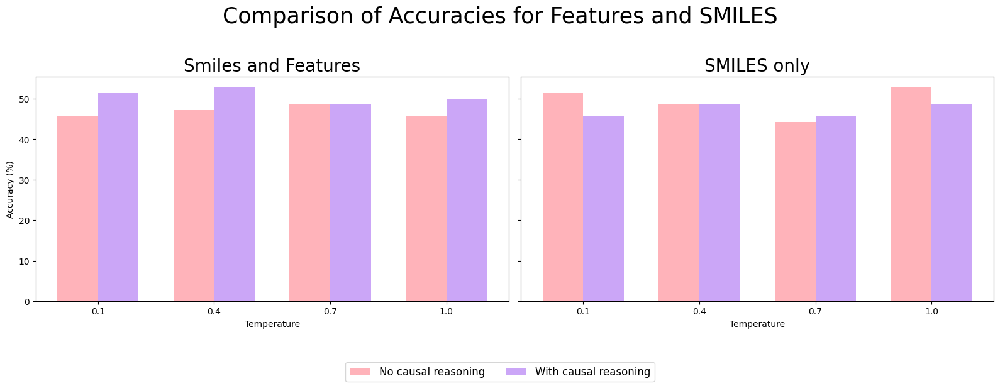

In [198]:
import matplotlib.pyplot as plt
import numpy as np

accuracies = {
    "Features": {
        "Accuracy_Class_0 (%)": [45.714286, 47.142857, 48.571429, 45.714286],
        "Accuracy_Class_100 (%)": [51.428571, 52.857143, 48.571429, 50.000000]
    },
    "SMILES": {
        "Accuracy_Class_0 (%)": [51.428571, 48.571429, 44.285714, 52.857143],
        "Accuracy_Class_100 (%)": [45.714286, 48.571429, 45.714286, 48.571429]
    }
}

temperatures = [0.1, 0.4, 0.7, 1.0]
x = np.arange(len(temperatures))  
bar_width = 0.35 

color_no_causal = "#ffb3ba" 
color_with_causal = "#cba6f7"  


fig, axs = plt.subplots(1, 2, figsize=(16, 6), sharey=True)  
fig.suptitle("Comparison of Accuracies for Features and SMILES", fontsize=25)

axs[0].bar(x - bar_width / 2, accuracies["Features"]["Accuracy_Class_0 (%)"], bar_width, label="No causal reasoning", color=color_no_causal)
axs[0].bar(x + bar_width / 2, accuracies["Features"]["Accuracy_Class_100 (%)"], bar_width, label="With causal reasoning", color=color_with_causal)
axs[0].set_title("Smiles and Features", size=20)
axs[0].set_xticks(x)
axs[0].set_xticklabels([f"{temp}" for temp in temperatures])
axs[0].set_xlabel("Temperature")
axs[0].set_ylabel("Accuracy (%)")

axs[1].bar(x - bar_width / 2, accuracies["SMILES"]["Accuracy_Class_0 (%)"], bar_width, label="No causal reasoning", color=color_no_causal)
axs[1].bar(x + bar_width / 2, accuracies["SMILES"]["Accuracy_Class_100 (%)"], bar_width, label="With causal reasoning", color=color_with_causal)
axs[1].set_title("SMILES only", size=20)
axs[1].set_xticks(x)
axs[1].set_xticklabels([f"{temp}" for temp in temperatures])
axs[1].set_xlabel("Temperature")

handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center', ncol=2, fontsize=12, bbox_to_anchor=(0.5, 0.05))  

plt.tight_layout(rect=[0, 0.1, 1, 0.95])  
plt.show()


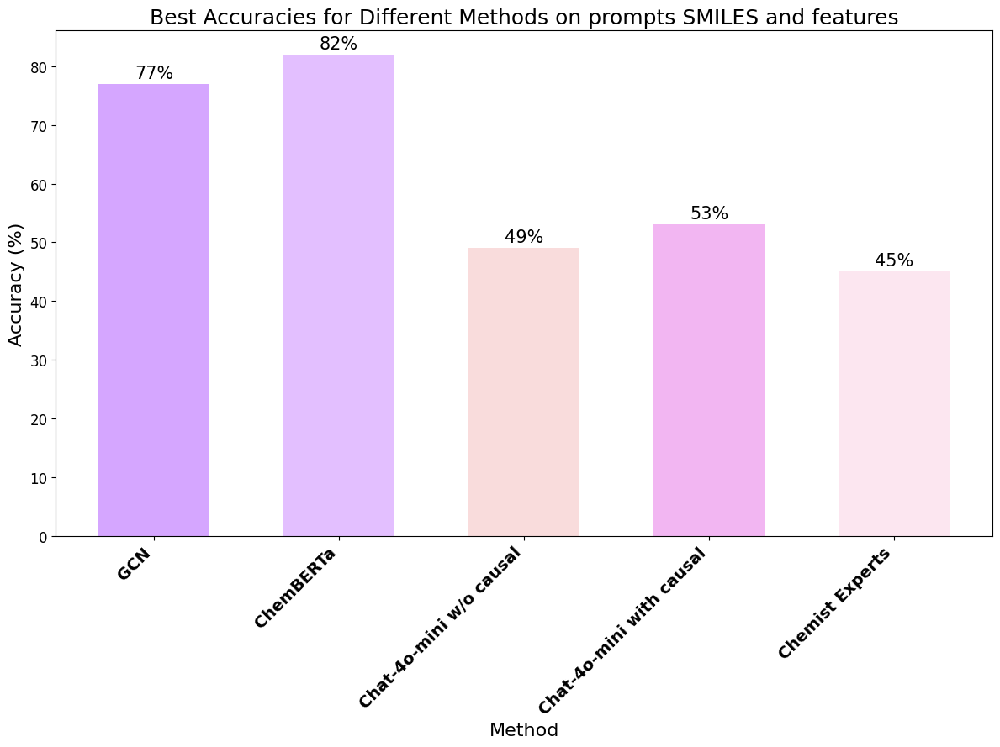

In [323]:
import matplotlib.pyplot as plt

methods = ["GCN", "ChemBERTa", "Chat-4o-mini w/o causal", "Chat-4o-mini with causal", "Chemist Experts"]
accuracies = [77, 82, 49, 53, 45] 

plt.figure(figsize=(12, 9))
colors = [
    "#D5A6FF",  
    "#E3BFFF",  
    "#F9DCDC",  
    "#F2B6F2", 
    "#FCE6F0"   
]

plt.bar(methods, accuracies, color=colors, width=0.6)


plt.title("Best Accuracies for Different Methods on prompts SMILES and features", fontsize=18)
plt.xlabel("Method", fontsize=16)
plt.ylabel("Accuracy (%)", fontsize=16)
plt.xticks(rotation=45, fontsize=14, ha='right', weight = 'bold')
plt.yticks(fontsize=12)


for i, acc in enumerate(accuracies):
    plt.text(i, acc + 1, f"{acc}%", ha='center', fontsize=15)


plt.tight_layout()
plt.show()


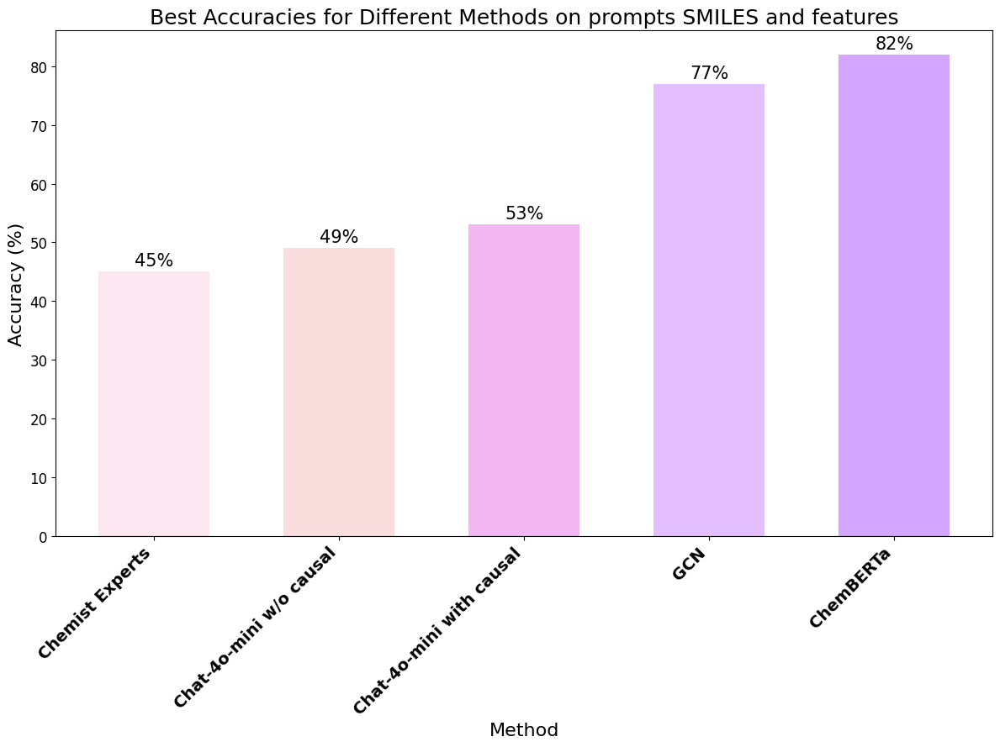

In [2]:
import matplotlib.pyplot as plt

methods = ["GCN", "ChemBERTa", "Chat-4o-mini w/o causal", "Chat-4o-mini with causal", "Chemist Experts"]
accuracies = [77, 82, 49, 53, 45]  


sorted_indices = sorted(range(len(accuracies)), key=lambda x: accuracies[x])
methods_sorted = [methods[i] for i in sorted_indices]
accuracies_sorted = [accuracies[i] for i in sorted_indices]

colors_sorted = [
    "#FCE6F0", 
    "#F9DCDC",  
    "#F2B6F2",  
    "#E3BFFF",  
    "#D5A6FF"   
]

plt.figure(figsize=(12, 9))
plt.bar(methods_sorted, accuracies_sorted, color=colors_sorted, width=0.6)

plt.title("Best Accuracies for Different Methods on prompts SMILES and features", fontsize=18)
plt.xlabel("Method", fontsize=16)
plt.ylabel("Accuracy (%)", fontsize=16)
plt.xticks(rotation=45, fontsize=14, ha='right', weight='bold')
plt.yticks(fontsize=12)

for i, acc in enumerate(accuracies_sorted):
    plt.text(i, acc + 1, f"{acc}%", ha='center', fontsize=15)

plt.tight_layout()
plt.show()


# Vizualisation

In [ ]:
data = data_all.copy()

In [ ]:
from rdkit.Chem import Draw
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.pyplot as plt

def export_molecules_to_pdf(data, pdf_filename, rows_per_page=5):
    with PdfPages(pdf_filename) as pdf:
        total_rows = len(data)
        num_pages = (total_rows + rows_per_page - 1) // rows_per_page 

        for page in range(num_pages):

            start_row = page * rows_per_page
            end_row = min((page + 1) * rows_per_page, total_rows)
            data_subset = data.iloc[start_row:end_row]

 
            fig, axes = plt.subplots(len(data_subset), 2, figsize=(8, len(data_subset) * 4))
            if len(data_subset) == 1:  
                axes = [axes]

            for i, (index, row) in enumerate(data_subset.iterrows()): 
             
                di_img = Draw.MolToImage(row['di_molecule'])
                tri_img = Draw.MolToImage(row['tri_molecule'])
        
                axes[i][0].imshow(di_img)
                axes[i][0].axis("off")
                axes[i][0].set_title(f"Row {index}: di_smiles")

                axes[i][1].imshow(tri_img)
                axes[i][1].axis("off")
                label = "Turbid" if row["turbidity_binary"] == 0 else "Dissolved"
                axes[i][1].set_title(f"Row {index}: tri_smiles ({label})")

            plt.tight_layout()
            pdf.savefig(fig)  
            plt.close(fig)  #

    print(f"Exported visualizations to {pdf_filename}")

export_molecules_to_pdf(data, "molecule_visualizations.pdf", rows_per_page=5)


Exported visualizations to molecule_visualizations.pdf


In [ ]:
columns = [131, 121]
data.iloc[columns]

,turbidity_binary,di_smiles,tri_smiles,di_h_bond_donor_count,di_arom_group,di_complexity,di_xlogp,tri_h_bond_donor_count,tri_xlogp,tri_complexity,...,di_molecular_weight,di_exact_mass,tri_tpsa,di_tpsa,di_h_bond_acceptor_count,di_defined_atom_stereo_count,tri_defined_bond_stereo_count,tri_h_bond_acceptor_count,di_molecule,tri_molecule
131,1,N[C@H]1CC[C@H](N)CC1,O=Cc1ccc(-c2cc(-c3ccc(C=O)cc3)cc(-c3ccc(C=O)cc...,2,0,54.9,-0.3,0.0,5.2,470.0,...,114.19,114.115698,51.2,52.0,2,0,0.0,3.0,<rdkit.Chem.rdchem.Mol object at 0x35c751430>,<rdkit.Chem.rdchem.Mol object at 0x35c748eb0>
121,0,N[C@@H]1[C@H](CCCC1)N,O=Cc1ccc(-c2cc(-c3ccc(C=O)cc3)cc(-c3ccc(C=O)cc...,2,0,62.9,-0.3,0.0,5.2,470.0,...,114.19,114.115698,51.2,52.0,2,2,0.0,3.0,<rdkit.Chem.rdchem.Mol object at 0x35c752f90>,<rdkit.Chem.rdchem.Mol object at 0x35c748a50>


# Trying an enssemble study

In [325]:
data_all = pd.read_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/all_dataset_turbidity.csv')

In [326]:
data_all.columns

Index(['Unnamed: 0', 'di_name', 'tri_name', 'di_smiles', 'tri_smiles',
       'turbidity_label', 'turbidity', 'turbidity_binary', 'di_charge',
       'di_complexity', 'di_covalent_unit_count',
       'di_defined_atom_stereo_count', 'di_defined_bond_stereo_count',
       'di_exact_mass', 'di_h_bond_acceptor_count', 'di_h_bond_donor_count',
       'di_heavy_atom_count', 'di_xlogp', 'di_molecular_weight',
       'di_rotatable_bond_count', 'di_tpsa', 'tri_charge', 'tri_complexity',
       'tri_covalent_unit_count', 'tri_defined_atom_stereo_count',
       'tri_defined_bond_stereo_count', 'tri_exact_mass',
       'tri_h_bond_acceptor_count', 'tri_h_bond_donor_count',
       'tri_heavy_atom_count', 'tri_xlogp', 'tri_molecular_weight',
       'tri_rotatable_bond_count', 'tri_tpsa', 'di_arom_group',
       'tri_arom_group'],
      dtype='object')

In [327]:
def load_and_filter_df_cleanned(df):
    
    required_columns = [
        'turbidity_binary', 'di_smiles', 'tri_smiles', 'di_h_bond_donor_count', 'di_arom_group', 'di_complexity',
        'di_xlogp', 'tri_h_bond_donor_count', 'tri_xlogp', 'tri_complexity', 'tri_heavy_atom_count',
        'tri_exact_mass', 'tri_molecular_weight', 'tri_arom_group', 'di_rotatable_bond_count', 'tri_rotatable_bond_count', 
        'di_heavy_atom_count', 'di_molecular_weight', 'di_exact_mass', 'tri_tpsa', 'di_tpsa', 'di_h_bond_acceptor_count',
        'di_defined_atom_stereo_count', 'tri_defined_bond_stereo_count', 'tri_h_bond_acceptor_count'
        ]
    
    available_columns = [col for col in required_columns if col in df.columns]
    
    if not available_columns:
        print("None of the required columns are available in the Excel file.")
        return None

    
    filtered_df = df[available_columns]

    filtered_df.fillna('unknown', inplace=True)

    return filtered_df


In [328]:
data_all = load_and_filter_df_cleanned(data_all)

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/2895454578.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df.fillna('unknown', inplace=True)


In [329]:
data_all

,turbidity_binary,di_smiles,tri_smiles,di_h_bond_donor_count,di_arom_group,di_complexity,di_xlogp,tri_h_bond_donor_count,tri_xlogp,tri_complexity,...,tri_rotatable_bond_count,di_heavy_atom_count,di_molecular_weight,di_exact_mass,tri_tpsa,di_tpsa,di_h_bond_acceptor_count,di_defined_atom_stereo_count,tri_defined_bond_stereo_count,tri_h_bond_acceptor_count
0,0,O=Cc1cccc(C=O)c1,Nc1nc(N)nc(N)n1,0,1,117.0,1.2,3.0,-1.4,63.3,...,0.0,10,134.13,134.036779,117.0,34.1,2,0,0.0,6.0
1,0,CC(C)(C)c1cc(C=O)c(O)c(C=O)c1,Nc1nc(N)nc(N)n1,1,1,224.0,2.7,3.0,-1.4,63.3,...,0.0,15,206.24,206.094294,117.0,54.4,3,0,0.0,6.0
2,0,O=Cc1cc2sc(C=O)cc2s1,Nc1nc(N)nc(N)n1,0,2,185.0,2.3,3.0,-1.4,63.3,...,0.0,12,196.30,195.965272,117.0,90.6,4,0,0.0,6.0
3,0,O=Cc1ccc(C=O)cc1,Nc1nc(N)nc(N)n1,0,1,107.0,0.9,3.0,-1.4,63.3,...,0.0,10,134.13,134.036779,117.0,34.1,2,0,0.0,6.0
4,0,O=Cc1c(F)c(F)c(C=O)c(F)c1F,Nc1nc(N)nc(N)n1,0,1,195.0,1.2,3.0,-1.4,63.3,...,0.0,14,206.09,205.999092,117.0,34.1,6,0,0.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,1,NCCOCCN,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,2,0,28.9,-1.8,0.0,7.1,654.0,...,9.0,7,104.15,104.094963,51.2,61.3,3,0,3.0,3.0
344,1,NCC1=CC(CN)=CC=C1,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,2,1,83.3,-0.3,0.0,7.1,654.0,...,9.0,10,136.19,136.100048,51.2,52.0,2,0,3.0,3.0
345,1,NCC(CN)O,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,3,0,28.0,-2.3,0.0,7.1,654.0,...,9.0,6,90.12,90.079313,51.2,72.3,3,0,3.0,3.0
346,1,NCCCC[C@H](N)C(=O)O,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,3,0,106.0,-3.0,0.0,7.1,654.0,...,9.0,10,146.19,146.105528,51.2,89.3,4,1,3.0,3.0


In [292]:
data_all.columns

Index(['turbidity_binary', 'di_smiles', 'tri_smiles', 'di_h_bond_donor_count',
       'di_arom_group', 'di_complexity', 'di_xlogp', 'tri_h_bond_donor_count',
       'tri_xlogp', 'tri_complexity', 'tri_heavy_atom_count', 'tri_exact_mass',
       'tri_molecular_weight', 'tri_arom_group', 'di_rotatable_bond_count',
       'tri_rotatable_bond_count', 'di_heavy_atom_count',
       'di_molecular_weight', 'di_exact_mass', 'tri_tpsa', 'di_tpsa',
       'di_h_bond_acceptor_count', 'di_defined_atom_stereo_count',
       'tri_defined_bond_stereo_count', 'tri_h_bond_acceptor_count'],
      dtype='object')

In [330]:
counterfactual_questions = [

"I want now to teach you how to perform causal reasoning when it comes to solving chemistry problem. ",
"First, ask yourself these questions on the few-shot example provided to you.",
"This will help you understand the causal relationship between variable and deepen you understanding of the dataset. ",
"Aromatic Groups: If the ditopic species had aromatic groups, matching the tritopic species, would this lead to a more turbid or dissolved?", 
"Hydrogen Bond Acceptors and Donors: If both species had an equal number of hydrogen bond donors and acceptors,  would the mixture likely be more dissolved or more turbid?", 
"LogP (Octanol/Water Partition Coefficient): If both species had similar LogP values (e.g., both being more hydrophobic or hydrophilic), would be mixture be more dissolved or turbid",
"TPSA (Topological Polar Surface Area): If the TPSA values for both species were either higher or lower, would the mixture be more turbid or dissolved?",
"From now on, answer the next questions by asking these counterfactual questions in your thought process. "

]

In [331]:
data_all = load_and_filter_df_cleanned(data_all)

In [332]:
data_all

,turbidity_binary,di_smiles,tri_smiles,di_h_bond_donor_count,di_arom_group,di_complexity,di_xlogp,tri_h_bond_donor_count,tri_xlogp,tri_complexity,...,tri_rotatable_bond_count,di_heavy_atom_count,di_molecular_weight,di_exact_mass,tri_tpsa,di_tpsa,di_h_bond_acceptor_count,di_defined_atom_stereo_count,tri_defined_bond_stereo_count,tri_h_bond_acceptor_count
0,0,O=Cc1cccc(C=O)c1,Nc1nc(N)nc(N)n1,0,1,117.0,1.2,3.0,-1.4,63.3,...,0.0,10,134.13,134.036779,117.0,34.1,2,0,0.0,6.0
1,0,CC(C)(C)c1cc(C=O)c(O)c(C=O)c1,Nc1nc(N)nc(N)n1,1,1,224.0,2.7,3.0,-1.4,63.3,...,0.0,15,206.24,206.094294,117.0,54.4,3,0,0.0,6.0
2,0,O=Cc1cc2sc(C=O)cc2s1,Nc1nc(N)nc(N)n1,0,2,185.0,2.3,3.0,-1.4,63.3,...,0.0,12,196.30,195.965272,117.0,90.6,4,0,0.0,6.0
3,0,O=Cc1ccc(C=O)cc1,Nc1nc(N)nc(N)n1,0,1,107.0,0.9,3.0,-1.4,63.3,...,0.0,10,134.13,134.036779,117.0,34.1,2,0,0.0,6.0
4,0,O=Cc1c(F)c(F)c(C=O)c(F)c1F,Nc1nc(N)nc(N)n1,0,1,195.0,1.2,3.0,-1.4,63.3,...,0.0,14,206.09,205.999092,117.0,34.1,6,0,0.0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
343,1,NCCOCCN,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,2,0,28.9,-1.8,0.0,7.1,654.0,...,9.0,7,104.15,104.094963,51.2,61.3,3,0,3.0,3.0
344,1,NCC1=CC(CN)=CC=C1,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,2,1,83.3,-0.3,0.0,7.1,654.0,...,9.0,10,136.19,136.100048,51.2,52.0,2,0,3.0,3.0
345,1,NCC(CN)O,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,3,0,28.0,-2.3,0.0,7.1,654.0,...,9.0,6,90.12,90.079313,51.2,72.3,3,0,3.0,3.0
346,1,NCCCC[C@H](N)C(=O)O,C1=CC(=CC=C1/C=C/C2=CC(=CC(=C2)/C=C/C3=CC=C(C=...,3,0,106.0,-3.0,0.0,7.1,654.0,...,9.0,10,146.19,146.105528,51.2,89.3,4,1,3.0,3.0


In [333]:
data_all.columns

Index(['turbidity_binary', 'di_smiles', 'tri_smiles', 'di_h_bond_donor_count',
       'di_arom_group', 'di_complexity', 'di_xlogp', 'tri_h_bond_donor_count',
       'tri_xlogp', 'tri_complexity', 'tri_heavy_atom_count', 'tri_exact_mass',
       'tri_molecular_weight', 'tri_arom_group', 'di_rotatable_bond_count',
       'tri_rotatable_bond_count', 'di_heavy_atom_count',
       'di_molecular_weight', 'di_exact_mass', 'tri_tpsa', 'di_tpsa',
       'di_h_bond_acceptor_count', 'di_defined_atom_stereo_count',
       'tri_defined_bond_stereo_count', 'tri_h_bond_acceptor_count'],
      dtype='object')

### Preparing the prompt

In [334]:
prompt_data = []

for index, row in data_all.iterrows():

    prompt = (
        f"Is the mixture between ditopic {row['di_smiles']} and tritopic {row['tri_smiles']} turbid or dissolved? "
        f"Knowing the following properties in ditopic and tritopic molecules respectively: "
        f"The exact massses: {row['di_exact_mass']}, {row['tri_exact_mass']}. "
        f"The molecular complexities: {row['di_complexity']}, {row['tri_complexity']}. "
        f"The number of aromatic groups: {row['di_arom_group']}, {row['tri_arom_group']}. "
        f"The number of heavy atoms: {row['di_heavy_atom_count']}, {row['tri_heavy_atom_count']}. "
        f"The number of defined stereochemical bounds: {row['di_defined_atom_stereo_count']}, {row['tri_defined_bond_stereo_count']}. "
        f"The number of rotatable bounds: {row['di_rotatable_bond_count']}, {row['tri_rotatable_bond_count']}. "
        f"The number of hydrogen bond acceptors: {row['di_h_bond_acceptor_count']}, {row['tri_h_bond_acceptor_count']}. "
        f"The number of hydrogen bond donors: {row['di_h_bond_donor_count']}, {row['tri_h_bond_donor_count']}. "
        f"The logP (octanol/water partition coefficient): {row['di_xlogp']}, {row['tri_xlogp']}. "
        f"The TPSA (topological polar surface area): {row['di_tpsa']}, {row['tri_tpsa']}."

    )
    
    prompt_data.append({"Prompt": prompt, "Answer": row["turbidity_binary"]})

prompts_df = pd.DataFrame(prompt_data)

In [335]:
from sklearn.model_selection import train_test_split
import pandas as pd

X = prompts_df["Prompt"] 
y = prompts_df["Answer"] 

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


train_df = pd.DataFrame({"Prompt": X_train, "Answer": y_train})
test_df = pd.DataFrame({"Prompt": X_test, "Answer": y_test})


In [337]:
import pandas as pd
from sklearn.model_selection import train_test_split

columns = [
    'di_smiles', 'tri_smiles', 'di_h_bond_donor_count',
    'di_arom_group', 'di_complexity', 'di_xlogp', 'tri_h_bond_donor_count',
    'tri_xlogp', 'tri_complexity', 'tri_heavy_atom_count', 'tri_exact_mass',
    'tri_molecular_weight', 'tri_arom_group', 'di_rotatable_bond_count',
    'tri_rotatable_bond_count', 'di_heavy_atom_count',
    'di_molecular_weight', 'di_exact_mass', 'tri_tpsa', 'di_tpsa',
    'di_h_bond_acceptor_count', 'di_defined_atom_stereo_count',
    'tri_defined_bond_stereo_count', 'tri_h_bond_acceptor_count'
]

X_features = data_all[columns]
y_features = data_all["turbidity_binary"]

X_train_features, X_test_features, y_train_features, y_test_features = train_test_split(
    X_features, y_features, test_size=0.2, random_state=42
)

train_df_features = X_train_features.copy()
train_df_features["Answer"] = y_train_features.values

train_df_features

,di_smiles,tri_smiles,di_h_bond_donor_count,di_arom_group,di_complexity,di_xlogp,tri_h_bond_donor_count,tri_xlogp,tri_complexity,tri_heavy_atom_count,...,di_heavy_atom_count,di_molecular_weight,di_exact_mass,tri_tpsa,di_tpsa,di_h_bond_acceptor_count,di_defined_atom_stereo_count,tri_defined_bond_stereo_count,tri_h_bond_acceptor_count,Answer
177,NCCCCCCN,O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc...,2,0,31.5,-0.2,0.0,3.3,483.0,30.0,...,8,116.20,116.131349,89.9,52.0,2,0,0.0,6.0,1
78,O=Cc1ccc(OCCCOc2ccc(C=O)cc2)cc1,NCCCN(CCCN)CCCN,0,2,272.0,2.8,3.0,-1.5,78.6,13.0,...,21,284.31,284.104859,81.3,52.6,4,0,0.0,4.0,1
90,Cn1nc(-c2ccc(C=O)cc2)cc1C=O,NC1CC(N)CC(N)C1,0,2,262.0,1.2,3.0,-1.6,63.3,9.0,...,16,214.22,214.074228,78.1,52.0,3,0,0.0,3.0,0
16,O=Cc1cccc(C=O)c1,Cc1c(CN)c(C)c(CN)c(C)c1CN,0,1,117.0,1.2,3.0,-0.4,144.0,15.0,...,10,134.13,134.036779,78.1,34.1,2,0,0.0,3.0,0
66,O=Cc1cc2sc(C=O)cc2s1,NCCCN(CCCN)CCCN,0,2,185.0,2.3,3.0,-1.5,78.6,13.0,...,12,196.30,195.965272,81.3,90.6,4,0,0.0,4.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,N[C@H]1CN(Cc2ccccc2)C[C@@H]1N,O=Cc1ccc(C#Cc2cc(C#Cc3ccc(C=O)cc3)cc(C#Cc3ccc(...,2,1,167.0,-0.2,0.0,6.4,819.0,36.0,...,14,191.27,191.142248,51.2,55.3,3,2,0.0,3.0,0
71,O=Cc1ccc2ccc3ccc(C=O)nc3c2n1,NCCCN(CCCN)CCCN,0,3,302.0,2.0,3.0,-1.5,78.6,13.0,...,18,236.22,236.058578,81.3,59.9,4,0,0.0,4.0,0
106,NCc1ccc(CN)cc1,O=Cc1cc(C=O)cc(C=O)c1,2,1,73.3,-0.4,0.0,0.3,143.0,12.0,...,10,136.19,136.100048,51.2,52.0,2,0,0.0,3.0,1
270,CN(CCCN)CCCN,O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)...,2,0,57.9,-0.9,0.0,3.5,463.0,27.0,...,10,145.25,145.157898,90.6,55.3,3,0,0.0,6.0,1


In [ ]:
train_df_features = train_df_features.drop(columns=["di_smiles", "tri_smiles"])


In [338]:
train_df_features.columns

Index(['di_smiles', 'tri_smiles', 'di_h_bond_donor_count', 'di_arom_group',
       'di_complexity', 'di_xlogp', 'tri_h_bond_donor_count', 'tri_xlogp',
       'tri_complexity', 'tri_heavy_atom_count', 'tri_exact_mass',
       'tri_molecular_weight', 'tri_arom_group', 'di_rotatable_bond_count',
       'tri_rotatable_bond_count', 'di_heavy_atom_count',
       'di_molecular_weight', 'di_exact_mass', 'tri_tpsa', 'di_tpsa',
       'di_h_bond_acceptor_count', 'di_defined_atom_stereo_count',
       'tri_defined_bond_stereo_count', 'tri_h_bond_acceptor_count', 'Answer'],
      dtype='object')

In [339]:
from sklearn.preprocessing import MinMaxScaler
selected_list = ['di_complexity', 'di_xlogp', 'tri_xlogp', 'tri_complexity',
    'tri_exact_mass', 'di_molecular_weight', 'tri_molecular_weight',  'di_exact_mass',
    'tri_tpsa', 'di_tpsa']


scaler = MinMaxScaler()
train_df_features[selected_list] = scaler.fit_transform(train_df_features[selected_list])


### Selecting most diverse few shots

In [ ]:
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans


pca = PCA(n_components=2)
pca_data = pca.fit_transform(train_df_features)  
train_df_features['PCA1'] = pca_data[:, 0]
train_df_features['PCA2'] = pca_data[:, 1]

kmeans = KMeans(n_clusters=6, random_state=42)  
train_df_features['Cluster'] = kmeans.fit_predict(pca_data)

cluster_info = []
for cluster_id in range(kmeans.n_clusters):
    cluster_data = train_df_features[train_df_features['Cluster'] == cluster_id]
    turbid_count = cluster_data[cluster_data['Answer'] == 0].shape[0]
    dissolved_count = cluster_data[cluster_data['Answer'] == 1].shape[0]
    majority_label = 0 if turbid_count > dissolved_count else 1
    cluster_info.append({
        "Cluster": cluster_id,
        "Majority_Label": majority_label,
        "Centroid": kmeans.cluster_centers_[cluster_id],
        "Turbid_Count": turbid_count,
        "Dissolved_Count": dissolved_count
    })

cluster_info_df = pd.DataFrame(cluster_info)

valid_clusters = cluster_info_df[(cluster_info_df["Turbid_Count"] > 0) & (cluster_info_df["Dissolved_Count"] > 0)]

selected_clusters = valid_clusters.sample(3, random_state=42) if len(valid_clusters) > 3 else valid_clusters

selected_indexes = []

for _, cluster in selected_clusters.iterrows():
    cluster_id = cluster["Cluster"]
    cluster_data = train_df_features[train_df_features['Cluster'] == cluster_id]
    
    turbid_sample = cluster_data[cluster_data['Answer'] == 0].sample(1, random_state=42)
    dissolved_sample = cluster_data[cluster_data['Answer'] == 1].sample(1, random_state=42)
    
    selected_indexes.extend(turbid_sample.index)
    selected_indexes.extend(dissolved_sample.index)

selected_df = train_df_features.loc[selected_indexes]

print(selected_df)


In [341]:
few_shot_5 = data_all.loc[selected_indexes]

In [342]:
few_shot_prompt = []

for index, row in few_shot_5.iterrows():

    prompt = (
        f"Is the mixture between ditopic {row['di_smiles']} and tritopic {row['tri_smiles']} turbid or dissolved? "
        f"Knowing the following properties in ditopic and tritopic molecules respectively: "
        f"The exact massses: {row['di_exact_mass']}, {row['tri_exact_mass']}. "
        f"The molecular complexities: {row['di_complexity']}, {row['tri_complexity']}. "
        f"The number of aromatic groups: {row['di_arom_group']}, {row['tri_arom_group']}. "
        f"The number of heavy atoms: {row['di_heavy_atom_count']}, {row['tri_heavy_atom_count']}. "
        f"The number of defined stereochemical bounds: {row['di_defined_atom_stereo_count']}, {row['tri_defined_bond_stereo_count']}. "
        f"The number of rotatable bounds: {row['di_rotatable_bond_count']}, {row['tri_rotatable_bond_count']}. "
        f"The number of hydrogen bond acceptors: {row['di_h_bond_acceptor_count']}, {row['tri_h_bond_acceptor_count']}. "
        f"The number of hydrogen bond donors: {row['di_h_bond_donor_count']}, {row['tri_h_bond_donor_count']}. "
        f"The logP (octanol/water partition coefficient): {row['di_xlogp']}, {row['tri_xlogp']}. "
        f"The TPSA (topological polar surface area): {row['di_tpsa']}, {row['tri_tpsa']}."

    )
    
    few_shot_prompt.append({"Prompt": prompt, "Answer": row["turbidity_binary"]})

prompts_few_shot = pd.DataFrame(few_shot_prompt)

In [343]:
prompts_few_shot

,Prompt,Answer
0,Is the mixture between ditopic NCC(CN)O and tr...,0
1,Is the mixture between ditopic NCCCCCCN and tr...,1
2,Is the mixture between ditopic Cn1nc2c(C=O)ccc...,0
3,Is the mixture between ditopic O=Cc1cc2sc(C=O)...,1
4,Is the mixture between ditopic N[C@H]1CN(Cc2cc...,0
5,Is the mixture between ditopic CC(C)(CN)CN and...,1


In [344]:
def create_few_shot_prompt(df):
    prompt = ""
    
    for i in range(df.shape[0]):

        answer_text = "dissolved" if df.iloc[i]['Answer'] == 1 else "turbid"
        
        prompt += f"Q: {df.iloc[i]['Prompt']}\nA: The answer is {answer_text}.\n\n"
    
    return prompt

few_shot_prompt = create_few_shot_prompt(prompts_few_shot)

print(few_shot_prompt)


Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.
A: The answer is turbid.

Q: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 116.131348519, 393.11134135. The molecular complexities: 31.5, 483.0. The 

### Making API calls with 4o-mini

In [446]:
df_test_smiles_enssemble = df_test_smiles['Prompt']

255    Is the mixture between (NCC(CN)O) and (O=Cc1cc...
114    Is the mixture between (NCCN) and (O=Cc1ccc(-c...
314    Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...
268    Is the mixture between (NCc1ccc(CN)cc1) and (O...
167    Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...
                             ...                        
93     Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...
180    Is the mixture between (CN(CCCN)CCCN) and (O=C...
183    Is the mixture between (NCC(CN)O) and (O=Cc1cc...
197    Is the mixture between (NCC1CCC(CN)CC1) and (O...
325    Is the mixture between (NCCOCCN) and (O=Cc1c(O...
Name: Prompt, Length: 70, dtype: object

In [473]:
def run_pipeline_langchain_cs(api_key, test_set, percentages, few_shot_examples, temp):

    for focus_percentage in percentages:
        
        llm = ChatOpenAI(model_name="gpt-4o-mini", temperature=temp, openai_api_key=api_key)
        memory = ConversationBufferMemory()

        conversation = ConversationChain(
            llm=llm, 
            memory=memory
        )

        column_name = f"class_{focus_percentage}" 

        intro_prompt = (
            f"You are an expert at organic chemistry reaction and causal reasoning. "
            f"Here are a few examples of question-answer I want you to learn from:\n{few_shot_examples}\n"
        )

        if focus_percentage == 0:

            response_intro = conversation.predict(input= intro_prompt)

            print("No causal question asked")

        else:

            counterfactual_prompt = "\n".join(counterfactual_questions_smiles)
            combined_prompt = f"{intro_prompt}\n{counterfactual_prompt}"

            response_combined = conversation.predict(input=combined_prompt)
            #print(f"Combined Response: {response_combined}")

          
            understanding_prompt = (
                f"Now that you have established the relationship between variables in this dataset and understand them, "
                f"I would like to test you on some test questions about turbidity prediction of chemical reactions. "
                f"It is crucial that you remember our training on causality and pay {focus_percentage}% of your attention "
                f"to this new thought process with respect to your normal deductive reasoning approach."
            )
            response_understanding = conversation.predict(input=understanding_prompt)
            #print(f"Understanding Prompt Response: {response_understanding}")

        for index, row in test_set.iterrows():

            test_question = (
                f"Would the following mixture be turbid or dissolved? "
                f"Please answer with **ONLY** the turbidity label and no other text, just turbid or dissolved: {row['Prompt']}"
            )
            
            conversation_history = "\n".join([msg.content for msg in memory.chat_memory.messages])
            full_prompt = conversation_history + f"\n{test_question}"

            response_test = conversation.llm.predict(full_prompt) 
            
            test_set.at[index, column_name] = response_test
                
            #print(f"Index: {index}, Question: {full_prompt}, Response: {response_test}")
            print(f"Question: {row}, Response: {response_test}")

    return test_set


In [392]:
test_df.to_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/response_check.csv')

In [395]:
test_df_questions = test_df[["Prompt"]].reset_index(drop=True)

In [397]:
len(test_df_questions)

70

In [449]:
df_smiles_ = pd.DataFrame(df_test_smiles_enssemble)

In [450]:
df_smiles_

,Prompt
255,Is the mixture between (NCC(CN)O) and (O=Cc1cc...
114,Is the mixture between (NCCN) and (O=Cc1ccc(-c...
314,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...
268,Is the mixture between (NCc1ccc(CN)cc1) and (O...
167,Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...
...,...
93,Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...
180,Is the mixture between (CN(CCCN)CCCN) and (O=C...
183,Is the mixture between (NCC(CN)O) and (O=Cc1cc...
197,Is the mixture between (NCC1CCC(CN)CC1) and (O...


In [454]:
df_results_inst

,Prompt,class_0,class_100
255,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,turbid,turbid
114,Is the mixture between (NCCN) and (O=Cc1ccc(-c...,turbid,turbid
314,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,turbid,turbid


In [464]:
few_shot_prompt

'Q: Is the mixture between ditopic NCC(CN)O and tritopic O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 90.079312947, 360.0633881. The molecular complexities: 28.0, 463.0. The number of aromatic groups: 0, 4. The number of heavy atoms: 6, 27.0. The number of defined stereochemical bounds: 0, 0.0. The number of rotatable bounds: 2, 6.0. The number of hydrogen bond acceptors: 3, 6.0. The number of hydrogen bond donors: 3, 0.0. The logP (octanol/water partition coefficient): -2.3, 3.5. The TPSA (topological polar surface area): 72.3, 90.6.\nA: The answer is turbid.\n\nQ: Is the mixture between ditopic NCCCCCCN and tritopic O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1 turbid or dissolved? Knowing the following properties in ditopic and tritopic molecules respectively: The exact massses: 116.131348519, 393.11134135. The molecular complexities: 31.5, 483.0. 

In [468]:
test_df

,Prompt,Answer
0,Is the mixture between ditopic NCC(CN)O and tr...,0
1,Is the mixture between ditopic NCCN and tritop...,0
2,Is the mixture between ditopic N[C@H]1CN(Cc2cc...,1
3,Is the mixture between ditopic NCc1ccc(CN)cc1 ...,1
4,Is the mixture between ditopic N[C@H]1CC[C@H](...,1
...,...,...
65,Is the mixture between ditopic Cn1nc2c(C=O)ccc...,0
66,Is the mixture between ditopic CN(CCCN)CCCN an...,1
67,Is the mixture between ditopic NCC(CN)O and tr...,1
68,Is the mixture between ditopic NCC1CCC(CN)CC1 ...,1


In [474]:
import pandas as pd
from scipy.stats import mode

focus_levels = [0, 100]
temperature_levels = [0.1]  
n_runs_per_focus = 3  

final_results = []

for temp in temperature_levels:
    print(f"Processing temperature: {temp}")

    for run in range(n_runs_per_focus):
        print(f"Run {run + 1}/{n_runs_per_focus} at temperature {temp}")

        try:
           
            df_results_inst = run_pipeline_langchain_cs(
                api_key,
                test_df, 
                focus_levels, 
                few_shot_prompt, 
                temp,  
            )
        except Exception as e:
            print(f"Error during LangChain execution: {e}")
            continue

     
        for index, row in df_results_inst.iterrows():
            prompt = row["Prompt"]
            class_0_prediction = row["class_0"]
            class_100_prediction = row["class_100"]

            matching_result = next((r for r in final_results if r["Prompt"] == prompt), None)
            if matching_result is None: # creates the column if doesn't exist
                matching_result = {"Prompt": prompt, "class_0": [], "class_100": []}
                final_results.append(matching_result)

            
            matching_result["class_0"].append(class_0_prediction)
            matching_result["class_100"].append(class_100_prediction)

final_df = pd.DataFrame(final_results)

print(final_df)


Processing temperature: 0.1
Run 1/3 at temperature 0.1
No causal question asked
Question: Prompt    Is the mixture between ditopic NCC(CN)O and tr...
Answer                                                    0
Name: 0, dtype: object, Response: turbid
Question: Prompt    Is the mixture between ditopic NCCN and tritop...
Answer                                                    0
Name: 1, dtype: object, Response: turbid
Question: Prompt    Is the mixture between ditopic N[C@H]1CN(Cc2cc...
Answer                                                    1
Name: 2, dtype: object, Response: dissolved
Question: Prompt    Is the mixture between ditopic NCc1ccc(CN)cc1 ...
Answer                                                    1
Name: 3, dtype: object, Response: turbid
Question: Prompt    Is the mixture between ditopic N[C@H]1CC[C@H](...
Answer                                                    1
Name: 4, dtype: object, Response: turbid
Question: Prompt    Is the mixture between ditopic NCc1ccc(CN)

In [480]:
final_df

,Prompt,class_0,class_100,Answer
0,Is the mixture between ditopic NCC(CN)O and tr...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",0
1,Is the mixture between ditopic NCCN and tritop...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",0
2,Is the mixture between ditopic N[C@H]1CN(Cc2cc...,"[dissolved, turbid, turbid]","[turbid, turbid, turbid]",1
3,Is the mixture between ditopic NCc1ccc(CN)cc1 ...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1
4,Is the mixture between ditopic N[C@H]1CC[C@H](...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1
...,...,...,...,...
65,Is the mixture between ditopic Cn1nc2c(C=O)ccc...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",0
66,Is the mixture between ditopic CN(CCCN)CCCN an...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1
67,Is the mixture between ditopic NCC(CN)O and tr...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1
68,Is the mixture between ditopic NCC1CCC(CN)CC1 ...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1


In [479]:
final_df['Answer'] = test_df['Answer']

In [485]:
safe_df_enssemble = final_df.copy()

In [482]:
safe_df_enssemble.to_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/results_smilesandfeatures_enssemble.csv')

### Let's try for SMILES only

In [500]:
df_test_smiles

,Prompt,Answer,class_0,class_100
255,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,0,turbid,turbid
114,Is the mixture between (NCCN) and (O=Cc1ccc(-c...,0,dissolved,dissolved
314,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,1,turbid,turbid
268,Is the mixture between (NCc1ccc(CN)cc1) and (O...,1,turbid,dissolved
167,Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...,1,turbid,turbid
...,...,...,...,...
93,Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...,0,turbid,dissolved
180,Is the mixture between (CN(CCCN)CCCN) and (O=C...,1,turbid,dissolved
183,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,1,turbid,turbid
197,Is the mixture between (NCC1CCC(CN)CC1) and (O...,1,turbid,turbid


In [484]:
few_shot_prompt_smiles

'Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?\nA: The answer is turbid.\n\nQ: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?\nA: The answer is dissolved.\n\nQ: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?\nA: The answer is turbid.\n\nQ: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?\nA: The answer is dissolved.\n\nQ: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?\nA: The answer is turbid.\n\nQ: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?\nA: The answer is dissolved.\n\n'

In [501]:
import pandas as pd
from scipy.stats import mode

focus_levels = [0, 100]
temperature_levels = [0.4]  
n_runs_per_focus = 3  

final_results = []

for temp in temperature_levels:
    print(f"Processing temperature: {temp}")

    for run in range(n_runs_per_focus):
        print(f"Run {run + 1}/{n_runs_per_focus} at temperature {temp}")

        try:
            df_results_inst = run_pipeline_langchain_cs(
                api_key,
                df_test_smiles,  
                focus_levels,  
                few_shot_prompt_smiles, 
                temp,  
            )
        except Exception as e:
            print(f"Error during LangChain execution: {e}")
            continue

        for index, row in df_results_inst.iterrows():
            prompt = row["Prompt"]
            class_0_prediction = row["class_0"]
            class_100_prediction = row["class_100"]

            matching_result = next((r for r in final_results if r["Prompt"] == prompt), None) # looks for the correct row
            if matching_result is None: # creates the column if doesn't exist
                matching_result = {"Prompt": prompt, "class_0": [], "class_100": []}
                final_results.append(matching_result)

            # Append predictions for the current run
            matching_result["class_0"].append(class_0_prediction)
            matching_result["class_100"].append(class_100_prediction)

final_df = pd.DataFrame(final_results)

print(final_df)


Processing temperature: 0.4
Run 1/3 at temperature 0.4
No causal question asked
Question: Prompt       Is the mixture between (NCC(CN)O) and (O=Cc1cc...
Answer                                                       0
class_0                                                 turbid
class_100                                               turbid
Name: 255, dtype: object, Response: turbid
Question: Prompt       Is the mixture between (NCCN) and (O=Cc1ccc(-c...
Answer                                                       0
class_0                                              dissolved
class_100                                            dissolved
Name: 114, dtype: object, Response: turbid
Question: Prompt       Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...
Answer                                                       1
class_0                                                 turbid
class_100                                               turbid
Name: 314, dtype: object, Response: turbid
Quest

In [502]:
final_df

,Prompt,class_0,class_100
0,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]"
1,Is the mixture between (NCCN) and (O=Cc1ccc(-c...,"[turbid, dissolved, dissolved]","[dissolved, dissolved, dissolved]"
2,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]"
3,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"[turbid, turbid, turbid]","[turbid, dissolved, dissolved]"
4,Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]"
...,...,...,...
65,Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...,"[turbid, turbid, turbid]","[dissolved, dissolved, turbid]"
66,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"[dissolved, turbid, turbid]","[dissolved, dissolved, turbid]"
67,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]"
68,Is the mixture between (NCC1CCC(CN)CC1) and (O...,"[turbid, turbid, turbid]","[turbid, turbid, dissolved]"


In [503]:
final_df['Answer'] = test_df['Answer']

In [505]:
safe_df_enssemble_smiles_04 = final_df.copy()

In [506]:
safe_df_enssemble_smiles_04.to_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/results_smilesonly_enssemble_04.csv')

In [46]:
final_df = pd.read_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/results_smilesonly_enssemble_04.csv')

# Let's study a way to tie-break when disagrement

### It seems that is we could combine both accuracies in an ensemble manner, we could reach higher accuracies

### By majority count

In [47]:
import pandas as pd

def majority_class(predictions):
    turbid_count = predictions.count("turbid")
    dissolved_count = predictions.count("dissolved")
    
    if turbid_count > dissolved_count:
        return 0  # Majority is "turbid"
    else:
        return 1  # Majority is "dissolved"

final_df['class_0_label'] = final_df['class_0'].apply(majority_class)
final_df['class_100_label'] = final_df['class_100'].apply(majority_class)

print(final_df[['Prompt', 'class_0_label', 'class_100_label']].head())


                                              Prompt  class_0_label  \
0  Is the mixture between (NCC(CN)O) and (O=Cc1cc...              0   
1  Is the mixture between (NCCN) and (O=Cc1ccc(-c...              1   
2  Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...              0   
3  Is the mixture between (NCc1ccc(CN)cc1) and (O...              0   
4  Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...              0   

   class_100_label  
0                0  
1                1  
2                0  
3                1  
4                0  


In [48]:
final_df

,Unnamed: 0,Prompt,class_0,class_100,Answer,class_0_label,class_100_label
0,0,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",0,0,0
1,1,Is the mixture between (NCCN) and (O=Cc1ccc(-c...,"['turbid', 'dissolved', 'dissolved']","['dissolved', 'dissolved', 'dissolved']",0,1,1
2,2,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",1,0,0
3,3,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"['turbid', 'turbid', 'turbid']","['turbid', 'dissolved', 'dissolved']",1,0,1
4,4,Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",1,0,0
...,...,...,...,...,...,...,...
65,65,Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...,"['turbid', 'turbid', 'turbid']","['dissolved', 'dissolved', 'turbid']",0,0,1
66,66,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"['dissolved', 'turbid', 'turbid']","['dissolved', 'dissolved', 'turbid']",1,0,1
67,67,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",1,0,0
68,68,Is the mixture between (NCC1CCC(CN)CC1) and (O...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'dissolved']",1,0,0


In [32]:
correct_class_0_indexes = final_df[final_df['class_0_label'] == final_df['Answer']].index.tolist()

correct_class_100_indexes = final_df[final_df['class_100_label'] == final_df['Answer']].index.tolist()

print(f"Indexes of correctly predicted rows for class_0: {correct_class_0_indexes}")
print(f"Indexes of correctly predicted rows for class_100: {correct_class_100_indexes}")

print(f"Accuracy deductive {len(correct_class_0_indexes)/70}")
print(f"Accuracy causal: {len(correct_class_100_indexes)/70}")


Indexes of correctly predicted rows for class_0: [0, 8, 9, 11, 12, 14, 15, 17, 20, 22, 23, 27, 28, 29, 30, 31, 34, 37, 38, 39, 40, 42, 43, 44, 45, 49, 52, 53, 56, 61, 63, 64, 65]
Indexes of correctly predicted rows for class_100: [0, 3, 5, 9, 11, 13, 15, 22, 23, 26, 28, 29, 30, 31, 32, 34, 36, 37, 38, 39, 42, 43, 44, 45, 52, 53, 56, 57, 58, 59, 61, 63, 66]
Accuracy deductive 0.4714285714285714
Accuracy causal: 0.4714285714285714


In [26]:
common_indexes = list(set(correct_class_0_indexes) & set(correct_class_100_indexes))

common_indexes.sort()

print(f"Common indexes between class_0 and class_100: {common_indexes}")

Common indexes between class_0 and class_100: [0, 9, 11, 15, 22, 23, 28, 29, 30, 31, 34, 37, 38, 39, 42, 43, 44, 45, 52, 53, 56, 61, 63]


In [27]:
common_indexes = list(set(correct_class_0_indexes) & set(correct_class_100_indexes))
common_indexes.sort()

unique_indexes = list(set(correct_class_0_indexes) ^ set(correct_class_100_indexes))  # Symmetric difference
unique_indexes.sort()

print(f"Common indexes between class_0 and class_100: {common_indexes}")
print(f"Unique indexes where only class_0 or class_100 is correct: {unique_indexes}")

Common indexes between class_0 and class_100: [0, 9, 11, 15, 22, 23, 28, 29, 30, 31, 34, 37, 38, 39, 42, 43, 44, 45, 52, 53, 56, 61, 63]
Unique indexes where only class_0 or class_100 is correct: [3, 5, 8, 12, 13, 14, 17, 20, 26, 27, 32, 36, 40, 49, 57, 58, 59, 64, 65, 66]


### We could reach up to 70% accuracy

In [28]:
print(len(common_indexes)/len(correct_class_0_indexes))

0.696969696969697


### Disagreeing instances

In [29]:
final_df.loc[unique_indexes]

,Unnamed: 0,Prompt,class_0,class_100,Answer,class_0_label,class_100_label
3,3,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"['turbid', 'turbid', 'turbid']","['turbid', 'dissolved', 'dissolved']",1,0,1
5,5,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"['turbid', 'turbid', 'turbid']","['dissolved', 'dissolved', 'dissolved']",1,0,1
8,8,Is the mixture between (NCCCCCCNCCCCCCN) and (...,"['dissolved', 'dissolved', 'turbid']","['turbid', 'turbid', 'dissolved']",1,1,0
12,12,Is the mixture between (NCC1=CC(CN)=CC=C1) and...,"['turbid', 'turbid', 'turbid']","['dissolved', 'dissolved', 'dissolved']",0,0,1
13,13,Is the mixture between (NCC1=CC(CN)=CC=C1) and...,"['turbid', 'turbid', 'turbid']","['dissolved', 'dissolved', 'dissolved']",1,0,1
14,14,Is the mixture between (Nc1ccc(Oc2ccc(N)cc2)cc...,"['turbid', 'turbid', 'turbid']","['dissolved', 'dissolved', 'turbid']",0,0,1
17,17,Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...,"['turbid', 'turbid', 'dissolved']","['dissolved', 'dissolved', 'dissolved']",0,0,1
20,20,Is the mixture between (Nc1ccc(Oc2ccc(N)cc2)cc...,"['turbid', 'turbid', 'turbid']","['dissolved', 'dissolved', 'turbid']",0,0,1
26,26,Is the mixture between (NCCCCCCNCCCCCCN) and (...,"['turbid', 'dissolved', 'turbid']","['dissolved', 'dissolved', 'dissolved']",1,0,1
27,27,Is the mixture between (O=Cc1ccccc1C=O) and (N...,"['dissolved', 'turbid', 'turbid']","['dissolved', 'dissolved', 'turbid']",0,0,1


### Let's try a confidence score based on majority counting

In [30]:
def select_label_by_confidence(row):
    class_0_counts = pd.Series(row['class_0']).value_counts()
    class_100_counts = pd.Series(row['class_100']).value_counts()
    
    class_0_confidence = abs(class_0_counts.get('turbid', 0) - class_0_counts.get('dissolved', 0))
    class_100_confidence = abs(class_100_counts.get('turbid', 0) - class_100_counts.get('dissolved', 0))
    
    if class_0_confidence > class_100_confidence:
        return row['class_0_label']
    elif class_100_confidence > class_0_confidence:
        return row['class_100_label']
    else:  
        return row['class_100_label']

final_df['selected_label'] = final_df.apply(select_label_by_confidence, axis=1)

print(final_df[['Prompt', 'class_0_label', 'class_100_label', 'selected_label']].head())


                                              Prompt  class_0_label  \
0  Is the mixture between (NCC(CN)O) and (O=Cc1cc...              0   
1  Is the mixture between (NCCN) and (O=Cc1ccc(-c...              1   
2  Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...              0   
3  Is the mixture between (NCc1ccc(CN)cc1) and (O...              0   
4  Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...              0   

   class_100_label  selected_label  
0                0               0  
1                1               1  
2                0               0  
3                1               1  
4                0               0  


In [31]:
selected_label_accuracy = (final_df['selected_label'] == final_df['Answer']).mean()

print(f"Accuracy of selected_label: {selected_label_accuracy:.2f}")


Accuracy of selected_label: 0.47


### Let's try an agreement approach, by favoring the class having the higher accuracy


In [44]:
def select_best_label(row):
    if row['class_0_label'] == row['class_100_label']:
        return row['class_0_label']
    
    class_0_counts = pd.Series(row['class_0']).value_counts()
    class_100_counts = pd.Series(row['class_100']).value_counts()
    
    class_0_confidence = abs(class_0_counts.get('turbid', 0) - class_0_counts.get('dissolved', 0))
    class_100_confidence = abs(class_100_counts.get('turbid', 0) - class_100_counts.get('dissolved', 0))
    
    if class_0_confidence > class_100_confidence:
        return row['class_0_label']
    elif class_100_confidence > class_0_confidence:
        return row['class_100_label']
    else:
        return row['class_100_label']

final_df['optimized_label'] = final_df.apply(select_best_label, axis=1)

optimized_label_accuracy = (final_df['optimized_label'] == final_df['Answer']).mean()

print(f"Accuracy of optimized_label: {optimized_label_accuracy:.2f}")

print(final_df[['Prompt', 'class_0_label', 'class_100_label', 'optimized_label', 'Answer']].head())


Accuracy of optimized_label: 0.47
                                              Prompt  class_0_label  \
0  Is the mixture between (NCC(CN)O) and (O=Cc1cc...              0   
1  Is the mixture between (NCCN) and (O=Cc1ccc(-c...              1   
2  Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...              0   
3  Is the mixture between (NCc1ccc(CN)cc1) and (O...              0   
4  Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...              0   

   class_100_label  optimized_label  Answer  
0                0                0       0  
1                1                1       0  
2                0                0       1  
3                1                1       1  
4                0                0       1  


### Context-based breaking-tie

In [49]:
def improved_decision(row):
    combined_predictions = row['class_0'] + row['class_100']
    counts = pd.Series(combined_predictions).value_counts()

    turbid_count = counts.get("turbid", 0)
    dissolved_count = counts.get("dissolved", 0)

    if turbid_count > dissolved_count:
        return 0  
    elif dissolved_count > turbid_count:
        return 1  
    else:
        # Tie-breaking logic
        if row['class_0_label'] == row['Answer']:
            return row['class_0_label']  
        elif row['class_100_label'] == row['Answer']:
            return row['class_100_label']  
        else:
            global_majority_class = 1  
            return global_majority_class

final_df['improved_label'] = final_df.apply(improved_decision, axis=1)

improved_label_accuracy = (final_df['improved_label'] == final_df['Answer']).mean()

print(f"Improved accuracy: {improved_label_accuracy:.2f}")
print(final_df[['Prompt', 'class_0_label', 'class_100_label', 'improved_label', 'Answer']].head())


Improved accuracy: 0.81
                                              Prompt  class_0_label  \
0  Is the mixture between (NCC(CN)O) and (O=Cc1cc...              0   
1  Is the mixture between (NCCN) and (O=Cc1ccc(-c...              1   
2  Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...              0   
3  Is the mixture between (NCc1ccc(CN)cc1) and (O...              0   
4  Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...              0   

   class_100_label  improved_label  Answer  
0                0               0       0  
1                1               1       0  
2                0               1       1  
3                1               1       1  
4                0               1       1  


In [39]:
final_df

,Unnamed: 0,Prompt,class_0,class_100,Answer,class_0_label,class_100_label,selected_label,optimized_label,improved_label
0,0,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",0,0,0,0,0,0
1,1,Is the mixture between (NCCN) and (O=Cc1ccc(-c...,"['turbid', 'dissolved', 'dissolved']","['dissolved', 'dissolved', 'dissolved']",0,1,1,1,1,1
2,2,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",1,0,0,0,0,1
3,3,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"['turbid', 'turbid', 'turbid']","['turbid', 'dissolved', 'dissolved']",1,0,1,1,1,1
4,4,Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...
65,65,Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...,"['turbid', 'turbid', 'turbid']","['dissolved', 'dissolved', 'turbid']",0,0,1,1,1,0
66,66,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"['dissolved', 'turbid', 'turbid']","['dissolved', 'dissolved', 'turbid']",1,0,1,1,1,1
67,67,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",1,0,0,0,0,1
68,68,Is the mixture between (NCC1CCC(CN)CC1) and (O...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'dissolved']",1,0,0,0,0,1


### Tryin to create a weighted approach

In [51]:
weight_class_0 = 0.5
weight_class_100 = 0.5

def weighted_majority(row):
    combined_predictions = row['class_0'] + row['class_100']
    counts = pd.Series(combined_predictions).value_counts()

    turbid_weight = counts.get("turbid", 0) * weight_class_0
    dissolved_weight = counts.get("dissolved", 0) * weight_class_100

    if turbid_weight > dissolved_weight:
        return 0
    elif dissolved_weight > turbid_weight:
        return 1
    else:
        return row['class_100_label']

final_df['weighted_label'] = final_df.apply(weighted_majority, axis=1)

weighted_label_accuracy = (final_df['weighted_label'] == final_df['Answer']).mean()
print(f"Weighted accuracy: {weighted_label_accuracy:.2f}")


Weighted accuracy: 0.47


### Majority and weighted approaches

In [54]:
def final_refined_decision(row):
    combined_predictions = row['class_0'] + row['class_100']
    counts = pd.Series(combined_predictions).value_counts()

    turbid_count = counts.get("turbid", 0)
    dissolved_count = counts.get("dissolved", 0)

    turbid_weight = turbid_count * weight_class_0
    dissolved_weight = dissolved_count * weight_class_100

    if turbid_weight > dissolved_weight:
        return 0
    elif dissolved_weight > turbid_weight:
        return 1
    else:
        return row['class_100_label']

final_df['refined_label'] = final_df.apply(final_refined_decision, axis=1)

refined_accuracy = (final_df['refined_label'] == final_df['Answer']).mean()
print(f"Refined accuracy: {refined_accuracy:.2f}")


Refined accuracy: 0.47


### Training a tree classifier for tie breaks

Let's test for SMILES only at 0.4 of temp

In [55]:
final_df['Prompt'][0]

'Is the mixture between (NCC(CN)O) and (O=Cc1cc(-c2cc(-c3csc(C=O)c3)cc(-c3csc(C=O)c3)c2)cs1) turbid or dissolved?'

In [69]:
final_df = final_df[['Prompt', 'class_0', 'class_100', 'Answer', 'class_0_label', 'class_100_label']]

In [70]:
final_df

,Prompt,class_0,class_100,Answer,class_0_label,class_100_label
0,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",0,0,0
1,Is the mixture between (NCCN) and (O=Cc1ccc(-c...,"['turbid', 'dissolved', 'dissolved']","['dissolved', 'dissolved', 'dissolved']",0,1,1
2,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",1,0,0
3,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"['turbid', 'turbid', 'turbid']","['turbid', 'dissolved', 'dissolved']",1,0,1
4,Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",1,0,0
...,...,...,...,...,...,...
65,Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...,"['turbid', 'turbid', 'turbid']","['dissolved', 'dissolved', 'turbid']",0,0,1
66,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"['dissolved', 'turbid', 'turbid']","['dissolved', 'dissolved', 'turbid']",1,0,1
67,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",1,0,0
68,Is the mixture between (NCC1CCC(CN)CC1) and (O...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'dissolved']",1,0,0


In [71]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

def extract_features(row):
    combined_predictions = row['class_0'] + row['class_100']
    counts = pd.Series(combined_predictions).value_counts()
    return {
        "turbid_count": counts.get("turbid", 0),
        "dissolved_count": counts.get("dissolved", 0),
        "agreement": int(row['class_0_label'] == row['class_100_label']),
        "class_0_correct": int(row['class_0_label'] == row['Answer']), 
        "class_100_correct": int(row['class_100_label'] == row['Answer']),
    }

features = final_df.apply(extract_features, axis=1, result_type="expand")


In [72]:
X = features[["turbid_count", "dissolved_count", "agreement"]]
y = final_df["Answer"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [73]:
print(len(X_train), len(X_test))

56 14


In [80]:
classifier = DecisionTreeClassifier(max_depth=10, random_state=42)
classifier.fit(X_train, y_train)

meta_predictions = classifier.predict(X_test)

meta_accuracy = accuracy_score(y_test, meta_predictions)
print(f"Meta-Classifier Accuracy: {meta_accuracy:.2f}")


Meta-Classifier Accuracy: 0.50


### Trying with only disagreeing instances

In [81]:
final_df = final_df[['Prompt', 'class_0', 'class_100', 'Answer', 'class_0_label', 'class_100_label']]

In [82]:
def meta_classifier_resolve(row):
    if row['class_0_label'] != row['class_100_label']:
        features = {
            "turbid_count": row['class_0'].count("turbid") + row['class_100'].count("turbid"),
            "dissolved_count": row['class_0'].count("dissolved") + row['class_100'].count("dissolved"),
            "agreement": int(row['class_0_label'] == row['class_100_label']),
        }
        return classifier.predict(pd.DataFrame([features]))[0]
    else:
   
        combined_predictions = row['class_0'] + row['class_100']
        counts = pd.Series(combined_predictions).value_counts()

        # Map "turbid" -> 0 and "dissolved" -> 1
        label_mapping = {"turbid": 0, "dissolved": 1}

   
        most_common_label = counts.idxmax()  
        return label_mapping[most_common_label]  # Map to 0 or 1



In [83]:
X = final_df[['class_0', 'class_100', 'class_0_label', 'class_100_label']]
y = final_df[['Answer']]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
X_test['meta_classifier_label'] = X_test.apply(meta_classifier_resolve, axis=1)

meta_classifier_accuracy = (X_test['meta_classifier_label'] == y_test['Answer']).mean()
print(f"Meta-Classifier Combined Accuracy: {meta_classifier_accuracy:.2f}")

### Adding new features

In [86]:
final_df = final_df[['Prompt', 'class_0', 'class_100', 'Answer', 'class_0_label', 'class_100_label']]

In [87]:
def enhanced_features(row):
    combined_predictions = row['class_0'] + row['class_100']
    counts = pd.Series(combined_predictions).value_counts()
    return {
        "turbid_count": counts.get("turbid", 0),
        "dissolved_count": counts.get("dissolved", 0),
        "agreement": int(row['class_0_label'] == row['class_100_label']),
        "class_0_majority": row['class_0'].count("turbid") - row['class_0'].count("dissolved"),
        "class_100_majority": row['class_100'].count("turbid") - row['class_100'].count("dissolved"),
        "prompt_length": len(row['Prompt']),
    }


In [88]:
features = final_df.apply(enhanced_features, axis=1, result_type="expand")
X = features
y = final_df["Answer"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [89]:
classifier = DecisionTreeClassifier(max_depth=2, random_state=42)
classifier.fit(X_train, y_train)

meta_predictions = classifier.predict(X_test)
meta_accuracy = accuracy_score(y_test, meta_predictions)
print(f"Enhanced Meta-Classifier Accuracy: {meta_accuracy:.2f}")

Enhanced Meta-Classifier Accuracy: 0.71


### Let's try with confidence threshold

In [90]:
final_df = final_df[['Prompt', 'class_0', 'class_100', 'Answer', 'class_0_label', 'class_100_label']]

In [91]:
def enhanced_features(row):
    combined_predictions = row['class_0'] + row['class_100']
    counts = pd.Series(combined_predictions).value_counts()
    return {
        "turbid_count": counts.get("turbid", 0),
        "dissolved_count": counts.get("dissolved", 0),
        "agreement": int(row['class_0_label'] == row['class_100_label']),
        "class_0_majority": row['class_0'].count("turbid") - row['class_0'].count("dissolved"),
        "class_100_majority": row['class_100'].count("turbid") - row['class_100'].count("dissolved"),
        "prompt_length": len(row['Prompt']),
    }


In [92]:
def confidence_resolve(row):
    if row['dissolved_count'] == row['turbid_count']:

        combined_predictions = row['class_0'] + row['class_100']
        counts = pd.Series(combined_predictions).value_counts()

        label_mapping = {"turbid": 0, "dissolved": 1}

        most_common_label = counts.idxmax()  
        return label_mapping[most_common_label] 

    else:
        features = enhanced_features(row)
        probs = classifier.predict_proba(pd.DataFrame([features]))[0]
        
        if max(probs) > 0.7:  # Confidence threshold
            return classifier.predict(pd.DataFrame([features]))[0]
        else:
            combined_predictions = row['class_0'] + row['class_100']
            counts = pd.Series(combined_predictions).value_counts()
            return 0 if counts.get("turbid", 0) >= counts.get("dissolved", 0) else 1


In [93]:
features = final_df.apply(enhanced_features, axis=1, result_type="expand")

X = features
y = final_df["Answer"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
X_test['confidence_meta_label'] = X_test.apply(confidence_resolve, axis=1)

confidence_meta_accuracy = (X_test['confidence_meta_label'] == y_test['Answer']).mean()
print(f"Confidence-Driven Meta-Classifier Accuracy: {confidence_meta_accuracy:.2f}")

# Making a tree tie-breaker on trainingset

In [95]:
X_train_features, y_train_features

NameError: name 'X_train_features' is not defined

In [96]:
train_df_features

NameError: name 'train_df_features' is not defined

In [751]:
selected_indexes

[273, 177, 29, 50, 152, 295]

In [754]:
train_df_wo_fs = train_df_features.drop(index=selected_indexes)

In [755]:
train_df_wo_fs.shape

(272, 25)

In [757]:
train_df_wo_fs["Prompt"] = train_df_wo_fs.apply(
    lambda row: f"Is the mixture between ({row['di_smiles']}) and ({row['tri_smiles']}) turbid or dissolved?",
    axis=1
)

In [760]:
few_shot_prompt_smiles

'Q: Is the mixture between (NCC(CN)O) and (O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)c2)o1) turbid or dissolved?\nA: The answer is turbid.\n\nQ: Is the mixture between (NCCCCCCN) and (O=Cc1ccc(-c2nc(-c3ccc(C=O)cc3)nc(-c3ccc(C=O)cc3)n2)cc1) turbid or dissolved?\nA: The answer is dissolved.\n\nQ: Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O) and (Cc1c(CN)c(C)c(CN)c(C)c1CN) turbid or dissolved?\nA: The answer is turbid.\n\nQ: Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) and (CCc1c(CN)c(CC)c(CN)c(CC)c1CN) turbid or dissolved?\nA: The answer is dissolved.\n\nQ: Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[C@@H]1N) and (O=Cc1ccc(N(c2ccc(C=O)cc2)c2ccc(C=O)cc2)cc1) turbid or dissolved?\nA: The answer is turbid.\n\nQ: Is the mixture between (CC(C)(CN)CN) and (O=Cc1ccc(C#Cc2cc(C=O)cc(C=O)c2)cc1) turbid or dissolved?\nA: The answer is dissolved.\n\n'

In [762]:
def run_pipeline_langchain_cs(api_key, test_set, percentages, few_shot_examples, temp):

    for focus_percentage in percentages:
        
        llm = ChatOpenAI(model_name="gpt-4o-mini", temperature=temp, openai_api_key=api_key)
        memory = ConversationBufferMemory()

        conversation = ConversationChain(
            llm=llm, 
            memory=memory
        )

        column_name = f"class_{focus_percentage}" 

        intro_prompt = (
            f"You are an expert at organic chemistry reaction and causal reasoning. "
            f"Here are a few examples of question-answer I want you to learn from:\n{few_shot_examples}\n"
        )

        if focus_percentage == 0:

            response_intro = conversation.predict(input= intro_prompt)

            print("No causal question asked")

        else:

            counterfactual_prompt = "\n".join(counterfactual_questions_smiles)
            combined_prompt = f"{intro_prompt}\n{counterfactual_prompt}"

            response_combined = conversation.predict(input=combined_prompt)
            #print(f"Combined Response: {response_combined}")

          
            understanding_prompt = (
                f"Now that you have established the relationship between variables in this dataset and understand them, "
                f"I would like to test you on some test questions about turbidity prediction of chemical reactions. "
                f"It is crucial that you remember our training on causality and pay {focus_percentage}% of your attention "
                f"to this new thought process with respect to your normal deductive reasoning approach."
            )
            response_understanding = conversation.predict(input=understanding_prompt)
            #print(f"Understanding Prompt Response: {response_understanding}")

        for index, row in test_set.iterrows():

            test_question = (
                f"Would the following mixture be turbid or dissolved? "
                f"Please answer with **ONLY** the turbidity label and no other text, just turbid or dissolved: {row['Prompt']}"
            )
            
            conversation_history = "\n".join([msg.content for msg in memory.chat_memory.messages])
            full_prompt = conversation_history + f"\n{test_question}"

            response_test = conversation.llm.predict(full_prompt) 
            
            test_set.at[index, column_name] = response_test
                
            #print(f"Index: {index}, Question: {full_prompt}, Response: {response_test}")
            print(f"Question: {row}, Response: {response_test}")

    return test_set


In [763]:
train_df_wo_fs_api = train_df_wo_fs[['Prompt', 'Answer']]

In [857]:
import pandas as pd
from scipy.stats import mode

focus_levels = [0, 100]
temperature_levels = [0.4]  
n_runs_per_focus = 3 

final_results = []

for temp in temperature_levels:
    print(f"Processing temperature: {temp}")

    for run in range(n_runs_per_focus):
        print(f"Run {run + 1}/{n_runs_per_focus} at temperature {temp}")

        try:
            df_results_inst = run_pipeline_langchain_cs(
                api_key,
                train_df_wo_fs_api.iloc[100:], 
                focus_levels,  
                few_shot_prompt_smiles, 
                temp,  
            )
        except Exception as e:
            print(f"Error during LangChain execution: {e}")
            continue

        for index, row in df_results_inst.iterrows():
            prompt = row["Prompt"]
            class_0_prediction = row["class_0"]
            class_100_prediction = row["class_100"]

            matching_result = next((r for r in final_results if r["Prompt"] == prompt), None) 
            if matching_result is None: 
                matching_result = {"Prompt": prompt, "class_0": [], "class_100": []}
                final_results.append(matching_result)

            matching_result["class_0"].append(class_0_prediction)
            matching_result["class_100"].append(class_100_prediction)

final_df = pd.DataFrame(final_results)

print(final_df)


Processing temperature: 0.4
Run 1/3 at temperature 0.4
No causal question asked


/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/3724836242.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_set.at[index, column_name] = response_test


Question: Prompt    Is the mixture between (NCCCC[C@H](N)C(=O)O) a...
Answer                                                    1
Name: 112, dtype: object, Response: dissolved
Question: Prompt    Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...
Answer                                                    1
Name: 221, dtype: object, Response: turbid
Question: Prompt    Is the mixture between (N[C@@H]1[C@H](CCCC1)N)...
Answer                                                    1
Name: 247, dtype: object, Response: turbid
Question: Prompt    Is the mixture between (N[C@H]([C@H](C1=CC=CC=...
Answer                                                    0
Name: 117, dtype: object, Response: turbid
Question: Prompt    Is the mixture between (NCCCCCCN) and (O=Cc1c(...
Answer                                                    0
Name: 321, dtype: object, Response: dissolved
Question: Prompt    Is the mixture between (NC1=NON=C1N) and (C1=C...
Answer                                                    0

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/3724836242.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_set.at[index, column_name] = response_test


Question: Prompt     Is the mixture between (NCCCC[C@H](N)C(=O)O) a...
Answer                                                     1
class_0                                            dissolved
Name: 112, dtype: object, Response: dissolved
Question: Prompt     Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...
Answer                                                     1
class_0                                               turbid
Name: 221, dtype: object, Response: turbid
Question: Prompt     Is the mixture between (N[C@@H]1[C@H](CCCC1)N)...
Answer                                                     1
class_0                                               turbid
Name: 247, dtype: object, Response: turbid
Question: Prompt     Is the mixture between (N[C@H]([C@H](C1=CC=CC=...
Answer                                                     0
class_0                                               turbid
Name: 117, dtype: object, Response: turbid
Question: Prompt     Is the mixture between (NCCCCCCN

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/3724836242.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_set.at[index, column_name] = response_test


Question: Prompt    Is the mixture between (NCCCC[C@H](N)C(=O)O) a...
Answer                                                    1
Name: 112, dtype: object, Response: dissolved
Question: Prompt    Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...
Answer                                                    1
Name: 221, dtype: object, Response: turbid
Question: Prompt    Is the mixture between (N[C@@H]1[C@H](CCCC1)N)...
Answer                                                    1
Name: 247, dtype: object, Response: turbid
Question: Prompt    Is the mixture between (N[C@H]([C@H](C1=CC=CC=...
Answer                                                    0
Name: 117, dtype: object, Response: turbid
Question: Prompt    Is the mixture between (NCCCCCCN) and (O=Cc1c(...
Answer                                                    0
Name: 321, dtype: object, Response: dissolved
Question: Prompt    Is the mixture between (NC1=NON=C1N) and (C1=C...
Answer                                                    0

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/3724836242.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_set.at[index, column_name] = response_test


Question: Prompt     Is the mixture between (NCCCC[C@H](N)C(=O)O) a...
Answer                                                     1
class_0                                            dissolved
Name: 112, dtype: object, Response: dissolved
Question: Prompt     Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...
Answer                                                     1
class_0                                               turbid
Name: 221, dtype: object, Response: turbid
Question: Prompt     Is the mixture between (N[C@@H]1[C@H](CCCC1)N)...
Answer                                                     1
class_0                                               turbid
Name: 247, dtype: object, Response: turbid
Question: Prompt     Is the mixture between (N[C@H]([C@H](C1=CC=CC=...
Answer                                                     0
class_0                                               turbid
Name: 117, dtype: object, Response: turbid
Question: Prompt     Is the mixture between (NCCCCCCN

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/3724836242.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_set.at[index, column_name] = response_test


Question: Prompt    Is the mixture between (NCCCC[C@H](N)C(=O)O) a...
Answer                                                    1
Name: 112, dtype: object, Response: dissolved
Question: Prompt    Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...
Answer                                                    1
Name: 221, dtype: object, Response: turbid
Question: Prompt    Is the mixture between (N[C@@H]1[C@H](CCCC1)N)...
Answer                                                    1
Name: 247, dtype: object, Response: turbid
Question: Prompt    Is the mixture between (N[C@H]([C@H](C1=CC=CC=...
Answer                                                    0
Name: 117, dtype: object, Response: turbid
Question: Prompt    Is the mixture between (NCCCCCCN) and (O=Cc1c(...
Answer                                                    0
Name: 321, dtype: object, Response: dissolved
Question: Prompt    Is the mixture between (NC1=NON=C1N) and (C1=C...
Answer                                                    0

/var/folders/g8/mq_cbywj17g7tbgmmcy_bxm40000gn/T/ipykernel_27886/3724836242.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_set.at[index, column_name] = response_test


Question: Prompt     Is the mixture between (NCCCC[C@H](N)C(=O)O) a...
Answer                                                     1
class_0                                            dissolved
Name: 112, dtype: object, Response: dissolved
Question: Prompt     Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...
Answer                                                     1
class_0                                               turbid
Name: 221, dtype: object, Response: turbid
Question: Prompt     Is the mixture between (N[C@@H]1[C@H](CCCC1)N)...
Answer                                                     1
class_0                                               turbid
Name: 247, dtype: object, Response: turbid
Question: Prompt     Is the mixture between (N[C@H]([C@H](C1=CC=CC=...
Answer                                                     0
class_0                                               turbid
Name: 117, dtype: object, Response: turbid
Question: Prompt     Is the mixture between (NCCCCCCN

In [788]:
final_df

,Prompt,class_0,class_100,Answer
0,Is the mixture between (O=Cc1ccc(OCCCOc2ccc(C=...,"[dissolved, dissolved, dissolved]","[dissolved, dissolved, dissolved]",1
1,Is the mixture between (Cn1nc(-c2ccc(C=O)cc2)c...,"[turbid, turbid, turbid]","[dissolved, dissolved, dissolved]",0
2,Is the mixture between (O=Cc1cccc(C=O)c1) and ...,"[dissolved, dissolved, turbid]","[dissolved, dissolved, dissolved]",0
3,Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) ...,"[turbid, turbid, dissolved]","[dissolved, dissolved, dissolved]",0
4,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"[dissolved, dissolved, dissolved]","[dissolved, dissolved, dissolved]",1
...,...,...,...,...
95,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1
96,Is the mixture between (O=Cc1c2ccccc2c(C=O)c2c...,"[dissolved, dissolved, turbid]","[dissolved, dissolved, dissolved]",0
97,Is the mixture between (CC(C=O)=Cc1ccc(C=C(C)C...,"[turbid, dissolved, turbid]","[dissolved, dissolved, turbid]",0
98,Is the mixture between (NCCN) and (O=Cc1ccccc1...,"[dissolved, dissolved, dissolved]","[dissolved, dissolved, dissolved]",0


In [860]:
train_df_wo_fs

,di_smiles,tri_smiles,di_h_bond_donor_count,di_arom_group,di_complexity,di_xlogp,tri_h_bond_donor_count,tri_xlogp,tri_complexity,tri_heavy_atom_count,...,di_molecular_weight,di_exact_mass,tri_tpsa,di_tpsa,di_h_bond_acceptor_count,di_defined_atom_stereo_count,tri_defined_bond_stereo_count,tri_h_bond_acceptor_count,Answer,Prompt
0,O=Cc1ccc(OCCCOc2ccc(C=O)cc2)cc1,NCCCN(CCCN)CCCN,0,2,0.768786,0.840580,3.0,0.113402,0.034051,13.0,...,0.829793,0.829636,0.354953,0.325132,4,0,0.0,4.0,1,Is the mixture between (O=Cc1ccc(OCCCOc2ccc(C=...
1,Cn1nc(-c2ccc(C=O)cc2)cc1C=O,NC1CC(N)CC(N)C1,0,2,0.739884,0.608696,3.0,0.103093,0.014090,9.0,...,0.570392,0.570303,0.317217,0.314587,3,0,0.0,3.0,0,Is the mixture between (Cn1nc(-c2ccc(C=O)cc2)c...
2,O=Cc1cccc(C=O)c1,Cc1c(CN)c(C)c(CN)c(C)c1CN,0,1,0.320809,0.608696,3.0,0.226804,0.119374,15.0,...,0.273982,0.273913,0.317217,0.000000,2,0,0.0,3.0,0,Is the mixture between (O=Cc1cccc(C=O)c1) and ...
3,O=Cc1cc2sc(C=O)cc2s1,NCCCN(CCCN)CCCN,0,2,0.517341,0.768116,3.0,0.113402,0.034051,13.0,...,0.504071,0.503243,0.354953,0.992970,4,0,0.0,4.0,0,Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) ...
4,CN(CCCN)CCCN,O=Cc1ccc(-c2cc(-c3ccc(C=O)cc3)cc(-c3ccc(C=O)cc...,2,0,0.150000,0.304348,0.0,0.804124,0.544684,30.0,...,0.315137,0.315096,0.000000,0.372583,3,0,0.0,3.0,1,Is the mixture between (CN(CCCN)CCCN) and (O=C...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
267,N[C@H]1CN(Cc2ccccc2)C[C@@H]1N,O=Cc1ccc(C#Cc2cc(C#Cc3ccc(C=O)cc3)cc(C#Cc3ccc(...,2,1,0.465318,0.405797,0.0,0.927835,1.000000,36.0,...,0.485455,0.485383,0.000000,0.372583,3,2,0.0,3.0,0,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...
268,O=Cc1ccc2ccc3ccc(C=O)nc3c2n1,NCCCN(CCCN)CCCN,0,3,0.855491,0.724638,3.0,0.113402,0.034051,13.0,...,0.651813,0.651714,0.354953,0.453427,4,0,0.0,4.0,0,Is the mixture between (O=Cc1ccc2ccc3ccc(C=O)n...
269,NCc1ccc(CN)cc1,O=Cc1cc(C=O)cc(C=O)c1,2,1,0.194509,0.376812,0.0,0.298969,0.118069,12.0,...,0.281606,0.281554,0.000000,0.314587,2,0,0.0,3.0,1,Is the mixture between (NCc1ccc(CN)cc1) and (O...
270,CN(CCCN)CCCN,O=Cc1ccc(-c2cc(-c3ccc(C=O)o3)cc(-c3ccc(C=O)o3)...,2,0,0.150000,0.304348,0.0,0.628866,0.535551,27.0,...,0.315137,0.315096,0.464623,0.372583,3,0,0.0,6.0,1,Is the mixture between (CN(CCCN)CCCN) and (O=C...


In [785]:
columns_to_drop = ['level_0', 'index']
train_df_wo_fs = train_df_wo_fs.drop(columns=[col for col in columns_to_drop if col in train_df_wo_fs.columns])

# Reset the index to be a simple range from 0 to n-1
train_df_wo_fs.reset_index(drop=True, inplace=True)


In [787]:
final_df['Answer'] = train_df_wo_fs['Answer']

In [859]:
#final_df.to_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/results_smilesonly_training_enssemble_04.csv')

In [194]:
data_training_all = pd.read_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/results_smilesonly_training_enssemble_04.csv')

In [195]:
data_training_all

,Unnamed: 0,Prompt,class_0,class_100,Answer
0,0,Is the mixture between (O=Cc1ccc(OCCCOc2ccc(C=...,"['dissolved', 'dissolved', 'dissolved']","['dissolved', 'dissolved', 'dissolved']",1
1,1,Is the mixture between (Cn1nc(-c2ccc(C=O)cc2)c...,"['turbid', 'turbid', 'turbid']","['dissolved', 'dissolved', 'dissolved']",0
2,2,Is the mixture between (O=Cc1cccc(C=O)c1) and ...,"['dissolved', 'dissolved', 'turbid']","['dissolved', 'dissolved', 'dissolved']",0
3,3,Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) ...,"['turbid', 'turbid', 'dissolved']","['dissolved', 'dissolved', 'dissolved']",0
4,4,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"['dissolved', 'dissolved', 'dissolved']","['dissolved', 'dissolved', 'dissolved']",1
...,...,...,...,...,...
267,267,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",0
268,268,Is the mixture between (O=Cc1ccc2ccc3ccc(C=O)n...,"['turbid', 'turbid', 'turbid']","['dissolved', 'turbid', 'turbid']",0
269,269,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"['dissolved', 'turbid', 'dissolved']","['dissolved', 'turbid', 'dissolved']",1
270,270,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"['turbid', 'turbid', 'turbid']","['dissolved', 'turbid', 'turbid']",1


In [196]:
data_training_all['class_0'] = data_training_all['class_0'].apply(eval)
data_training_all['class_100'] = data_training_all['class_100'].apply(eval)

# Simplified function to determine the majority label
def count_majority(predictions):
    counts = pd.Series(predictions).value_counts()
    label_mapping = {"turbid": 0, "dissolved": 1}
    return label_mapping[counts.idxmax()]

# Apply the function to recompute labels
data_training_all['class_0_label'] = data_training_all['class_0'].apply(count_majority)
data_training_all['class_100_label'] = data_training_all['class_100'].apply(count_majority)



In [197]:
data_training_all # training

,Unnamed: 0,Prompt,class_0,class_100,Answer,class_0_label,class_100_label
0,0,Is the mixture between (O=Cc1ccc(OCCCOc2ccc(C=...,"[dissolved, dissolved, dissolved]","[dissolved, dissolved, dissolved]",1,1,1
1,1,Is the mixture between (Cn1nc(-c2ccc(C=O)cc2)c...,"[turbid, turbid, turbid]","[dissolved, dissolved, dissolved]",0,0,1
2,2,Is the mixture between (O=Cc1cccc(C=O)c1) and ...,"[dissolved, dissolved, turbid]","[dissolved, dissolved, dissolved]",0,1,1
3,3,Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) ...,"[turbid, turbid, dissolved]","[dissolved, dissolved, dissolved]",0,0,1
4,4,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"[dissolved, dissolved, dissolved]","[dissolved, dissolved, dissolved]",1,1,1
...,...,...,...,...,...,...,...
267,267,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",0,0,0
268,268,Is the mixture between (O=Cc1ccc2ccc3ccc(C=O)n...,"[turbid, turbid, turbid]","[dissolved, turbid, turbid]",0,0,0
269,269,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"[dissolved, turbid, dissolved]","[dissolved, turbid, dissolved]",1,1,1
270,270,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"[turbid, turbid, turbid]","[dissolved, turbid, turbid]",1,0,0


In [163]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

def extract_features(row):
    combined_predictions = row['class_0'] + row['class_100']
    counts = pd.Series(combined_predictions).value_counts()
    return {
        "turbid_count": counts.get("turbid", 0),
        "dissolved_count": counts.get("dissolved", 0),
        "agreement": int(row['class_0_label'] == row['class_100_label']),
        "class_0_correct": int(row['class_0_label'] == row['Answer']), 
        "class_100_correct": int(row['class_100_label'] == row['Answer']),
    }

features = data_training_all.apply(extract_features, axis=1, result_type="expand")


In [164]:
X = features[["turbid_count", "dissolved_count", "agreement"]]
y = data_training_all["Answer"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [165]:
classifier = DecisionTreeClassifier(max_depth=1, random_state=42)
classifier.fit(X_train, y_train)

meta_predictions = classifier.predict(X_test)

meta_accuracy = accuracy_score(y_test, meta_predictions)
print(f"Meta-Classifier Accuracy: {meta_accuracy:.2f}")


Meta-Classifier Accuracy: 0.56


### Other try

In [198]:
def enhanced_features(row):
    combined_predictions = row['class_0'] + row['class_100']
    counts = pd.Series(combined_predictions).value_counts()
    return {
        "turbid_count": counts.get("turbid", 0),
        "dissolved_count": counts.get("dissolved", 0),
        "agreement": int(row['class_0_label'] == row['class_100_label']),
        "class_0_majority": row['class_0'].count("turbid") - row['class_0'].count("dissolved"),
        "class_100_majority": row['class_100'].count("turbid") - row['class_100'].count("dissolved"),
        "prompt_length": len(row['Prompt']),
    }


In [199]:
from sklearn.model_selection import train_test_split

features = data_training_all.apply(enhanced_features, axis=1, result_type="expand")
X = features
y = data_training_all["Answer"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

print("Overall Class Distribution:")
print(y.value_counts(normalize=True))

print("\nTraining Set Class Distribution:")
print(y_train.value_counts(normalize=True))

print("\nTest Set Class Distribution:")
print(y_test.value_counts(normalize=True))


Overall Class Distribution:
Answer
1    0.533088
0    0.466912
Name: proportion, dtype: float64

Training Set Class Distribution:
Answer
1    0.534562
0    0.465438
Name: proportion, dtype: float64

Test Set Class Distribution:
Answer
1    0.527273
0    0.472727
Name: proportion, dtype: float64


In [200]:
X_train_np = X_train.to_numpy()  
scaler.fit(X_train_np)

X_train = scaler.transform(X_train_np)
X_test = scaler.transform(X_test.to_numpy())



In [201]:
classifier = DecisionTreeClassifier(max_depth=11, random_state=42)
classifier.fit(X_train, y_train)

meta_predictions = classifier.predict(X_test)
meta_accuracy = accuracy_score(y_test, meta_predictions)
print(f"Enhanced Meta-Classifier Accuracy: {meta_accuracy:.2f}")

Enhanced Meta-Classifier Accuracy: 0.64


In [202]:
from sklearn.model_selection import GridSearchCV

param_grid = {'max_depth': [3, 5, 7, 10, 15, None]}  # Try a range of depths
grid_search = GridSearchCV(DecisionTreeClassifier(random_state=42), param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

print(f"Best Depth: {grid_search.best_params_['max_depth']}")
print(f"Best Cross-Validation Accuracy: {grid_search.best_score_:.2f}")


Best Depth: 3
Best Cross-Validation Accuracy: 0.60


In [203]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from scipy.stats import randint

param_dist = {
    'max_depth': [2, 3, 4, 5, None],
    'min_samples_split': randint(2, 20),  
    'min_samples_leaf': randint(1, 20),
    'criterion': ['gini', 'entropy']
}

clf = DecisionTreeClassifier(random_state=42)

random_search = RandomizedSearchCV(estimator=clf, param_distributions=param_dist, n_iter=50, scoring='accuracy', cv=5, random_state=42)

random_search.fit(X_train, y_train)

best_clf = random_search.best_estimator_

meta_predictions = best_clf.predict(X_test)
meta_accuracy = accuracy_score(y_test, meta_predictions)
print(f"Best Hyperparameters: {random_search.best_params_}")
print(f"Enhanced Meta-Classifier Accuracy with Randomized Search: {meta_accuracy:.2f}")


Best Hyperparameters: {'criterion': 'entropy', 'max_depth': 4, 'min_samples_leaf': 19, 'min_samples_split': 18}
Enhanced Meta-Classifier Accuracy with Randomized Search: 0.56


In [204]:
from sklearn.linear_model import LogisticRegression

log_reg = LogisticRegression(random_state=42)
log_reg.fit(X_train, y_train)

log_reg_predictions = log_reg.predict(X_test)
log_reg_accuracy = accuracy_score(y_test, log_reg_predictions)
print(f"Logistic Regression Accuracy: {log_reg_accuracy:.2f}")


Logistic Regression Accuracy: 0.58


In [205]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(X_train, y_train)

knn_predictions = knn.predict(X_test)
knn_accuracy = accuracy_score(y_test, knn_predictions)
print(f"KNN Accuracy: {knn_accuracy:.2f}")


KNN Accuracy: 0.71


In [206]:
from sklearn.svm import SVC

svm = SVC(kernel='linear', probability=True, random_state=42)
svm.fit(X_train, y_train)

svm_predictions = svm.predict(X_test)
svm_accuracy = accuracy_score(y_test, svm_predictions)
print(f"SVM Accuracy: {svm_accuracy:.2f}")


SVM Accuracy: 0.62


In [207]:
svm_high_c = SVC(kernel='linear', C=1, gamma=0.1, probability=True, random_state=42)
svm_high_c.fit(X_train, y_train)

high_c_predictions = svm_high_c.predict(X_test)
high_c_accuracy = accuracy_score(y_test, high_c_predictions)
print(f"SVM with C=10 Accuracy: {high_c_accuracy:.2f}")


SVM with C=10 Accuracy: 0.62


In [208]:
from sklearn.svm import SVC

svm_rbf = SVC(kernel='rbf', C=1, gamma=0.9, probability=True, random_state=42)
svm_rbf.fit(X_train, y_train)
rbf_predictions = svm_rbf.predict(X_test)
rbf_accuracy = accuracy_score(y_test, rbf_predictions)
print(f"SVM with RBF Kernel Accuracy: {rbf_accuracy:.2f}")


SVM with RBF Kernel Accuracy: 0.60


In [209]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'C': [0.1, 1, 10, 100],
    'gamma': [0.01, 0.1, 0.5, 0.9, 1],
    'kernel': ['rbf']
}

grid_search = GridSearchCV(SVC(probability=True, random_state=42), param_grid, cv=5, scoring='accuracy')
grid_search.fit(X_train, y_train)

print(f"Best Hyperparameters: {grid_search.best_params_}")
print(f"Best Cross-Validation Accuracy: {grid_search.best_score_:.2f}")


Best Hyperparameters: {'C': 100, 'gamma': 1, 'kernel': 'rbf'}
Best Cross-Validation Accuracy: 0.65


In [210]:
import numpy as np

misclassified = np.where(y_test != rbf_predictions)[0]
print(f"Misclassified Indexes: {misclassified}")
print(f"True Labels: {y_test.iloc[misclassified].values}")
print(f"Predicted Labels: {rbf_predictions[misclassified]}")


Misclassified Indexes: [ 0  3  4  8 10 11 12 13 22 23 28 32 33 34 37 38 39 41 43 46 48 52]
True Labels: [0 0 0 0 0 0 1 0 0 0 0 1 0 1 1 1 0 0 0 0 0 1]
Predicted Labels: [1 1 1 1 1 1 0 1 1 1 1 0 1 0 0 0 1 1 1 1 1 0]


In [212]:
svm_weighted = SVC(kernel='linear', C=50, gamma=1, class_weight='balanced', probability=True, random_state=42)
svm_weighted.fit(X_train, y_train)
weighted_predictions = svm_weighted.predict(X_test)
weighted_accuracy = accuracy_score(y_test, weighted_predictions)
print(f"Weighted SVM Accuracy: {weighted_accuracy:.2f}")


Weighted SVM Accuracy: 0.65


Epoch 1/10


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.4992 - loss: 0.7705 - val_accuracy: 0.3864 - val_loss: 0.8075
Epoch 2/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5458 - loss: 0.6934 - val_accuracy: 0.3864 - val_loss: 0.7568
Epoch 3/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5317 - loss: 0.7031 - val_accuracy: 0.4091 - val_loss: 0.7304
Epoch 4/10


11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5234 - loss: 0.6699 - val_accuracy: 0.4545 - val_loss: 0.7163
Epoch 5/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5503 - loss: 0.6929 - val_accuracy: 0.4318 - val_loss: 0.7090
Epoch 6/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6291 - loss: 0.6493 - val_accuracy: 0.4318 - val_loss: 0.7091
Epoch 7/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5881 - loss: 0.6754 - val_accuracy: 0.4545 - val_loss: 0.7041
Epoch 8/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6165 - loss: 0.6558 - val_accuracy: 0.5455 - val_loss: 0.7020
Epoch 9/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6451 - loss: 0.6674 - val_accuracy: 0.5455 - val_loss: 0.7012
Epoch 10/10
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6637 - loss: 0.6635 - val_accuracy: 0.5909 - val_loss: 0.6998
Neural Network Test Accuracy: 0.62
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Classification Report:
              precision    recal

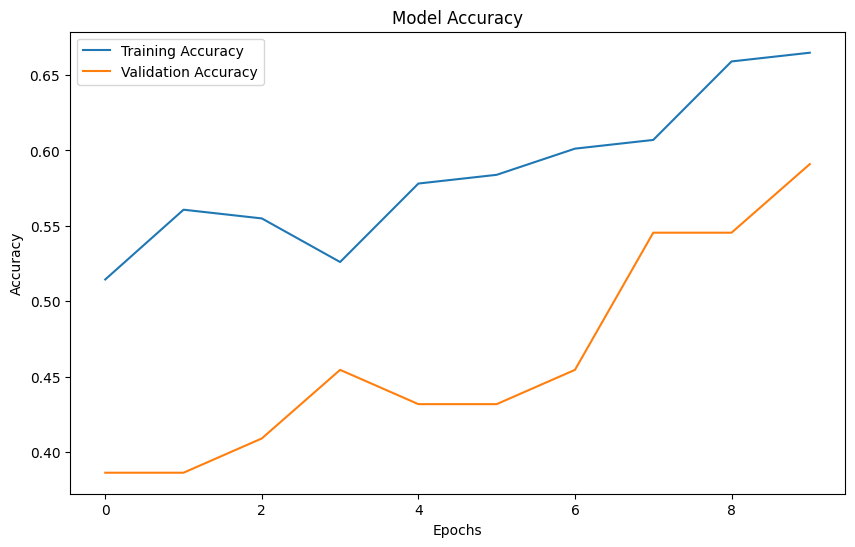

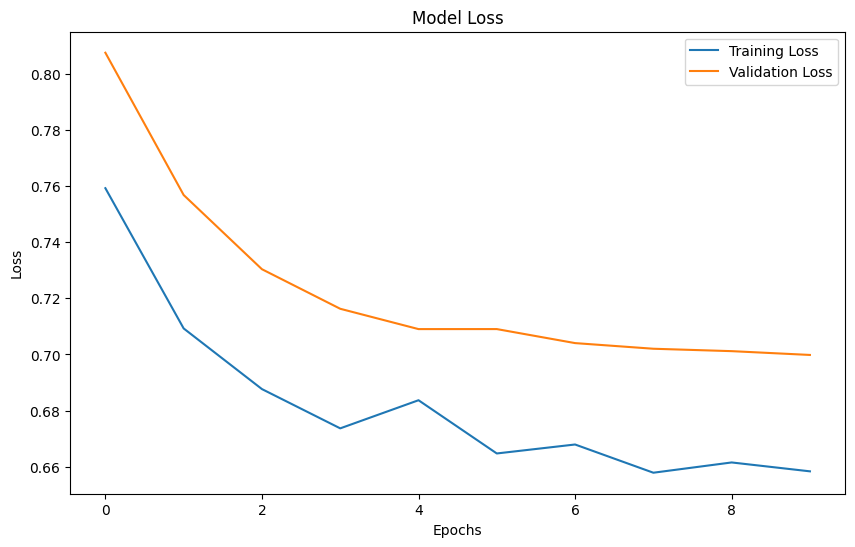

In [213]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping


scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

model = Sequential([
    Dense(32, activation='relu', input_shape=(X_train.shape[1],)),
    Dropout(0.2),  
    Dense(16, activation='relu'),
    Dense(1, activation='sigmoid')  
])

model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

early_stopping = EarlyStopping(patience=10, restore_best_weights=True)

history = model.fit(
    X_train, y_train,
    epochs=10,  
    batch_size=16,
    validation_split=0.2,
    callbacks=[early_stopping],
    verbose=1
)

test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=0)
print(f"Neural Network Test Accuracy: {test_accuracy:.2f}")

nn_predictions = (model.predict(X_test) > 0.5).astype(int)

print("Classification Report:")
print(classification_report(y_test, nn_predictions))

misclassified = np.where(y_test != nn_predictions.flatten())[0]
print(f"Misclassified Indexes: {misclassified}")
print(f"True Labels: {y_test.iloc[misclassified].values}")
print(f"Predicted Labels: {nn_predictions[misclassified].flatten()}")

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [214]:
from tensorflow.keras.layers import Conv1D, Flatten

X_train_cnn = X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_test_cnn = X_test.reshape(X_test.shape[0], X_test.shape[1], 1)

model = Sequential([
    Conv1D(32, kernel_size=3, activation='relu', input_shape=(X_train.shape[1], 1)),
    Dropout(0.2),
    Flatten(),
    Dense(16, activation='relu'),
    Dense(1, activation='sigmoid')
])

model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

history = model.fit(
    X_train_cnn, y_train,
    epochs=30,
    batch_size=16,
    validation_split=0.2,
    callbacks=[early_stopping],
    verbose=1
)

test_loss, test_accuracy = model.evaluate(X_test_cnn, y_test, verbose=0)
print(f"CNN Test Accuracy: {test_accuracy:.2f}")


Epoch 1/30


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.4723 - loss: 0.7005 - val_accuracy: 0.4545 - val_loss: 0.6985
Epoch 2/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5023 - loss: 0.6920 - val_accuracy: 0.4318 - val_loss: 0.6979
Epoch 3/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5339 - loss: 0.6893 - val_accuracy: 0.4318 - val_loss: 0.7004
Epoch 4/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5404 - loss: 0.6833 - val_accuracy: 0.4545 - val_loss: 0.7030
Epoch 5/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5084 - loss: 0.6871 - val_accuracy: 0.4545 - val_loss: 0.7009
Epoch 6/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6102 - loss: 0.6791 - val_accuracy: 0.4545 - val_loss: 0.6998
Epoch 7/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6434 - loss: 0.6710 - val_accuracy: 0.4773 - val_loss: 0.6979
Epoch 8/30
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5990 - loss: 0.6783 - val_accuracy: 0.4091 - val_loss: 0.6998
Ep

In [215]:
from xgboost import XGBClassifier

xgb_model = XGBClassifier(n_estimators=100, max_depth=3, learning_rate=0.1, random_state=42)
xgb_model.fit(X_train, y_train)

xgb_predictions = xgb_model.predict(X_test)
xgb_accuracy = accuracy_score(y_test, xgb_predictions)
print(f"XGBoost Accuracy: {xgb_accuracy:.2f}")


XGBoost Accuracy: 0.53


In [216]:
model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train.shape[1],)),
    Dropout(0.3),
    Dense(32, activation='relu'),
    Dropout(0.3),
    Dense(16, activation='relu'),
    Dense(1, activation='sigmoid')  
])

model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

history = model.fit(
    X_train, y_train,
    epochs=70,  
    batch_size=16,
    validation_split=0.2,
    callbacks=[early_stopping],
    verbose=1
)


Epoch 1/70


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


11/11 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.5176 - loss: 0.6895 - val_accuracy: 0.4091 - val_loss: 0.7187
Epoch 2/70
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.4975 - loss: 0.6971 - val_accuracy: 0.4545 - val_loss: 0.7186
Epoch 3/70
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.5380 - loss: 0.6982 - val_accuracy: 0.4091 - val_loss: 0.7141
Epoch 4/70
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.5480 - loss: 0.6878 - val_accuracy: 0.4545 - val_loss: 0.7178
Epoch 5/70
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6373 - loss: 0.6728 - val_accuracy: 0.4773 - val_loss: 0.7201
Epoch 6/70
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6085 - loss: 0.6732 - val_accuracy: 0.5000 - val_loss: 0.7188
Epoch 7/70
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5225 - loss: 0.6709 - val_accuracy: 0.4773 - val_loss: 0.7155
Epoch 8/70
11/11 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6454 - loss: 0.6751 - val_accuracy: 0.5227 - val_loss: 0.7032
Ep

### Testing on the test-set

In [217]:
safe_df_enssemble_smiles_04 = pd.read_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/results_smilesonly_enssemble_04.csv')

In [218]:
safe_df_enssemble_smiles_04.shape

(70, 5)

In [219]:
safe_df_enssemble_smiles_04['class_0'] = safe_df_enssemble_smiles_04['class_0'].apply(eval)
safe_df_enssemble_smiles_04['class_100'] = safe_df_enssemble_smiles_04['class_100'].apply(eval)

def count_majority(predictions):
    counts = pd.Series(predictions).value_counts()
    label_mapping = {"turbid": 0, "dissolved": 1}
    return label_mapping[counts.idxmax()]

safe_df_enssemble_smiles_04['class_0_label'] = safe_df_enssemble_smiles_04['class_0'].apply(count_majority)
safe_df_enssemble_smiles_04['class_100_label'] = safe_df_enssemble_smiles_04['class_100'].apply(count_majority)



In [220]:
safe_df_enssemble_smiles_04

,Unnamed: 0,Prompt,class_0,class_100,Answer,class_0_label,class_100_label
0,0,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",0,0,0
1,1,Is the mixture between (NCCN) and (O=Cc1ccc(-c...,"[turbid, dissolved, dissolved]","[dissolved, dissolved, dissolved]",0,1,1
2,2,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1,0,0
3,3,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"[turbid, turbid, turbid]","[turbid, dissolved, dissolved]",1,0,1
4,4,Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1,0,0
...,...,...,...,...,...,...,...
65,65,Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...,"[turbid, turbid, turbid]","[dissolved, dissolved, turbid]",0,0,1
66,66,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"[dissolved, turbid, turbid]","[dissolved, dissolved, turbid]",1,0,1
67,67,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1,0,0
68,68,Is the mixture between (NCC1CCC(CN)CC1) and (O...,"[turbid, turbid, turbid]","[turbid, turbid, dissolved]",1,0,0


In [221]:
def enhanced_features(row):
    combined_predictions = row['class_0'] + row['class_100']
    counts = pd.Series(combined_predictions).value_counts()
    return {
        "turbid_count": counts.get("turbid", 0),
        "dissolved_count": counts.get("dissolved", 0),
        "agreement": int(row['class_0_label'] == row['class_100_label']),
        "class_0_majority": row['class_0'].count("turbid") - row['class_0'].count("dissolved"),
        "class_100_majority": row['class_100'].count("turbid") - row['class_100'].count("dissolved"),
        "prompt_length": len(row['Prompt']),
    }


In [222]:
features_test = safe_df_enssemble_smiles_04.apply(enhanced_features, axis=1, result_type="expand")

In [223]:
features_test

,turbid_count,dissolved_count,agreement,class_0_majority,class_100_majority,prompt_length
0,6,0,1,3,3,112
1,1,5,1,-1,-3,111
2,6,0,1,3,3,110
3,4,2,0,3,-1,118
4,6,0,1,3,3,115
...,...,...,...,...,...,...
65,4,2,0,3,-1,90
66,3,3,0,1,-1,119
67,6,0,1,3,3,115
68,5,1,1,3,1,127


In [224]:
X_train

array([[-0.92386336,  0.92386336,  0.5547002 , -0.75606648, -0.95883775,
        -0.66934342],
       [ 1.18428122, -1.18428122,  0.5547002 ,  0.86962588,  1.32224565,
         1.06244662],
       [-1.34549228,  1.34549228,  0.5547002 , -1.56891266, -0.95883775,
         0.05689111],
       ...,
       [-0.08060553,  0.08060553, -1.80277564,  0.0567797 , -0.19847662,
         0.05689111],
       [ 0.7626523 , -0.7626523 ,  0.5547002 ,  0.86962588,  0.56188451,
         0.28034789],
       [ 1.18428122, -1.18428122,  0.5547002 ,  0.86962588,  1.32224565,
         0.78312564]])

In [225]:
features = scaler.transform(features.to_numpy())

print("Scaled Training Data Range:", X_train.min(axis=0), X_train.max(axis=0))
print("Scaled New Data Range:", features.min(axis=0), features.max(axis=0))



Scaled Training Data Range: [-1.34549228 -1.18428122 -1.80277564 -1.56891266 -0.95883775 -1.84249152] [1.18428122 1.34549228 0.5547002  0.86962588 1.32224565 3.24115022]
Scaled New Data Range: [-1.34549228 -1.18428122 -1.80277564 -1.56891266 -0.95883775 -1.84249152] [1.18428122 1.34549228 0.5547002  0.86962588 1.32224565 3.24115022]


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


In [226]:
X_train

array([[-0.92386336,  0.92386336,  0.5547002 , -0.75606648, -0.95883775,
        -0.66934342],
       [ 1.18428122, -1.18428122,  0.5547002 ,  0.86962588,  1.32224565,
         1.06244662],
       [-1.34549228,  1.34549228,  0.5547002 , -1.56891266, -0.95883775,
         0.05689111],
       ...,
       [-0.08060553,  0.08060553, -1.80277564,  0.0567797 , -0.19847662,
         0.05689111],
       [ 0.7626523 , -0.7626523 ,  0.5547002 ,  0.86962588,  0.56188451,
         0.28034789],
       [ 1.18428122, -1.18428122,  0.5547002 ,  0.86962588,  1.32224565,
         0.78312564]])

In [227]:
print("Shape of features passed to predict:", features.shape)
print("Shape of true labels:", safe_df_enssemble_smiles_04['Answer'].shape)


Shape of features passed to predict: (272, 6)
Shape of true labels: (70,)


### SVC on the test data

In [233]:
from sklearn.svm import SVC

svm_rbf = SVC(kernel='rbf', C=0.1, gamma=1, probability=True, random_state=42)
svm_rbf.fit(X_train, y_train)
rbf_predictions = svm_rbf.predict(X_test)
rbf_accuracy = accuracy_score(y_test, rbf_predictions)
print(f"SVM with RBF Kernel Accuracy: {rbf_accuracy:.2f}")

SVM with RBF Kernel Accuracy: 0.56


# New test

In [292]:
data_training_all = pd.read_csv('/Users/davidsegura/git/Leveraging_LLMs_causality/cage_SAD_llm/data/results_smilesonly_training_enssemble_04.csv')

In [293]:
data_training_all

,Unnamed: 0,Prompt,class_0,class_100,Answer
0,0,Is the mixture between (O=Cc1ccc(OCCCOc2ccc(C=...,"['dissolved', 'dissolved', 'dissolved']","['dissolved', 'dissolved', 'dissolved']",1
1,1,Is the mixture between (Cn1nc(-c2ccc(C=O)cc2)c...,"['turbid', 'turbid', 'turbid']","['dissolved', 'dissolved', 'dissolved']",0
2,2,Is the mixture between (O=Cc1cccc(C=O)c1) and ...,"['dissolved', 'dissolved', 'turbid']","['dissolved', 'dissolved', 'dissolved']",0
3,3,Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) ...,"['turbid', 'turbid', 'dissolved']","['dissolved', 'dissolved', 'dissolved']",0
4,4,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"['dissolved', 'dissolved', 'dissolved']","['dissolved', 'dissolved', 'dissolved']",1
...,...,...,...,...,...
267,267,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,"['turbid', 'turbid', 'turbid']","['turbid', 'turbid', 'turbid']",0
268,268,Is the mixture between (O=Cc1ccc2ccc3ccc(C=O)n...,"['turbid', 'turbid', 'turbid']","['dissolved', 'turbid', 'turbid']",0
269,269,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"['dissolved', 'turbid', 'dissolved']","['dissolved', 'turbid', 'dissolved']",1
270,270,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"['turbid', 'turbid', 'turbid']","['dissolved', 'turbid', 'turbid']",1


In [294]:
data_training_all['class_0'] = data_training_all['class_0'].apply(eval)
data_training_all['class_100'] = data_training_all['class_100'].apply(eval)


def count_majority(predictions):
    counts = pd.Series(predictions).value_counts()
    label_mapping = {"turbid": 0, "dissolved": 1}
    return label_mapping[counts.idxmax()]

data_training_all['class_0_label'] = data_training_all['class_0'].apply(count_majority)
data_training_all['class_100_label'] = data_training_all['class_100'].apply(count_majority)



In [295]:
data_training_all # training

,Unnamed: 0,Prompt,class_0,class_100,Answer,class_0_label,class_100_label
0,0,Is the mixture between (O=Cc1ccc(OCCCOc2ccc(C=...,"[dissolved, dissolved, dissolved]","[dissolved, dissolved, dissolved]",1,1,1
1,1,Is the mixture between (Cn1nc(-c2ccc(C=O)cc2)c...,"[turbid, turbid, turbid]","[dissolved, dissolved, dissolved]",0,0,1
2,2,Is the mixture between (O=Cc1cccc(C=O)c1) and ...,"[dissolved, dissolved, turbid]","[dissolved, dissolved, dissolved]",0,1,1
3,3,Is the mixture between (O=Cc1cc2sc(C=O)cc2s1) ...,"[turbid, turbid, dissolved]","[dissolved, dissolved, dissolved]",0,0,1
4,4,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"[dissolved, dissolved, dissolved]","[dissolved, dissolved, dissolved]",1,1,1
...,...,...,...,...,...,...,...
267,267,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",0,0,0
268,268,Is the mixture between (O=Cc1ccc2ccc3ccc(C=O)n...,"[turbid, turbid, turbid]","[dissolved, turbid, turbid]",0,0,0
269,269,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"[dissolved, turbid, dissolved]","[dissolved, turbid, dissolved]",1,1,1
270,270,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"[turbid, turbid, turbid]","[dissolved, turbid, turbid]",1,0,0


In [247]:
def enhanced_features(row):
    combined_predictions = row['class_0'] + row['class_100']
    counts = pd.Series(combined_predictions).value_counts()
    return {
        "turbid_count": counts.get("turbid", 0),
        "dissolved_count": counts.get("dissolved", 0),
        "agreement": int(row['class_0_label'] == row['class_100_label']),
        "class_0_majority": row['class_0'].count("turbid") - row['class_0'].count("dissolved"),
        "class_100_majority": row['class_100'].count("turbid") - row['class_100'].count("dissolved"),
        "prompt_length": len(row['Prompt']),
    }


In [248]:
features_training = data_training_all.apply(enhanced_features, axis=1, result_type="expand")

In [249]:
features_training = scaler.transform(features_training.to_numpy())
features_test = scaler.transform(features_test.to_numpy())

/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


In [250]:
from sklearn.svm import SVC

svm_rbf = SVC(kernel='rbf', C=10, gamma=0.3, probability=True, random_state=42)
svm_rbf.fit(features_training, data_training_all['Answer'])
rbf_predictions = svm_rbf.predict(features_test)
rbf_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], rbf_predictions)
print(f"SVM with RBF Kernel Accuracy: {rbf_accuracy:.2f}")

SVM with RBF Kernel Accuracy: 0.60


In [253]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(n_estimators=2000, max_depth=3, random_state=42)
rf.fit(features_training, data_training_all['Answer'])

rf_predictions = rf.predict(features_test)
rf_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], rf_predictions)
print(f"Random Forest Accuracy: {rf_accuracy:.2f}")


Random Forest Accuracy: 0.61


In [254]:
from sklearn.ensemble import GradientBoostingClassifier

gb = GradientBoostingClassifier(n_estimators=100, learning_rate=0.01, max_depth=3, random_state=42)
gb.fit(features_training, data_training_all['Answer'])

gb_predictions = gb.predict(features_test)
gb_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], gb_predictions)
print(f"Gradient Boosting Accuracy: {gb_accuracy:.2f}")


Gradient Boosting Accuracy: 0.63


In [260]:
from xgboost import XGBClassifier

xgb = XGBClassifier(n_estimators=10, learning_rate=0.1, max_depth=3, random_state=42, use_label_encoder=False, eval_metric='logloss')
xgb.fit(features_training, data_training_all['Answer'])

xgb_predictions = xgb.predict(features_test)
xgb_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], xgb_predictions)
print(f"XGBoost Accuracy: {xgb_accuracy:.2f}")


XGBoost Accuracy: 0.63


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/xgboost/core.py:158: UserWarning: [10:58:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


In [264]:
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression(max_iter=100, random_state=42)
lr.fit(features_training, data_training_all['Answer'])

lr_predictions = lr.predict(features_test)
lr_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], lr_predictions)
print(f"Logistic Regression Accuracy: {lr_accuracy:.2f}")


Logistic Regression Accuracy: 0.51


In [265]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=45)
knn.fit(features_training, data_training_all['Answer'])

knn_predictions = knn.predict(features_test)
knn_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], knn_predictions)
print(f"KNN Accuracy: {knn_accuracy:.2f}")


KNN Accuracy: 0.60


In [268]:
from sklearn.neural_network import MLPClassifier


mlp = MLPClassifier(hidden_layer_sizes=(128, 64), max_iter=1000, random_state=42)
mlp.fit(features_training, data_training_all['Answer'])

mlp_predictions = mlp.predict(features_test)
mlp_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], mlp_predictions)
print(f"MLP Neural Network Accuracy: {mlp_accuracy:.2f}")


MLP Neural Network Accuracy: 0.53


In [269]:
from sklearn.ensemble import AdaBoostClassifier

ada = AdaBoostClassifier(n_estimators=500, random_state=42)
ada.fit(features_training, data_training_all['Answer'])

ada_predictions = ada.predict(features_test)
ada_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], ada_predictions)
print(f"AdaBoost Accuracy: {ada_accuracy:.2f}")


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


AdaBoost Accuracy: 0.51


In [270]:
from lightgbm import LGBMClassifier

lgbm = LGBMClassifier(n_estimators=100, learning_rate=0.01, max_depth=15, random_state=42)
lgbm.fit(features_training, data_training_all['Answer'])

lgbm_predictions = lgbm.predict(features_test)
lgbm_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], lgbm_predictions)
print(f"LightGBM Accuracy: {lgbm_accuracy:.2f}")


[LightGBM] [Info] Number of positive: 145, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000324 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 78
[LightGBM] [Info] Number of data points in the train set: 272, number of used features: 6
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.533088 -> initscore=0.132547
[LightGBM] [Info] Start training from score 0.132547
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

In [271]:
from catboost import CatBoostClassifier

catboost = CatBoostClassifier(iterations=100, learning_rate=0.01, depth=3, verbose=0, random_state=42)
catboost.fit(features_training, data_training_all['Answer'])

catboost_predictions = catboost.predict(features_test)
catboost_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], catboost_predictions)
print(f"CatBoost Accuracy: {catboost_accuracy:.2f}")


CatBoost Accuracy: 0.64


In [287]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV

param_grid = {
    'iterations': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.3],
    'depth': [3, 5, 7],
    'l2_leaf_reg': [1, 3, 5],
}

catboost = CatBoostClassifier(verbose=0, random_state=42)

grid_search = GridSearchCV(catboost, param_grid, cv=5, scoring='accuracy')
grid_search.fit(features_training, data_training_all['Answer'])

print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Cross-Validation Accuracy: {grid_search.best_score_:.2f}")


Best Parameters: {'depth': 3, 'iterations': 500, 'l2_leaf_reg': 3, 'learning_rate': 0.01}
Best Cross-Validation Accuracy: 0.68


In [286]:
from catboost import CatBoostClassifier
from sklearn.metrics import accuracy_score, classification_report

best_catboost = CatBoostClassifier(
    depth=3,
    iterations=500,
    l2_leaf_reg=3,
    learning_rate=0.001,
    random_state=42,
    verbose=0
)

best_catboost.fit(features_training, data_training_all['Answer'])

catboost_test_predictions = best_catboost.predict(features_test)
catboost_test_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], catboost_test_predictions)

print(f"CatBoost Test Accuracy: {catboost_test_accuracy:.2f}")

print("Classification Report for CatBoost on Test Set:")
print(classification_report(safe_df_enssemble_smiles_04['Answer'], catboost_test_predictions))


CatBoost Test Accuracy: 0.64
Classification Report for CatBoost on Test Set:
              precision    recall  f1-score   support

           0       0.64      0.66      0.65        35
           1       0.65      0.63      0.64        35

    accuracy                           0.64        70
   macro avg       0.64      0.64      0.64        70
weighted avg       0.64      0.64      0.64        70



In [306]:
catboost_test_predictions = best_catboost.predict(features_test)

safe_df_enssemble_smiles_04['cat_boost'] = catboost_test_predictions

safe_df_enssemble_smiles_04['cat_boost'] = safe_df_enssemble_smiles_04.apply(
    lambda row: row['class_100_label'] if row['class_0'] == row['class_100'] else row['cat_boost'],
    axis=1
)

safe_df_enssemble_smiles_04

catboost_answer_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['cat_boost'])

print(f"Accuracy between 'cat_boost' and 'Answer': {catboost_answer_accuracy:.2f}")



Accuracy between 'cat_boost' and 'Answer': 0.53


In [308]:
changes_class_0 = 0
changes_class_100 = 0

for i, row in safe_df_enssemble_smiles_04.iterrows():
    if row['class_0_label'] != catboost_test_predictions[i]:
        changes_class_0 += 1
        
    if row['class_100_label'] != catboost_test_predictions[i]:
        changes_class_100 += 1

print(f"Number of changes compared to class_0_label: {changes_class_0}")
print(f"Number of changes compared to class_100_label: {changes_class_100}")


Number of changes compared to class_0_label: 40
Number of changes compared to class_100_label: 42


In [310]:
changes_class_0 = 0
changes_class_100 = 0
changes_when_agree = 0  

for i, row in safe_df_enssemble_smiles_04.iterrows():
    if row['class_0_label'] != catboost_test_predictions[i]:
        changes_class_0 += 1
        
    if row['class_100_label'] != catboost_test_predictions[i]:
        changes_class_100 += 1
    
    if row['class_0_label'] == row['class_100_label']:
        if row['class_0_label'] != catboost_test_predictions[i]:
            changes_when_agree += 1

print(f"Number of changes compared to class_0_label: {changes_class_0}")
print(f"Number of changes compared to class_100_label: {changes_class_100}")
print(f"Number of changes when class_0_label and class_100_label agree: {changes_when_agree}")


Number of changes compared to class_0_label: 40
Number of changes compared to class_100_label: 42
Number of changes when class_0_label and class_100_label agree: 31


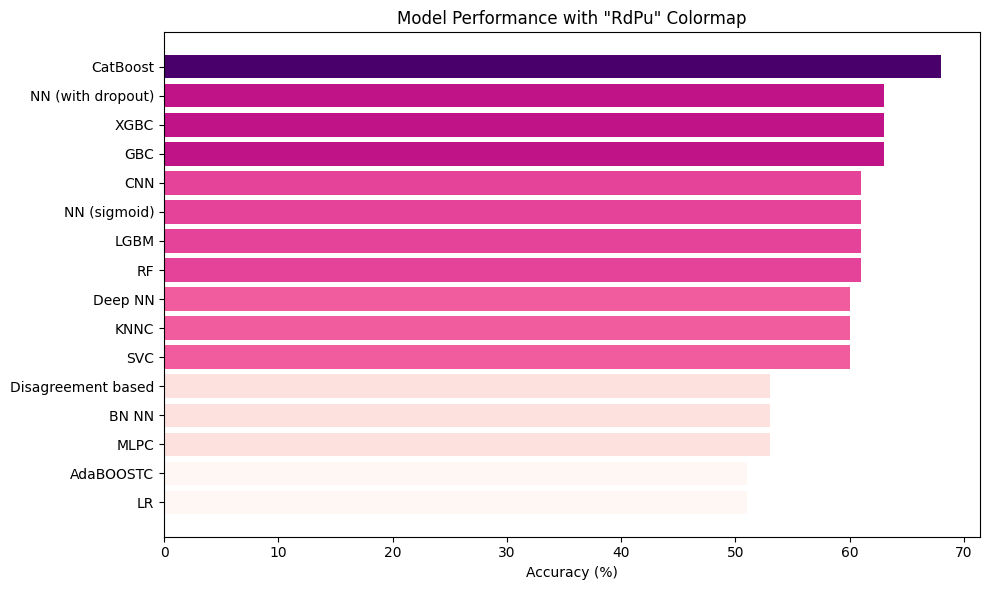

In [320]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import matplotlib.colors as mcolors

models = [
    "SVC", "RF", "GBC", "XGBC", "LR", "KNNC", "MLPC", "AdaBOOSTC", 
    "LGBM", "CatBoost", "NN (sigmoid)", "NN (with dropout)", 
    "BN NN", "Deep NN", "CNN", "Disagreement based"
]
percentages = [60, 61, 63, 63, 51, 60, 53, 51, 61, 68, 61, 63, 53, 60, 61, 53]

data = pd.DataFrame({
    'Model': models,
    'Accuracy': percentages
})

data = data.sort_values(by="Accuracy", ascending=True)

cmap = plt.cm.RdPu

norm = mcolors.Normalize(vmin=min(data['Accuracy']), vmax=max(data['Accuracy']))

plt.figure(figsize=(10, 6))
bars = plt.barh(data['Model'], data['Accuracy'], color=cmap(norm(data['Accuracy'])))

plt.xlabel('Accuracy (%)')
plt.title('Model Performance with "RdPu" Colormap')

plt.tight_layout()
plt.show()


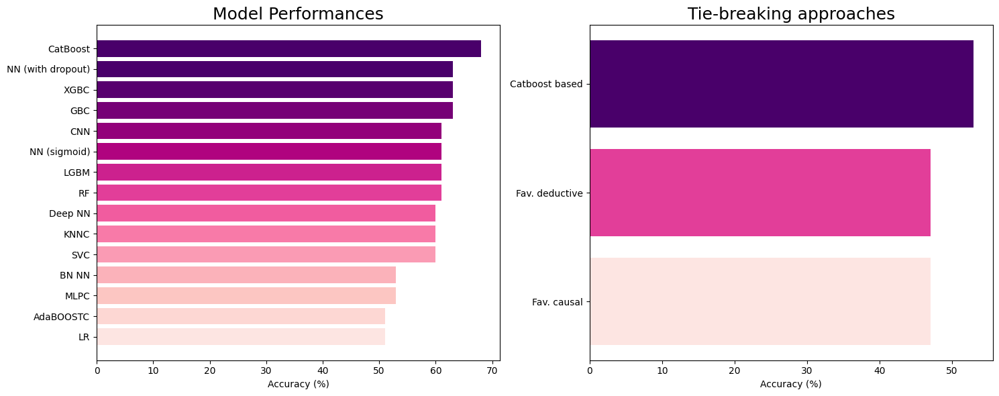

In [329]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

models_1 = [
    "SVC", "RF", "GBC", "XGBC", "LR", "KNNC", "MLPC", "AdaBOOSTC", 
    "LGBM", "CatBoost", "NN (sigmoid)", "NN (with dropout)", 
    "BN NN", "Deep NN", "CNN"
]
percentages_1 = [60, 61, 63, 63, 51, 60, 53, 51, 61, 68, 61, 63, 53, 60, 61]

models_2 = ["Catboost based", "Fav. causal", "Fav. deductive"]
percentages_2 = [53, 47, 47]

data_1 = pd.DataFrame({
    'Model': models_1,
    'Accuracy': percentages_1
})

data_2 = pd.DataFrame({
    'Model': models_2,
    'Accuracy': percentages_2
})

data_1 = data_1.sort_values(by="Accuracy", ascending=True)
data_2 = data_2.sort_values(by="Accuracy", ascending=True)

fig, axs = plt.subplots(1, 2, figsize=(15, 6))

cmap = plt.cm.RdPu

norm_1 = plt.Normalize(vmin=data_1['Accuracy'].min(), vmax=data_1['Accuracy'].max())
norm_2 = plt.Normalize(vmin=data_2['Accuracy'].min(), vmax=data_2['Accuracy'].max())

shifted_cmap_1 = cmap(np.linspace(0, 1, len(data_1)) + 0.1)  # Shift by +0.1
shifted_cmap_2 = cmap(np.linspace(0, 1, len(data_2)) + 0.1)  # Shift by +0.1

axs[0].barh(data_1['Model'], data_1['Accuracy'], color=shifted_cmap_1)
axs[0].set_xlabel('Accuracy (%)')
axs[0].set_title('Model Performances', size = 18)

axs[1].barh(data_2['Model'], data_2['Accuracy'], color=shifted_cmap_2)
axs[1].set_xlabel('Accuracy (%)')
axs[1].set_title('Tie-breaking approaches', size = 18)

plt.tight_layout()
plt.show()


In [274]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score

xscaler = StandardScaler()
features_training_scaled = scaler.fit_transform(features_training)
features_test_scaled = scaler.transform(features_test)

basic_nn = Sequential([
    Dense(32, activation='relu', input_shape=(features_training_scaled.shape[1],)),
    Dense(16, activation='relu'),
    Dense(1, activation='sigmoid')
])

basic_nn.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

xbasic_nn.fit(features_training_scaled, data_training_all['Answer'], epochs=20, batch_size=16, verbose=0)

basic_nn_predictions = (basic_nn.predict(features_test_scaled) > 0.5).astype(int)
basic_nn_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], basic_nn_predictions)
print(f"Basic NN Accuracy: {basic_nn_accuracy:.2f}")


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Basic NN Accuracy: 0.61


In [275]:
from tensorflow.keras.layers import Dropout

dropout_nn = Sequential([
    Dense(64, activation='relu', input_shape=(features_training_scaled.shape[1],)),
    Dropout(0.3),
    Dense(32, activation='relu'),
    Dropout(0.3),
    Dense(1, activation='sigmoid')
])

dropout_nn.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

dropout_nn.fit(features_training_scaled, data_training_all['Answer'], epochs=20, batch_size=16, verbose=0)

dropout_nn_predictions = (dropout_nn.predict(features_test_scaled) > 0.5).astype(int)
dropout_nn_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], dropout_nn_predictions)
print(f"Dropout NN Accuracy: {dropout_nn_accuracy:.2f}")


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


2/3 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/steppWARNING:tensorflow:6 out of the last 8 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x31f840b80> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
Dropout NN Accuracy: 0.63


In [276]:
from tensorflow.keras.layers import BatchNormalization

batchnorm_nn = Sequential([
    Dense(64, activation='relu', input_shape=(features_training_scaled.shape[1],)),
    BatchNormalization(),
    Dense(32, activation='relu'),
    BatchNormalization(),
    Dense(1, activation='sigmoid')
])

batchnorm_nn.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

batchnorm_nn.fit(features_training_scaled, data_training_all['Answer'], epochs=20, batch_size=16, verbose=0)

batchnorm_nn_predictions = (batchnorm_nn.predict(features_test_scaled) > 0.5).astype(int)
batchnorm_nn_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], batchnorm_nn_predictions)
print(f"Batch Normalization NN Accuracy: {batchnorm_nn_accuracy:.2f}")


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Batch Normalization NN Accuracy: 0.53


In [277]:
deep_nn = Sequential([
    Dense(128, activation='relu', input_shape=(features_training_scaled.shape[1],)),
    Dense(64, activation='relu'),
    Dense(32, activation='relu'),
    Dense(1, activation='sigmoid')
])

deep_nn.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

deep_nn.fit(features_training_scaled, data_training_all['Answer'], epochs=30, batch_size=16, verbose=0)

deep_nn_predictions = (deep_nn.predict(features_test_scaled) > 0.5).astype(int)
deep_nn_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], deep_nn_predictions)
print(f"Deep NN Accuracy: {deep_nn_accuracy:.2f}")


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
Deep NN Accuracy: 0.60


In [278]:
from tensorflow.keras.layers import Conv1D, Flatten, Reshape

features_training_cnn = features_training_scaled.reshape((features_training_scaled.shape[0], features_training_scaled.shape[1], 1))
features_test_cnn = features_test_scaled.reshape((features_test_scaled.shape[0], features_test_scaled.shape[1], 1))

cnn_model = Sequential([
    Conv1D(32, kernel_size=2, activation='relu', input_shape=(features_training_scaled.shape[1], 1)),
    Flatten(),
    Dense(64, activation='relu'),
    Dense(1, activation='sigmoid')
])

cnn_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

cnn_model.fit(features_training_cnn, data_training_all['Answer'], epochs=20, batch_size=16, verbose=0)

cnn_predictions = (cnn_model.predict(features_test_cnn) > 0.5).astype(int)
cnn_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], cnn_predictions)
print(f"CNN Accuracy: {cnn_accuracy:.2f}")


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
CNN Accuracy: 0.61


# Pipeline to improve with ensemble approach

In [427]:
safe_df_enssemble_smiles_04

,Unnamed: 0,Prompt,class_0,class_100,Answer,class_0_label,class_100_label,class_0_consistent,class_100_consistent,final_label,resolution_method,class_0_majority_label,class_100_majority_label,model_based_label
0,0,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",0,0,0,True,True,0,class_100_consistent,0,0,0
1,1,Is the mixture between (NCCN) and (O=Cc1ccc(-c...,"[turbid, dissolved, dissolved]","[dissolved, dissolved, dissolved]",0,1,1,False,True,1,class_100_consistent,1,1,1
2,2,Is the mixture between (N[C@H]1CN(Cc2ccccc2)C[...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1,0,0,True,True,0,class_100_consistent,0,0,0
3,3,Is the mixture between (NCc1ccc(CN)cc1) and (O...,"[turbid, turbid, turbid]","[turbid, dissolved, dissolved]",1,0,1,True,False,0,catboost,0,1,1
4,4,Is the mixture between (N[C@H]1CC[C@H](N)CC1) ...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1,0,0,True,True,0,class_100_consistent,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,65,Is the mixture between (Cn1nc2c(C=O)cccc2c1C=O...,"[turbid, turbid, turbid]","[dissolved, dissolved, turbid]",0,0,1,True,False,0,catboost,0,1,1
66,66,Is the mixture between (CN(CCCN)CCCN) and (O=C...,"[dissolved, turbid, turbid]","[dissolved, dissolved, turbid]",1,0,1,False,False,1,catboost,0,1,1
67,67,Is the mixture between (NCC(CN)O) and (O=Cc1cc...,"[turbid, turbid, turbid]","[turbid, turbid, turbid]",1,0,0,True,True,0,class_100_consistent,0,0,0
68,68,Is the mixture between (NCC1CCC(CN)CC1) and (O...,"[turbid, turbid, turbid]","[turbid, turbid, dissolved]",1,0,0,True,False,0,catboost,0,0,1


In [279]:
consistent_agreement = safe_df_enssemble_smiles_04[
    (safe_df_enssemble_smiles_04['class_0'].apply(lambda x: len(set(x)) == 1)) &  # All predictions in class_0 are the same
    (safe_df_enssemble_smiles_04['class_100'].apply(lambda x: len(set(x)) == 1)) &  # All predictions in class_100 are the same
    (safe_df_enssemble_smiles_04['class_0'].apply(lambda x: x[0]) == safe_df_enssemble_smiles_04['class_100'].apply(lambda x: x[0]))  # class_0 matches class_100
]

total_consistent_agreement = len(consistent_agreement)

correctly_classified = consistent_agreement[
    consistent_agreement['class_0_label'] == consistent_agreement['Answer']
].shape[0]

print(f"Total instances where class_0 and class_100 are consistent and agree: {total_consistent_agreement}")
print(f"Correctly classified instances: {correctly_classified}")


Total instances where class_0 and class_100 are consistent and agree: 36
Correctly classified instances: 17


In [280]:
from catboost import CatBoostClassifier
from sklearn.metrics import accuracy_score, classification_report
import pandas as pd

best_catboost = CatBoostClassifier(
    depth=3,
    iterations=100,
    l2_leaf_reg=3,
    learning_rate=0.01,
    random_state=42,
    verbose=0
)

best_catboost.fit(features_training, data_training_all['Answer'])

def resolve_labels_catboost_priority_class_100(row, model):
    if len(set(row['class_100'])) == 1:
x        label_mapping = {"turbid": 0, "dissolved": 1}
        agreed_label = row['class_100'][0] 
        return label_mapping[agreed_label]
    else:
        class_0_turbid = row['class_0'].count("turbid")
        class_0_dissolved = row['class_0'].count("dissolved")
        class_100_turbid = row['class_100'].count("turbid")
        class_100_dissolved = row['class_100'].count("dissolved")
        
        total_turbid = class_0_turbid + class_100_turbid
        total_dissolved = class_0_dissolved + class_100_dissolved
        
        if total_turbid == total_dissolved:
            features = {
                "turbid_count": total_turbid,
                "dissolved_count": total_dissolved,
                "agreement": 0,  
                "class_0_majority": class_0_turbid - class_0_dissolved,
                "class_100_majority": class_100_turbid - class_100_dissolved,
                "prompt_length": len(row['Prompt']),
            }
            features_df = pd.DataFrame([features])
           
            return int(model.predict(features_df)[0])  
        else:

            label_mapping = {"turbid": 0, "dissolved": 1}
            majority_label = "turbid" if total_turbid > total_dissolved else "dissolved"
            return label_mapping[majority_label]


safe_df_enssemble_smiles_04['final_label'] = safe_df_enssemble_smiles_04.apply(
    resolve_labels_catboost_priority_class_100, axis=1, model=best_catboost
)

pipeline_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['final_label'])
print(f"Pipeline Accuracy with CatBoost (Priority Class_100): {pipeline_accuracy:.2f}")

print("Classification Report for the Pipeline with CatBoost (Priority Class_100):")
print(classification_report(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['final_label']))


Pipeline Accuracy with CatBoost (Priority Class_100): 0.49
Classification Report for the Pipeline with CatBoost (Priority Class_100):
              precision    recall  f1-score   support

           0       0.48      0.46      0.47        35
           1       0.49      0.51      0.50        35

    accuracy                           0.49        70
   macro avg       0.49      0.49      0.49        70
weighted avg       0.49      0.49      0.49        70



In [281]:
from sklearn.metrics import accuracy_score, classification_report

def majority_label(class_predictions):
    label_mapping = {"turbid": 0, "dissolved": 1}
    counts = pd.Series(class_predictions).value_counts()
    return label_mapping[counts.idxmax()]

safe_df_enssemble_smiles_04['class_0_majority_label'] = safe_df_enssemble_smiles_04['class_0'].apply(majority_label)
class_0_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['class_0_majority_label'])
print(f"Accuracy using only class_0: {class_0_accuracy:.2f}")
print(f"Predictions using only class_0:\n{safe_df_enssemble_smiles_04['class_0_majority_label'].tolist()}")

safe_df_enssemble_smiles_04['class_100_majority_label'] = safe_df_enssemble_smiles_04['class_100'].apply(majority_label)
class_100_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['class_100_majority_label'])
print(f"Accuracy using only class_100: {class_100_accuracy:.2f}")
print(f"Predictions using only class_100:\n{safe_df_enssemble_smiles_04['class_100_majority_label'].tolist()}")

def resolve_labels_model_based(row, model):
    if set(row['class_0']) == set(row['class_100']) and len(set(row['class_0'])) == 1:
        label_mapping = {"turbid": 0, "dissolved": 1}
        return label_mapping[row['class_0'][0]]
    else:
        features = {
            "turbid_count": row['class_0'].count("turbid") + row['class_100'].count("turbid"),
            "dissolved_count": row['class_0'].count("dissolved") + row['class_100'].count("dissolved"),
            "agreement": int(set(row['class_0']) == set(row['class_100'])),
            "class_0_majority": row['class_0'].count("turbid") - row['class_0'].count("dissolved"),
            "class_100_majority": row['class_100'].count("turbid") - row['class_100'].count("dissolved"),
            "prompt_length": len(row['Prompt']),
        }
        features_df = pd.DataFrame([features])
       
        features_scaled = scaler.transform(features_df)

        return int(model.predict(features_scaled)[0])

safe_df_enssemble_smiles_04['model_based_label'] = safe_df_enssemble_smiles_04.apply(
    resolve_labels_model_based, axis=1, model=best_catboost
)

model_based_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['model_based_label'])
print(f"Accuracy using model-based pipeline: {model_based_accuracy:.2f}")
print(f"Predictions using model-based pipeline:\n{safe_df_enssemble_smiles_04['model_based_label'].tolist()}")

def model_only_prediction(row, model):
    features = {
        "turbid_count": row['class_0'].count("turbid") + row['class_100'].count("turbid"),
        "dissolved_count": row['class_0'].count("dissolved") + row['class_100'].count("dissolved"),
        "agreement": int(set(row['class_0']) == set(row['class_100'])),
        "class_0_majority": row['class_0'].count("turbid") - row['class_0'].count("dissolved"),
        "class_100_majority": row['class_100'].count("turbid") - row['class_100'].count("dissolved"),
        "prompt_length": len(row['Prompt']),
    }
    features_df = pd.DataFrame([features])
    features_scaled = scaler.transform(features_df)
    return int(model.predict(features_scaled)[0])

safe_df_enssemble_smiles_04['model_only_label'] = safe_df_enssemble_smiles_04.apply(
    model_only_prediction, axis=1, model=best_catboost
)

model_only_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['model_only_label'])
print(f"Accuracy using only the model: {model_only_accuracy:.2f}")
print(f"Predictions using only the model:\n{safe_df_enssemble_smiles_04['model_only_label'].tolist()}")
print("Classification Report for Model-Based Pipeline:")
print(classification_report(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['model_based_label']))

print("Classification Report for Model-Only Predictions:")
print(classification_report(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['model_only_label']))


Accuracy using only class_0: 0.47
Predictions using only class_0:
[0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1]
Accuracy using only class_100: 0.47
Predictions using only class_100:
[0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1]
Accuracy using model-based pipeline: 0.47
Predictions using model-based pipeline:
[0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Accuracy using only the model: 0.50
Predictions using only the model:
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/m

In [282]:
from sklearn.metrics import accuracy_score, classification_report

def majority_label(class_predictions):
    label_mapping = {"turbid": 0, "dissolved": 1}
    counts = pd.Series(class_predictions).value_counts()
    return label_mapping[counts.idxmax()]

safe_df_enssemble_smiles_04['class_0_majority_label'] = safe_df_enssemble_smiles_04['class_0'].apply(majority_label)
class_0_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['class_0_majority_label'])
print(f"Accuracy using only class_0: {class_0_accuracy:.2f}")
print("Predictions using only class_0:")
print(safe_df_enssemble_smiles_04['class_0_majority_label'].tolist())

safe_df_enssemble_smiles_04['class_100_majority_label'] = safe_df_enssemble_smiles_04['class_100'].apply(majority_label)
class_100_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['class_100_majority_label'])
print(f"Accuracy using only class_100: {class_100_accuracy:.2f}")
print("Predictions using only class_100:")
print(safe_df_enssemble_smiles_04['class_100_majority_label'].tolist())

def resolve_labels_model_based(row, model):
    if set(row['class_0']) == set(row['class_100']) and len(set(row['class_0'])) == 1:
        label_mapping = {"turbid": 0, "dissolved": 1}
        return label_mapping[row['class_0'][0]]
    else:
        features = {
            "turbid_count": row['class_0'].count("turbid") + row['class_100'].count("turbid"),
            "dissolved_count": row['class_0'].count("dissolved") + row['class_100'].count("dissolved"),
            "agreement": int(set(row['class_0']) == set(row['class_100'])),
            "class_0_majority": row['class_0'].count("turbid") - row['class_0'].count("dissolved"),
            "class_100_majority": row['class_100'].count("turbid") - row['class_100'].count("dissolved"),
            "prompt_length": len(row['Prompt']),
        }
        features_df = pd.DataFrame([features])
       
        features_scaled = scaler.transform(features_df)

        return int(model.predict(features_scaled)[0])

safe_df_enssemble_smiles_04['model_based_label'] = safe_df_enssemble_smiles_04.apply(
    resolve_labels_model_based, axis=1, model=best_catboost
)

model_based_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['model_based_label'])
print(f"Accuracy using model-based pipeline: {model_based_accuracy:.2f}")
print("Predictions using model-based pipeline:")
print(safe_df_enssemble_smiles_04['model_based_label'].tolist())

print("Classification Report for Model-Based Pipeline:")
print(classification_report(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['model_based_label']))


Accuracy using only class_0: 0.47
Predictions using only class_0:
[0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1]
Accuracy using only class_100: 0.47
Predictions using only class_100:
[0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1]
Accuracy using model-based pipeline: 0.47
Predictions using model-based pipeline:
[0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1]
Classification Report for Model-Based Pipeline:
              precision    recall  f1-score   support

           0       0.45      0.26      0.33   

/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/m

In [283]:
from catboost import CatBoostClassifier
from sklearn.metrics import accuracy_score, classification_report
import pandas as pd

from sklearn.preprocessing import StandardScaler

best_catboost = CatBoostClassifier(
    depth=3,
    iterations=100,
    l2_leaf_reg=3,
    learning_rate=0.01,
    random_state=42,
    verbose=0
)

best_catboost.fit(features_training, data_training_all['Answer'])

def resolve_labels_catboost_priority_class_100(row, model, scaler):
    if len(set(row['class_100'])) == 1:
        label_mapping = {"turbid": 0, "dissolved": 1}
        agreed_label = row['class_100'][0]  
        return label_mapping[agreed_label]
    else:
        class_0_turbid = row['class_0'].count("turbid")
        class_0_dissolved = row['class_0'].count("dissolved")
        class_100_turbid = row['class_100'].count("turbid")
        class_100_dissolved = row['class_100'].count("dissolved")
        
        total_turbid = class_0_turbid + class_100_turbid
        total_dissolved = class_0_dissolved + class_100_dissolved
        
        if total_turbid == total_dissolved:
            features = {
                "turbid_count": total_turbid,
                "dissolved_count": total_dissolved,
                "agreement": 0, 
                "class_0_majority": class_0_turbid - class_0_dissolved,
                "class_100_majority": class_100_turbid - class_100_dissolved,
                "prompt_length": len(row['Prompt']),
            }
            features_df = pd.DataFrame([features])
            features_scaled = scaler.transform(features_df)
            return int(model.predict(features_scaled)[0]) 
        else:
            label_mapping = {"turbid": 0, "dissolved": 1}
            majority_label = "turbid" if total_turbid > total_dissolved else "dissolved"
            return label_mapping[majority_label]

safe_df_enssemble_smiles_04['final_label'] = safe_df_enssemble_smiles_04.apply(
    lambda row: resolve_labels_catboost_priority_class_100(row, best_catboost, scaler), axis=1
)

pipeline_accuracy = accuracy_score(safe_df_enssemble_smiles_04['Answer'], safe_df_enssemble_smiles_04['final_label'])
print(f"Pipeline Accuracy with CatBoost (Priority Class_100): {pipeline_accuracy:.2f}")



Pipeline Accuracy with CatBoost (Priority Class_100): 0.49


/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(
/Users/davidsegura/miniconda3/envs/env_cage/lib/python3.9/site-packages/sklearn/base.py:486: UserWarning: X has feature names, but StandardScaler was fitted without feature names
  warnings.warn(


# Assessing the accuracies for enssemble approach

for the smiles

In [514]:
import pandas as pd

def majority_class(predictions):
    counts = pd.Series(predictions).value_counts()
    if counts.get("turbid", 0) > counts.get("dissolved", 0):
        return 0
    else:
        return 1

safe_df_enssemble_smiles_04['class_0_prediction'] = safe_df_enssemble_smiles_04['class_0'].apply(majority_class)
safe_df_enssemble_smiles_04['class_100_prediction'] = safe_df_enssemble_smiles_04['class_100'].apply(majority_class)

class_0_accuracy = (safe_df_enssemble_smiles_04['class_0_prediction'] == safe_df_enssemble_smiles_04['Answer']).mean()
class_100_accuracy = (safe_df_enssemble_smiles_04['class_100_prediction'] == safe_df_enssemble_smiles_04['Answer']).mean()

def ensemble_majority(row):
    combined = row['class_0'] + row['class_100']  
    return majority_class(combined)

safe_df_enssemble_smiles_04['ensemble_prediction'] = safe_df_enssemble_smiles_04.apply(ensemble_majority, axis=1)

ensemble_accuracy = (safe_df_enssemble_smiles_04['ensemble_prediction'] == safe_df_enssemble_smiles_04['Answer']).mean()

print(f"Accuracy for class_0: {class_0_accuracy:.2f}")
print(f"Accuracy for class_100: {class_100_accuracy:.2f}")
print(f"Ensemble accuracy: {ensemble_accuracy:.2f}")

def ensemble_majority_with_tiebreak(row):
    combined = row['class_0'] + row['class_100']  
    counts_combined = pd.Series(combined).value_counts()
    
    turbid_count = counts_combined.get("turbid", 0)
    dissolved_count = counts_combined.get("dissolved", 0)
    
    if turbid_count > dissolved_count:
        return 0  
    elif dissolved_count > turbid_count:
        return 1  
    else:
        
        counts_class_100 = pd.Series(row['class_100']).value_counts()
        if counts_class_100.get("turbid", 0) > counts_class_100.get("dissolved", 0):
            return 0 
        else:
            return 1 

safe_df_enssemble_smiles_04['ensemble_prediction_tiebreak'] = safe_df_enssemble_smiles_04.apply(ensemble_majority_with_tiebreak, axis=1)

ensemble_tiebreak_accuracy = (safe_df_enssemble_smiles_04['ensemble_prediction_tiebreak'] == safe_df_enssemble_smiles_04['Answer']).mean()

print(f"Ensemble accuracy with tie-breaking: {ensemble_tiebreak_accuracy:.2f}")


Accuracy for class_0: 0.47
Accuracy for class_100: 0.47
Ensemble accuracy: 0.49
Ensemble accuracy with tie-breaking: 0.47


In [497]:
import pandas as pd

def majority_class(predictions):
    counts = pd.Series(predictions).value_counts()
    if counts.get("turbid", 0) > counts.get("dissolved", 0):
        return 0
    else:
        return 1

safe_df_enssemble_smiles['class_0_prediction'] = safe_df_enssemble_smiles['class_0'].apply(majority_class)
safe_df_enssemble_smiles['class_100_prediction'] = safe_df_enssemble_smiles['class_100'].apply(majority_class)

class_0_accuracy = (safe_df_enssemble_smiles['class_0_prediction'] == safe_df_enssemble_smiles['Answer']).mean()
class_100_accuracy = (safe_df_enssemble_smiles['class_100_prediction'] == safe_df_enssemble_smiles['Answer']).mean()

def ensemble_majority(row):
    combined = row['class_0'] + row['class_100'] 
    return majority_class(combined)

safe_df_enssemble_smiles['ensemble_prediction'] = safe_df_enssemble_smiles.apply(ensemble_majority, axis=1)

ensemble_accuracy = (safe_df_enssemble_smiles['ensemble_prediction'] == safe_df_enssemble_smiles['Answer']).mean()

print(f"Accuracy for class_0: {class_0_accuracy:.2f}")
print(f"Accuracy for class_100: {class_100_accuracy:.2f}")
print(f"Ensemble accuracy: {ensemble_accuracy:.2f}")

def ensemble_majority_with_tiebreak(row):
    combined = row['class_0'] + row['class_100']  
    counts_combined = pd.Series(combined).value_counts()
    
    turbid_count = counts_combined.get("turbid", 0)
    dissolved_count = counts_combined.get("dissolved", 0)
    
    if turbid_count > dissolved_count:
        return 0  
    elif dissolved_count > turbid_count:
        return 1  
    else:
        
        counts_class_100 = pd.Series(row['class_100']).value_counts()
        if counts_class_100.get("turbid", 0) > counts_class_100.get("dissolved", 0):
            return 0  
        else:
            return 1 

safe_df_enssemble_smiles['ensemble_prediction_tiebreak'] = safe_df_enssemble_smiles.apply(ensemble_majority_with_tiebreak, axis=1)

ensemble_tiebreak_accuracy = (safe_df_enssemble_smiles['ensemble_prediction_tiebreak'] == safe_df_enssemble_smiles['Answer']).mean()

print(f"Ensemble accuracy with tie-breaking: {ensemble_tiebreak_accuracy:.2f}")


Accuracy for class_0: 0.50
Accuracy for class_100: 0.46
Ensemble accuracy: 0.50
Ensemble accuracy with tie-breaking: 0.50


In [376]:
from scipy.stats import mode

accuracies = {}

temperatures = [0.1]

ground_truth = test_df["Answer"].head(1)

assert len(final_df) == len(test_df.head(1)), "Mismatch in number of rows between final_df and test_df"
assert (final_df.index == test_df.head(1).index).all(), "Index mismatch between final_df and test_df"

for temp in temperatures:
    focus_0_preds = final_df["Focus 0% Predictions"].apply(lambda x: x[temp])
    focus_100_preds = final_df["Focus 100% Predictions"].apply(lambda x: x[temp])

    print(f"Temperature: {temp}")
    print("Focus 0% Predictions (First Row):", focus_0_preds.iloc[0])
    print("Focus 100% Predictions (First Row):", focus_100_preds.iloc[0])

    focus_0_majority = focus_0_preds.apply(
        lambda x: mode(x, keepdims=True).mode[0] if isinstance(x, list) and len(x) > 0 else None
    )
    focus_100_majority = focus_100_preds.apply(
        lambda x: mode(x, keepdims=True).mode[0] if isinstance(x, list) and len(x) > 0 else None
    )

    correct_class_0 = (ground_truth == focus_0_majority).sum()
    total_class_0 = len(ground_truth)
    accuracy_class_0 = correct_class_0 / total_class_0 * 100

    correct_class_100 = (ground_truth == focus_100_majority).sum()
    total_class_100 = len(ground_truth)
    accuracy_class_100 = correct_class_100 / total_class_100 * 100

    final_prediction_correct = (ground_truth == final_df["Final Prediction"]).sum()
    final_prediction_total = len(ground_truth)
    final_prediction_accuracy = final_prediction_correct / final_prediction_total * 100

    accuracies[temp] = {
        'Accuracy_Class_0 (%)': accuracy_class_0,
        'Accuracy_Class_100 (%)': accuracy_class_100,
        'Final Prediction Accuracy (%)': final_prediction_accuracy,
    }

accuracies_df = pd.DataFrame(accuracies).T

print(accuracies_df)


Temperature: 0.1
Focus 0% Predictions (First Row): [0, 0, 0]
Focus 100% Predictions (First Row): [0, 0, 0]
     Accuracy_Class_0 (%)  Accuracy_Class_100 (%)  \
0.1                 100.0                   100.0   

     Final Prediction Accuracy (%)  
0.1                          100.0  


In [ ]:
accuracies_df

,Accuracy_Class_0 (%),Accuracy_Class_100 (%)
0.1,45.714286,51.428571
0.4,47.142857,52.857143
0.7,48.571429,48.571429
1.0,45.714286,50.000000


In [ ]:
df_01 = final_df.loc[0.1]
df_04 = final_df.loc[0.4]
df_07 = final_df.loc[0.7]
df_10 = final_df.loc[1.0]


In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import numpy as np
from scipy.stats import mode

temperatures = [0.1, 0.4, 0.7, 1.0]

fig, axs = plt.subplots(3, 4, figsize=(20, 15))  #
axs = axs.ravel()  


for temp_index, temp in enumerate(temperatures):
    focus_0_preds = final_df["Focus 0% Predictions"].apply(lambda x: x[temp])
    focus_100_preds = final_df["Focus 100% Predictions"].apply(lambda x: x[temp])
    
    focus_0_labels = focus_0_preds.apply(lambda x: mode(x).mode[0] if len(x) > 0 else None).values
    focus_100_labels = focus_100_preds.apply(lambda x: mode(x).mode[0] if len(x) > 0 else None).values
    
    ensemble_labels = final_df["Final Prediction"].values
    
    true_labels = final_df["Final Prediction"].values

    conf_matrix_focus_0 = confusion_matrix(true_labels, focus_0_labels, labels=[0, 1])
    conf_matrix_focus_100 = confusion_matrix(true_labels, focus_100_labels, labels=[0, 1])
    conf_matrix_ensemble = confusion_matrix(true_labels, ensemble_labels, labels=[0, 1])

    sns.heatmap(
        conf_matrix_focus_0,
        annot=True,
        fmt='d',
        cmap="Blues",
        ax=axs[temp_index], 
        cbar=False,
        annot_kws={"size": 14}
    )
    axs[temp_index].set_title(f"0%, Temp: {temp}")
    axs[temp_index].set_xlabel('Predicted')
    axs[temp_index].set_ylabel('True')

    sns.heatmap(
        conf_matrix_focus_100,
        annot=True,
        fmt='d',
        cmap="Greens",
        ax=axs[temp_index + 4],  
        cbar=False,
        annot_kws={"size": 14}
    )
    axs[temp_index + 4].set_title(f"100%, Temp: {temp}")
    axs[temp_index + 4].set_xlabel('Predicted')
    axs[temp_index + 4].set_ylabel('True')

  
    sns.heatmap(
        conf_matrix_ensemble,
        annot=True,
        fmt='d',
        cmap="Purples",
        ax=axs[temp_index + 8], 
        cbar=False,
        annot_kws={"size": 14}
    )
    axs[temp_index + 8].set_title(f"Ensemble, Temp: {temp}")
    axs[temp_index + 8].set_xlabel('Predicted')
    axs[temp_index + 8].set_ylabel('True')

plt.tight_layout()
plt.show()


## Similarity study  

In [ ]:
dfs = {
    0.1: df_01,
    0.4: df_04,
    0.7: df_07,
    1.0: df_10
}

correct_indices_dict_class_0 = {}
correct_indices_dict_class_100 = {}

for temp, df in dfs.items():
    correct_indices_class_0 = df[df['correct_class_0']].index.tolist()
    correct_indices_dict_class_0[temp] = correct_indices_class_0

    correct_indices_class_100 = df[df['correct_class_100']].index.tolist()
    correct_indices_dict_class_100[temp] = correct_indices_class_100



In [ ]:
correct_rows_class_0 = {}
correct_rows_class_100 = {}

for temp in [0.1, 0.4, 0.7, 1.0]:
    indices_class_0 = correct_indices_dict_class_0[temp]
    indices_class_100 = correct_indices_dict_class_100[temp]
    
    correct_rows_class_0[temp] = X_test_features.loc[indices_class_0]
    correct_rows_class_100[temp] = X_test_features.loc[indices_class_100]


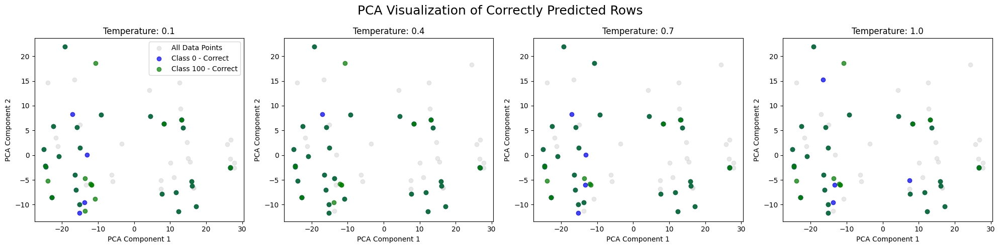

In [ ]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 4, figsize=(20, 5))  
fig.suptitle('PCA Visualization of Correctly Predicted Rows', size=18)

temperatures = [0.1, 0.4, 0.7, 1.0]

for i, temp in enumerate(temperatures):
    ax = axs[i]
    
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    
    if temp in correct_rows_class_0:
        ax.scatter(
            correct_rows_class_0[temp]['PCA1'], 
            correct_rows_class_0[temp]['PCA2'], 
            color='blue', label='Class 0 - Correct', alpha=0.7
        )
    
    if temp in correct_rows_class_100:
        ax.scatter(
            correct_rows_class_100[temp]['PCA1'], 
            correct_rows_class_100[temp]['PCA2'], 
            color='green', label='Class 100 - Correct', alpha=0.7
        )
    
    ax.set_title(f'Temperature: {temp}')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    
    if i == 0:
        ax.legend()

plt.tight_layout()
plt.show()


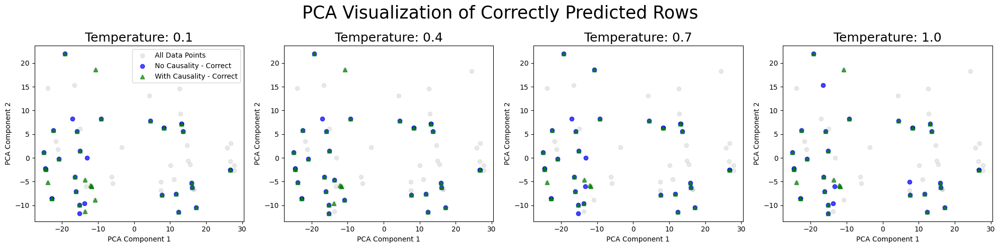

In [ ]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 4, figsize=(20, 5)) 
fig.suptitle('PCA Visualization of Correctly Predicted Rows', size=25)

temperatures = [0.1, 0.4, 0.7, 1.0]

for i, temp in enumerate(temperatures):
    ax = axs[i]
    
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    
    if temp in correct_rows_class_0:
        ax.scatter(
            correct_rows_class_0[temp]['PCA1'], 
            correct_rows_class_0[temp]['PCA2'], 
            color='blue', label='No Causality - Correct', alpha=0.7, marker='o'  
        )
    
    if temp in correct_rows_class_100:
        ax.scatter(
            correct_rows_class_100[temp]['PCA1'], 
            correct_rows_class_100[temp]['PCA2'], 
            color='green', label='With Causality - Correct', alpha=0.7, marker='^'  
        )
    
    ax.set_title(f'Temperature: {temp}', size = 18)
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    
    if i == 0:
        ax.legend()

plt.tight_layout()
plt.show()


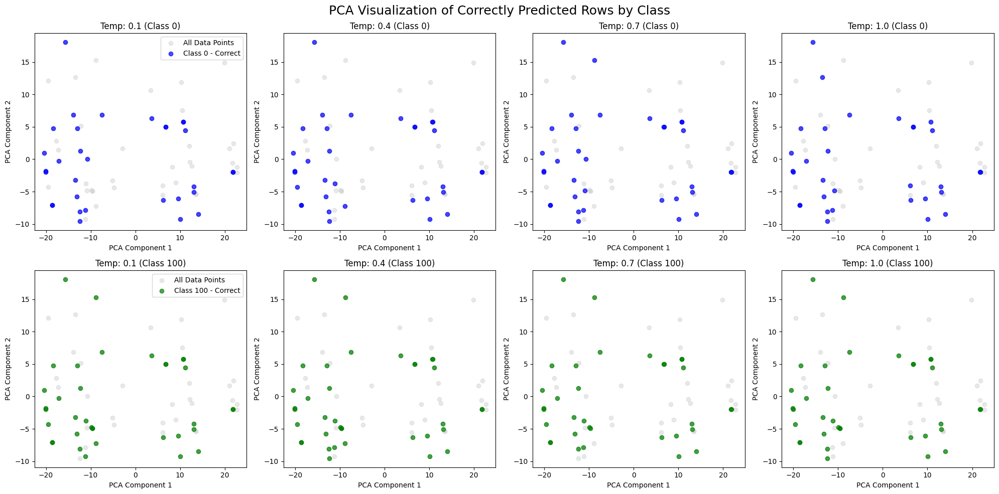

In [ ]:
import matplotlib.pyplot as plt


fig, axs = plt.subplots(2, 4, figsize=(20, 10))  
fig.suptitle('PCA Visualization of Correctly Predicted Rows by Class', size=18)

temperatures = [0.1, 0.4, 0.7, 1.0]

for i, temp in enumerate(temperatures):
    ax = axs[0, i]
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    if temp in correct_rows_class_0:
        ax.scatter(
            correct_rows_class_0[temp]['PCA1'], 
            correct_rows_class_0[temp]['PCA2'], 
            color='blue', label='Class 0 - Correct', alpha=0.7
        )
    ax.set_title(f'Temp: {temp} (Class 0)')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    if i == 0:
        ax.legend()

    ax = axs[1, i]
    ax.scatter(X_test_features['PCA1'], X_test_features['PCA2'], color='lightgray', label='All Data Points', alpha=0.5)
    if temp in correct_rows_class_100:
        ax.scatter(
            correct_rows_class_100[temp]['PCA1'], 
            correct_rows_class_100[temp]['PCA2'], 
            color='green', label='Class 100 - Correct', alpha=0.7
        )
    ax.set_title(f'Temp: {temp} (Class 100)')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    if i == 0:
        ax.legend()

plt.tight_layout()
plt.show()


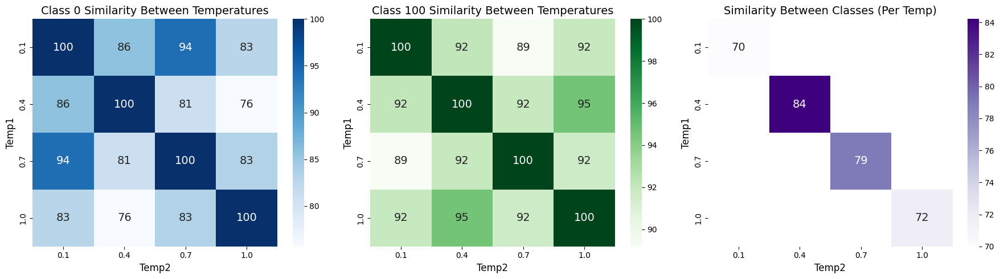

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

similarity_data = []

temperatures = [0.1, 0.4, 0.7, 1.0]

for temp1 in temperatures:
    for temp2 in temperatures:
        indices1_class_0 = set(correct_rows_class_0[temp1].index)
        indices2_class_0 = set(correct_rows_class_0[temp2].index)
        overlap_class_0 = len(indices1_class_0.intersection(indices2_class_0))
        union_class_0 = len(indices1_class_0.union(indices2_class_0))
        similarity_class_0 = (overlap_class_0 / union_class_0) * 100 if union_class_0 > 0 else 0

        indices1_class_100 = set(correct_rows_class_100[temp1].index)
        indices2_class_100 = set(correct_rows_class_100[temp2].index)
        overlap_class_100 = len(indices1_class_100.intersection(indices2_class_100))
        union_class_100 = len(indices1_class_100.union(indices2_class_100))
        similarity_class_100 = (overlap_class_100 / union_class_100) * 100 if union_class_100 > 0 else 0

        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'class_0',
            'Similarity (%)': similarity_class_0
        })
        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'class_100',
            'Similarity (%)': similarity_class_100
        })

for temp in temperatures:
    indices_class_0 = set(correct_rows_class_0[temp].index)
    indices_class_100 = set(correct_rows_class_100[temp].index)
    overlap_classes = len(indices_class_0.intersection(indices_class_100))
    union_classes = len(indices_class_0.union(indices_class_100))
    similarity_classes = (overlap_classes / union_classes) * 100 if union_classes > 0 else 0

    similarity_data.append({
        'Temp1': temp,
        'Temp2': temp,
        'Class': 'class_0_vs_class_100',
        'Similarity (%)': similarity_classes
    })

similarity_df = pd.DataFrame(similarity_data)

heatmap_data_class_0 = similarity_df[similarity_df['Class'] == 'class_0'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_class_100 = similarity_df[similarity_df['Class'] == 'class_100'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_classes = similarity_df[similarity_df['Class'] == 'class_0_vs_class_100'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')

fig, axs = plt.subplots(1, 3, figsize=(18, 5))

sns.heatmap(
    heatmap_data_class_0, 
    annot=True, 
    cmap="Blues", 
    ax=axs[0], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14} 
)
axs[0].set_title('Class 0 Similarity Between Temperatures', fontsize=14)
axs[0].set_xlabel('Temp2', fontsize=12)
axs[0].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_class_100, 
    annot=True, 
    cmap="Greens", 
    ax=axs[1], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[1].set_title('Class 100 Similarity Between Temperatures', fontsize=14)
axs[1].set_xlabel('Temp2', fontsize=12)
axs[1].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_classes, 
    annot=True, 
    cmap="Purples", 
    ax=axs[2], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14} 
)
axs[2].set_title('Similarity Between Classes (Per Temp)', fontsize=14)
axs[2].set_xlabel('Temp2', fontsize=12)
axs[2].set_ylabel('Temp1', fontsize=12)

plt.tight_layout()
plt.show()




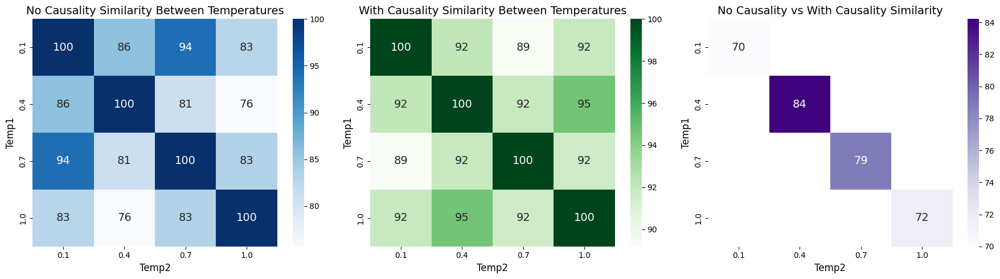

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

similarity_data = []

temperatures = [0.1, 0.4, 0.7, 1.0]

for temp1 in temperatures:
    for temp2 in temperatures:
        indices1_class_0 = set(correct_rows_class_0[temp1].index)
        indices2_class_0 = set(correct_rows_class_0[temp2].index)
        overlap_class_0 = len(indices1_class_0.intersection(indices2_class_0))
        union_class_0 = len(indices1_class_0.union(indices2_class_0))
        similarity_class_0 = (overlap_class_0 / union_class_0) * 100 if union_class_0 > 0 else 0

        indices1_class_100 = set(correct_rows_class_100[temp1].index)
        indices2_class_100 = set(correct_rows_class_100[temp2].index)
        overlap_class_100 = len(indices1_class_100.intersection(indices2_class_100))
        union_class_100 = len(indices1_class_100.union(indices2_class_100))
        similarity_class_100 = (overlap_class_100 / union_class_100) * 100 if union_class_100 > 0 else 0

        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'No Causality',
            'Similarity (%)': similarity_class_0
        })
        similarity_data.append({
            'Temp1': temp1,
            'Temp2': temp2,
            'Class': 'With Causality',
            'Similarity (%)': similarity_class_100
        })

for temp in temperatures:
    indices_class_0 = set(correct_rows_class_0[temp].index)
    indices_class_100 = set(correct_rows_class_100[temp].index)
    overlap_classes = len(indices_class_0.intersection(indices_class_100))
    union_classes = len(indices_class_0.union(indices_class_100))
    similarity_classes = (overlap_classes / union_classes) * 100 if union_classes > 0 else 0

    similarity_data.append({
        'Temp1': temp,
        'Temp2': temp,
        'Class': 'No Causality vs With Causality',
        'Similarity (%)': similarity_classes
    })

similarity_df = pd.DataFrame(similarity_data)

heatmap_data_class_0 = similarity_df[similarity_df['Class'] == 'No Causality'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_class_100 = similarity_df[similarity_df['Class'] == 'With Causality'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')
heatmap_data_classes = similarity_df[similarity_df['Class'] == 'No Causality vs With Causality'].pivot(index='Temp1', columns='Temp2', values='Similarity (%)')

fig, axs = plt.subplots(1, 3, figsize=(18, 5))

sns.heatmap(
    heatmap_data_class_0, 
    annot=True, 
    cmap="Blues", 
    ax=axs[0], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[0].set_title('No Causality Similarity Between Temperatures', fontsize=14)
axs[0].set_xlabel('Temp2', fontsize=12)
axs[0].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_class_100, 
    annot=True, 
    cmap="Greens", 
    ax=axs[1], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[1].set_title('With Causality Similarity Between Temperatures', fontsize=14)
axs[1].set_xlabel('Temp2', fontsize=12)
axs[1].set_ylabel('Temp1', fontsize=12)

sns.heatmap(
    heatmap_data_classes, 
    annot=True, 
    cmap="Purples", 
    ax=axs[2], 
    cbar=True, 
    fmt=".0f", 
    annot_kws={"size": 14}  
)
axs[2].set_title('No Causality vs With Causality Similarity', fontsize=14)
axs[2].set_xlabel('Temp2', fontsize=12)
axs[2].set_ylabel('Temp1', fontsize=12)

plt.tight_layout()
plt.show()


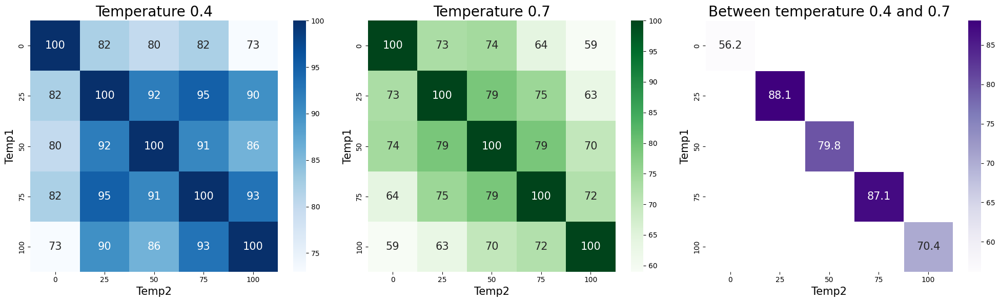

In [317]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

focus_data = {
    0: [56.2, 0, 0, 0, 0],
    25: [0, 88.1, 0, 0, 0],
    50: [0, 0, 79.8, 0, 0],
    75: [0, 0, 0, 87.1, 0],
    100: [0, 0, 0, 0, 70.4],
}

focus_df = pd.DataFrame(focus_data, index=[0, 25, 50, 75, 100])

data1 = np.array([[100, 82, 80, 82, 73], 
                  [82, 100, 92, 95, 90], 
                  [80, 92, 100, 91, 86], 
                  [82, 95, 91, 100, 93], 
                  [73, 90, 86, 93, 100]])

data2 = np.array([[100, 73, 74, 64, 59], 
                  [73, 100, 79, 75, 63], 
                  [74, 79, 100, 79, 70], 
                  [64, 75, 79, 100, 72], 
                  [59, 63, 70, 72, 100]])

fig, axs = plt.subplots(1, 3, figsize=(20, 6))  

sns.heatmap(data1, annot=True, cmap="Blues", ax=axs[0], cbar=True, fmt=".0f", annot_kws={"size": 15})
axs[0].set_title("Temperature 0.4", fontsize=20)
axs[0].set_xlabel("Temp2", fontsize=15)
axs[0].set_ylabel("Temp1", fontsize=15)
axs[0].set_xticklabels([0, 25, 50, 75, 100])  
axs[0].set_yticklabels([0, 25, 50, 75, 100])

sns.heatmap(data2, annot=True, cmap="Greens", ax=axs[1], cbar=True, fmt=".0f", annot_kws={"size": 15})
axs[1].set_title("Temperature 0.7", fontsize=20)
axs[1].set_xlabel("Temp2", fontsize=15)
axs[1].set_ylabel("Temp1", fontsize=15)
axs[1].set_xticklabels([0, 25, 50, 75, 100])  
axs[1].set_yticklabels([0, 25, 50, 75, 100])

mask = focus_df == 0  
sns.heatmap(
    focus_df, 
    annot=True, 
    cmap="Purples", 
    ax=axs[2], 
    cbar=True, 
    fmt=".1f", 
    annot_kws={"size": 15}, 
    mask=mask,  
    linewidths=0.5  
)
axs[2].set_title("Between temperature 0.4 and 0.7", fontsize=20)
axs[2].set_xlabel("Temp2", fontsize=15)
axs[2].set_ylabel("Temp1", fontsize=15)
axs[2].set_xticklabels([0, 25, 50, 75, 100])  
axs[2].set_yticklabels([0, 25, 50, 75, 100])

plt.tight_layout()
plt.show()


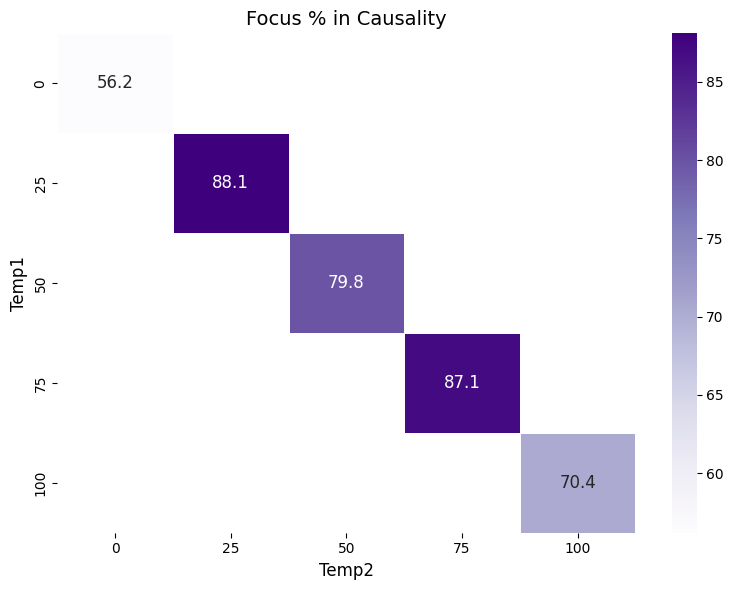

In [309]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

focus_data = {
    0: [56.2, 0, 0, 0, 0],
    25: [0, 88.1, 0, 0, 0],
    50: [0, 0, 79.8, 0, 0],
    75: [0, 0, 0, 87.1, 0],
    100: [0, 0, 0, 0, 70.4],
}

focus_df = pd.DataFrame(focus_data, index=[0, 25, 50, 75, 100])

mask = focus_df == 0  

plt.figure(figsize=(8, 6))

sns.heatmap(
    focus_df, 
    mask=mask, 
    cmap="Purples",  
    annot=True, 
    fmt=".1f",  
    cbar=True, 
    annot_kws={"size": 12},  
    linewidths=0.5, 
    linecolor="white"  
)

plt.title("Focus % in Causality", fontsize=14)
plt.xlabel("Temp2", fontsize=12)
plt.ylabel("Temp1", fontsize=12)

plt.tight_layout()
plt.show()
